# Import the libraries - Importo las librerías

In [ ]:
pip install skl2onnx onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.4/298.4 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 62.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 62.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 40.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 6.2 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.5
    Uninstalling protobuf-4.25.5:
      Successfully uninstalled protobuf-4.25.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.62.3 requires protobuf>=4.21.6, but you have protobuf 3.20.2 which is incompatible.
tensorflow 2.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
import torch
import torch.nn as nn
import torch.optim as optim

from sklearn.ensemble import ExtraTreesRegressor
from sklearn.datasets import make_regression
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import IsolationForest
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from scipy.stats import norm
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from yellowbrick.regressor import PredictionError
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import KFold, cross_validate
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor
from torch.utils.data import DataLoader, TensorDataset, Dataset
from torch.optim.lr_scheduler import StepLR
from torch.optim.lr_scheduler import ExponentialLR

from skl2onnx import convert_sklearn
from skl2onnx.common.data_types import FloatTensorType

# Data upload - Carga de datos

In [ ]:
dataset = pd.read_csv("house_dataset.csv")

In [ ]:
dataset.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0


# Normalize values - Normalizar valores

In [ ]:
scaler = MinMaxScaler()

dataset_normalize = scaler.fit_transform(dataset)
dataset = pd.DataFrame(dataset_normalize, columns=dataset.columns)

min_values = scaler.data_min_
max_values = scaler.data_max_

min_values_traditional = [f'{value:.6f}' for value in min_values]  # Con 6 decimales, ajusta según lo que necesites
max_values_traditional = [f'{value:.6f}' for value in max_values]  # Con 6 decimales, ajusta según lo que necesites

# Imprimir los valores convertidos
print("Mínimos (sin notación científica):", min_values_traditional)
print("Máximos (sin notación científica):", max_values_traditional)

Mínimos (sin notación científica): ['-124.350000', '32.540000', '1.000000', '2.000000', '1.000000', '3.000000', '1.000000', '0.499900', '14999.000000']
Máximos (sin notación científica): ['-114.310000', '41.950000', '52.000000', '37937.000000', '6445.000000', '35682.000000', '6082.000000', '15.000100', '500001.000000']


In [ ]:
dataset.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,1.000000,0.175345,0.274510,0.147885,0.198945,0.028364,0.077454,0.068530,0.107012
1,0.984064,0.197662,0.352941,0.201608,0.294848,0.031559,0.075974,0.091040,0.134228
2,0.975100,0.122210,0.313725,0.018927,0.026847,0.009249,0.019076,0.079378,0.145775
3,0.974104,0.116897,0.254902,0.039515,0.052142,0.014350,0.037000,0.185639,0.120414
4,0.974104,0.109458,0.372549,0.038276,0.050435,0.017405,0.042921,0.098281,0.104125


# Data correlation - Correlación de los datos

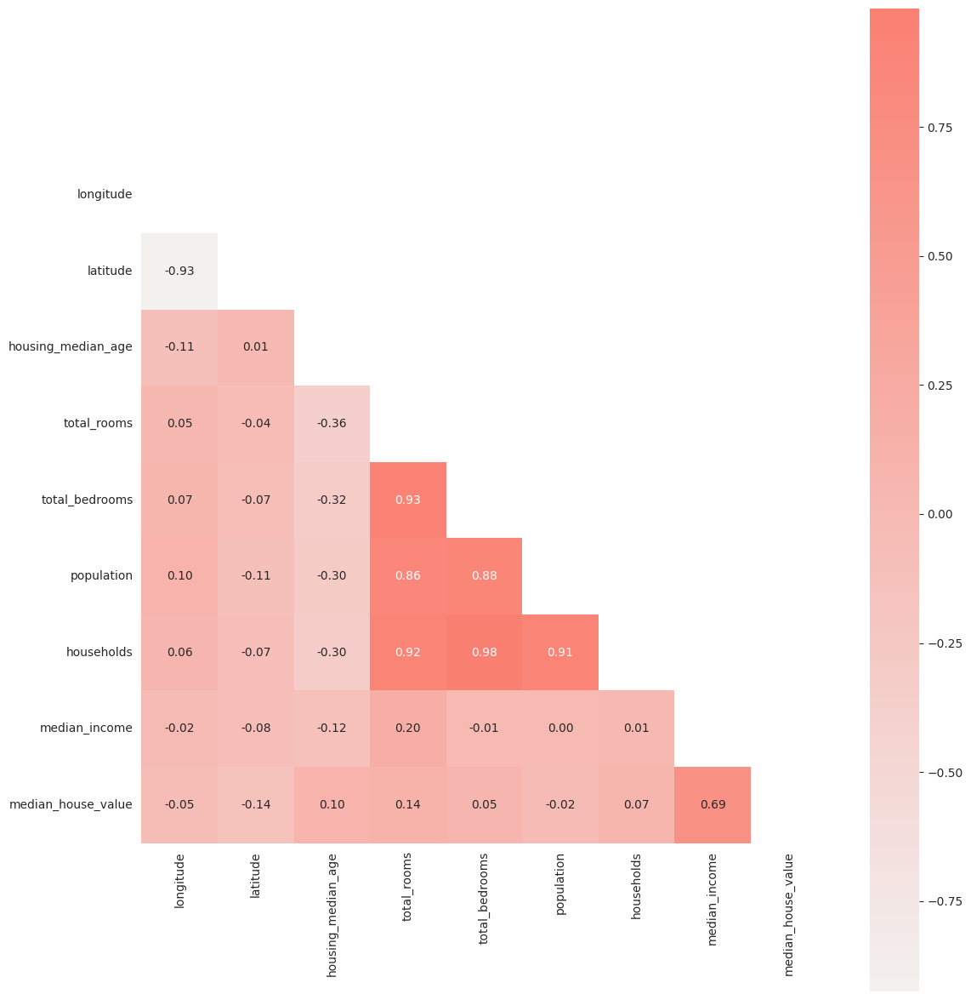

In [ ]:
correlacion = dataset.corr()

cores = sns.color_palette('light:salmon', as_cmap=True)
mask = np.zeros_like(correlacion)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(13, 15))
    ax = sns.heatmap(correlacion, cmap=cores, mask=mask, square=True, fmt='.2f', annot=True)

In [ ]:
corr_matrix = dataset.corr()
corr_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.925176,-0.106824,0.047466,0.071700,0.102994,0.058443,-0.015882,-0.045788
latitude,-0.925176,1.000000,0.010260,-0.038911,-0.069217,-0.112025,-0.073960,-0.079157,-0.143969
housing_median_age,-0.106824,0.010260,1.000000,-0.362034,-0.320873,-0.296285,-0.303109,-0.120161,0.104470
total_rooms,0.047466,-0.038911,-0.362034,1.000000,0.929778,0.856826,0.918234,0.199207,0.135298
total_bedrooms,0.071700,-0.069217,-0.320873,0.929778,1.000000,0.877377,0.979395,-0.007952,0.051111
population,0.102994,-0.112025,-0.296285,0.856826,0.877377,1.000000,0.907291,0.003884,-0.024234
households,0.058443,-0.073960,-0.303109,0.918234,0.979395,0.907291,1.000000,0.013535,0.066573
median_income,-0.015882,-0.079157,-0.120161,0.199207,-0.007952,0.003884,0.013535,1.000000,0.689109
median_house_value,-0.045788,-0.143969,0.104470,0.135298,0.051111,-0.024234,0.066573,0.689109,1.000000


In [ ]:
corr_matrix["median_house_value"].sort_values()

,median_house_value
latitude,-0.143969
longitude,-0.045788
population,-0.024234
total_bedrooms,0.051111
households,0.066573
housing_median_age,0.104470
total_rooms,0.135298
median_income,0.689109
median_house_value,1.000000


In [ ]:
# Since the population does not have a very significant relationship with house prices, I decide to remove it.
# Ya que la población no tiene una relación muy significativa con el precio de las casas, decido eliminarla.

dataset_wp = dataset.drop(["population"], axis=1)

# Data cleaning - Limpieza de datos

In [ ]:
print(dataset_wp.duplicated().sum())
print(dataset.duplicated().sum())

0
0


In [ ]:
dataset.reset_index(drop=True, inplace=True)
dataset_wp.reset_index(drop=True, inplace=True)

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20000 non-null  float64
 1   latitude            20000 non-null  float64
 2   housing_median_age  20000 non-null  float64
 3   total_rooms         20000 non-null  float64
 4   total_bedrooms      20000 non-null  float64
 5   population          20000 non-null  float64
 6   households          20000 non-null  float64
 7   median_income       20000 non-null  float64
 8   median_house_value  20000 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


In [ ]:
dataset_wp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20000 non-null  float64
 1   latitude            20000 non-null  float64
 2   housing_median_age  20000 non-null  float64
 3   total_rooms         20000 non-null  float64
 4   total_bedrooms      20000 non-null  float64
 5   households          20000 non-null  float64
 6   median_income       20000 non-null  float64
 7   median_house_value  20000 non-null  float64
dtypes: float64(8)
memory usage: 1.2 MB


# Outliers

In [ ]:
def delete_outliers(df, columnas):
    for columna in columnas:
        Q1 = df[columna].quantile(0.25)
        Q3 = df[columna].quantile(0.75)
        IQR = Q3 - Q1

        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        df = df[(df[columna] >= limite_inferior) & (df[columna] <= limite_superior)]

    return df

<Axes: >

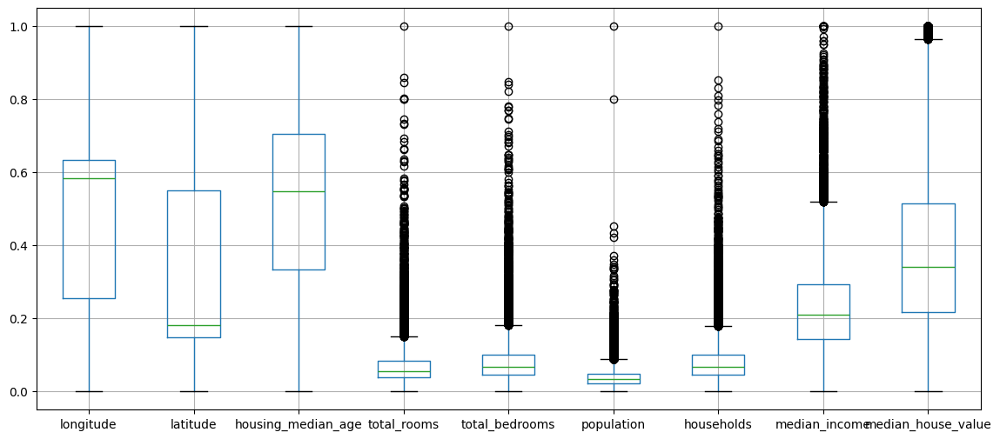

In [ ]:
plt.rc("figure", figsize = (14,6))

dataset.boxplot()

<Axes: >

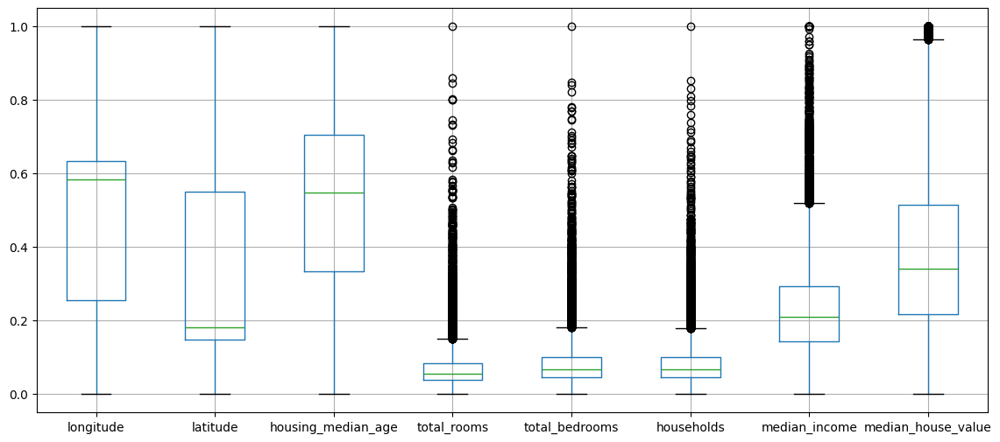

In [ ]:
dataset_wp.boxplot()

In [ ]:
# New Datasets without outliers.
# Nuevos datasets sin outliers.

dataset_outliers = delete_outliers(dataset, ["total_rooms", "total_bedrooms", "population", "households", "median_income", "median_house_value"])
dataset_outliers.reset_index(drop=True, inplace=True)

dataset_wp_outliers = delete_outliers(dataset_wp, ["total_rooms", "total_bedrooms", "households", "median_income", "median_house_value"])
dataset_wp_outliers.reset_index(drop=True, inplace=True)

<Axes: >

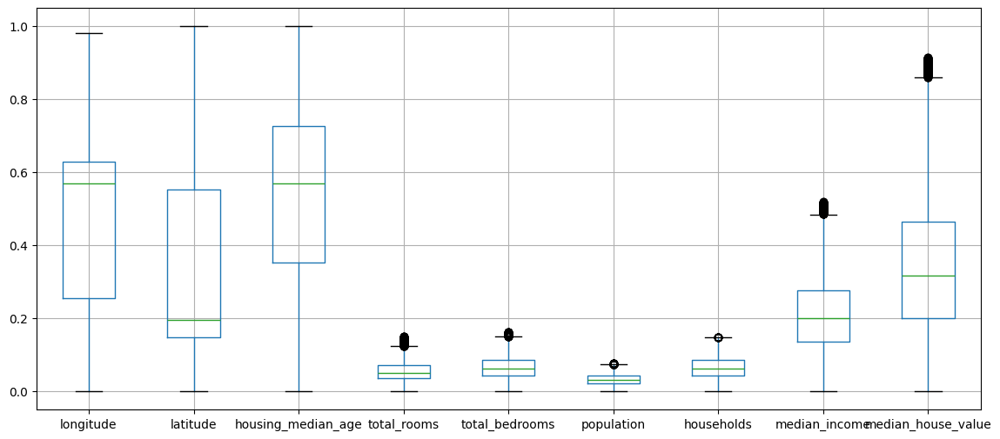

In [ ]:
dataset_outliers.boxplot()

<Axes: >

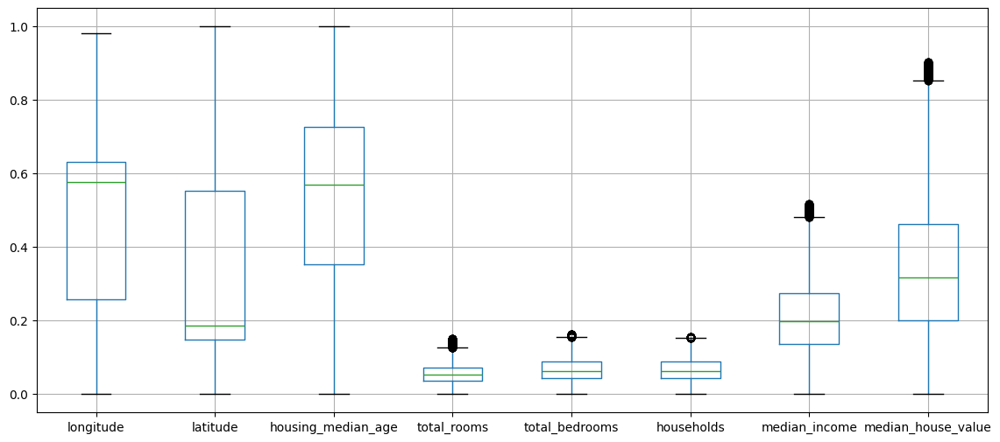

In [ ]:
dataset_wp_outliers.boxplot()

In [ ]:
dataset_wp_outliers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16779 entries, 0 to 16778
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           16779 non-null  float64
 1   latitude            16779 non-null  float64
 2   housing_median_age  16779 non-null  float64
 3   total_rooms         16779 non-null  float64
 4   total_bedrooms      16779 non-null  float64
 5   households          16779 non-null  float64
 6   median_income       16779 non-null  float64
 7   median_house_value  16779 non-null  float64
dtypes: float64(8)
memory usage: 1.0 MB


In [ ]:
# Isolation forest.

iso_forest = IsolationForest(max_samples = "auto", contamination = "auto")

def isolation_forest(df):

  iso_forest.fit(df)

  outlier_pred = iso_forest.predict(df)
  outlier_pred = [False if x == 1 else True for x in outlier_pred]

  non_outliers = [not x for x in outlier_pred]
  df_wo = df[non_outliers]

  return df_wo

dataset_isolation = isolation_forest(dataset)
dataset_wp_isolation = isolation_forest(dataset_wp)

dataset_isolation.reset_index(drop=True, inplace=True)
dataset_wp_isolation.reset_index(drop=True, inplace=True)

print(len(dataset_isolation))
print(len(dataset_wp_isolation))

17076
16642


In [ ]:
dataset_wp_isolation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16642 entries, 0 to 16641
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           16642 non-null  float64
 1   latitude            16642 non-null  float64
 2   housing_median_age  16642 non-null  float64
 3   total_rooms         16642 non-null  float64
 4   total_bedrooms      16642 non-null  float64
 5   households          16642 non-null  float64
 6   median_income       16642 non-null  float64
 7   median_house_value  16642 non-null  float64
dtypes: float64(8)
memory usage: 1.0 MB


<Axes: >

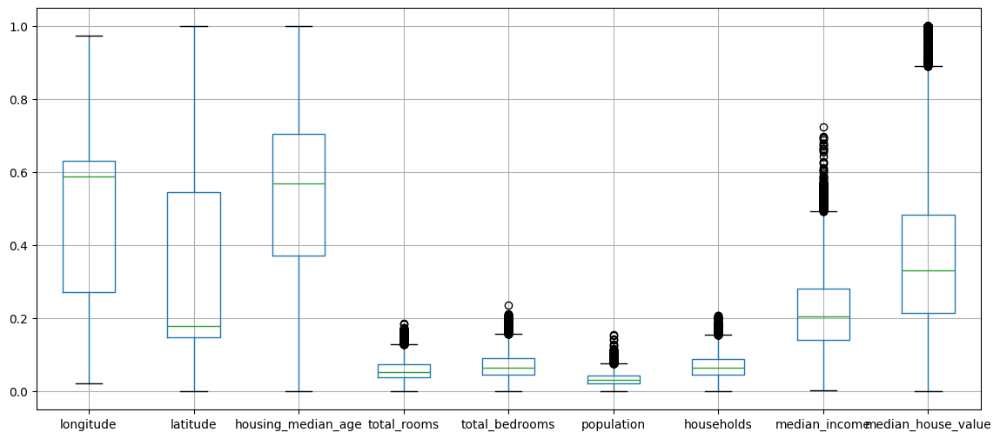

In [ ]:
dataset_isolation.boxplot()

# Data visualization - Visualización de datos

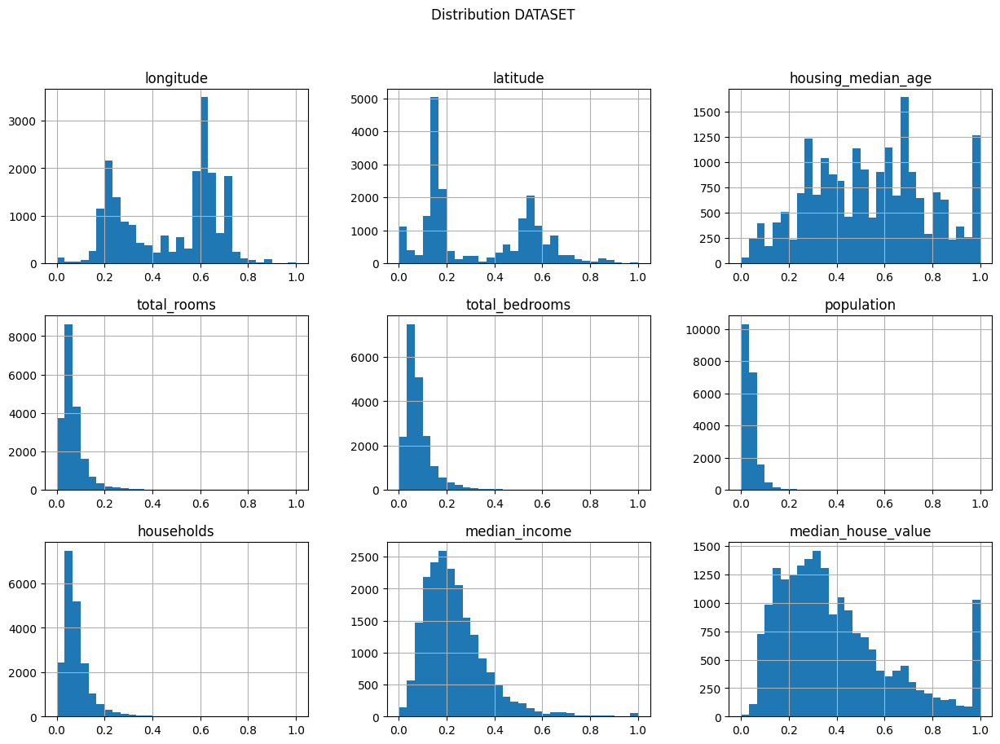

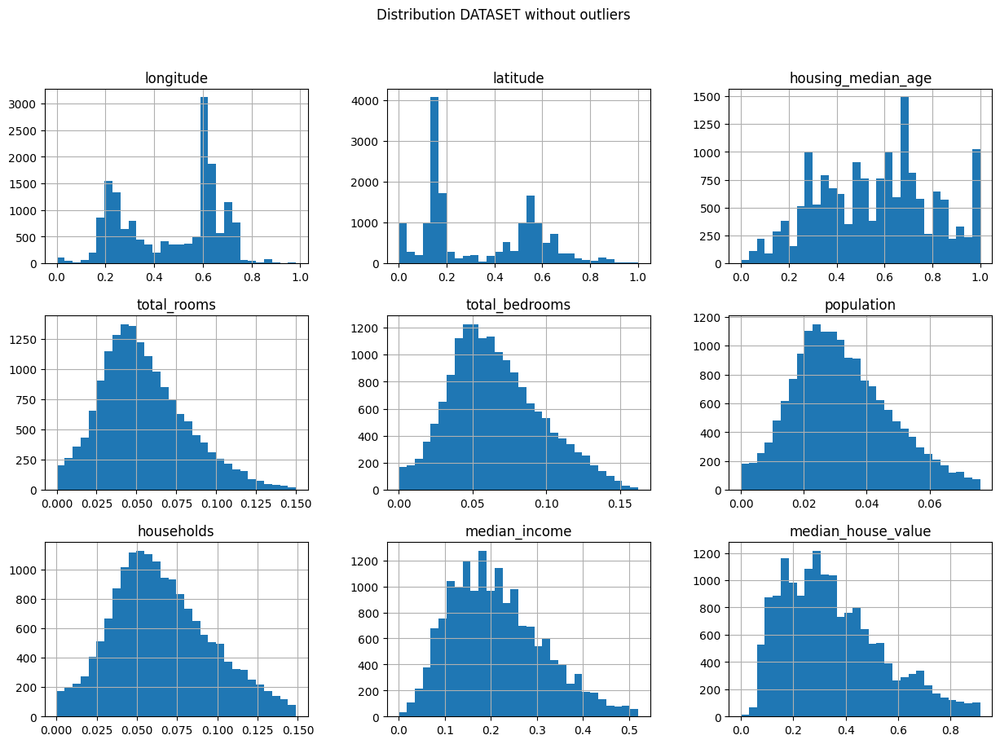

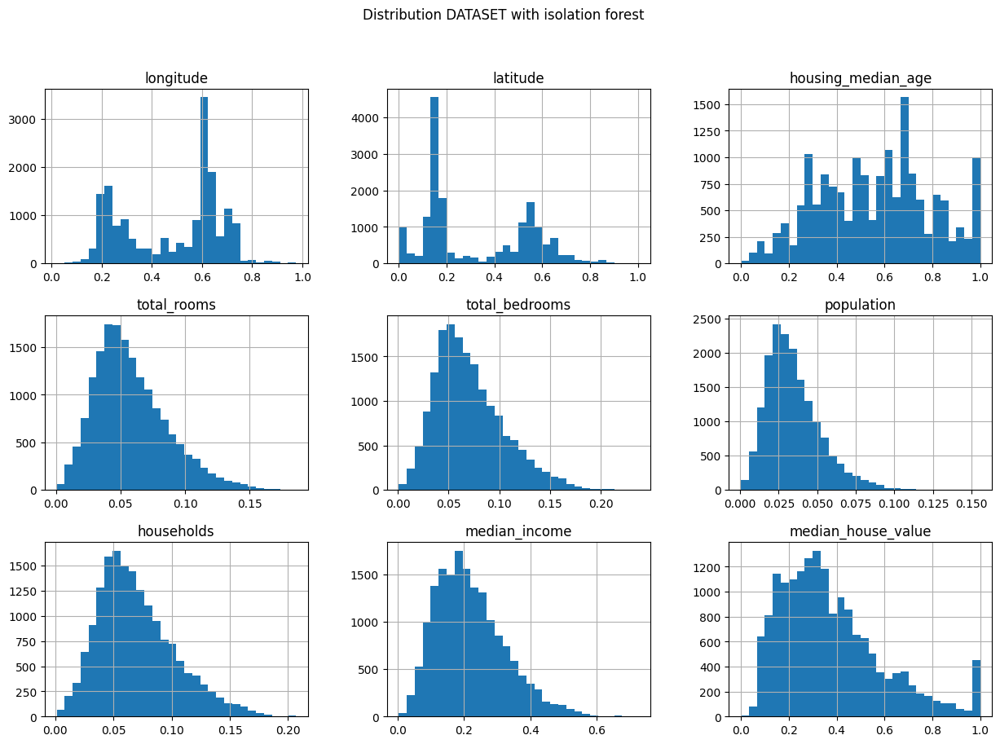

In [ ]:
dataset.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET")
plt.show()

dataset_outliers.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET without outliers")
plt.show()

dataset_isolation.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET with isolation forest")
plt.show()

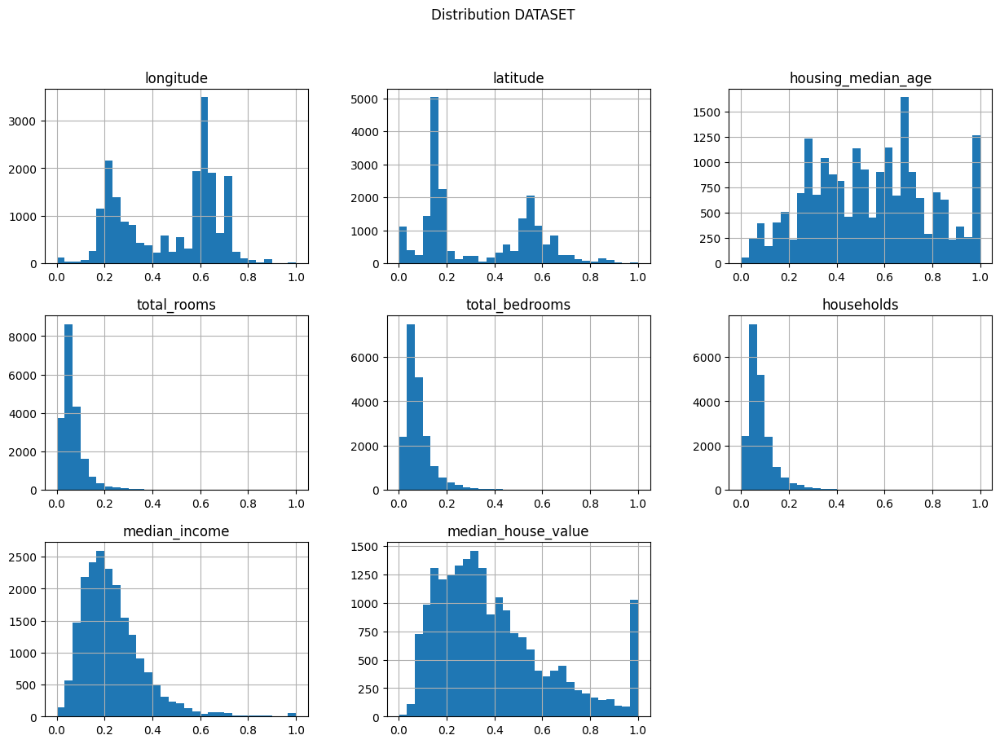

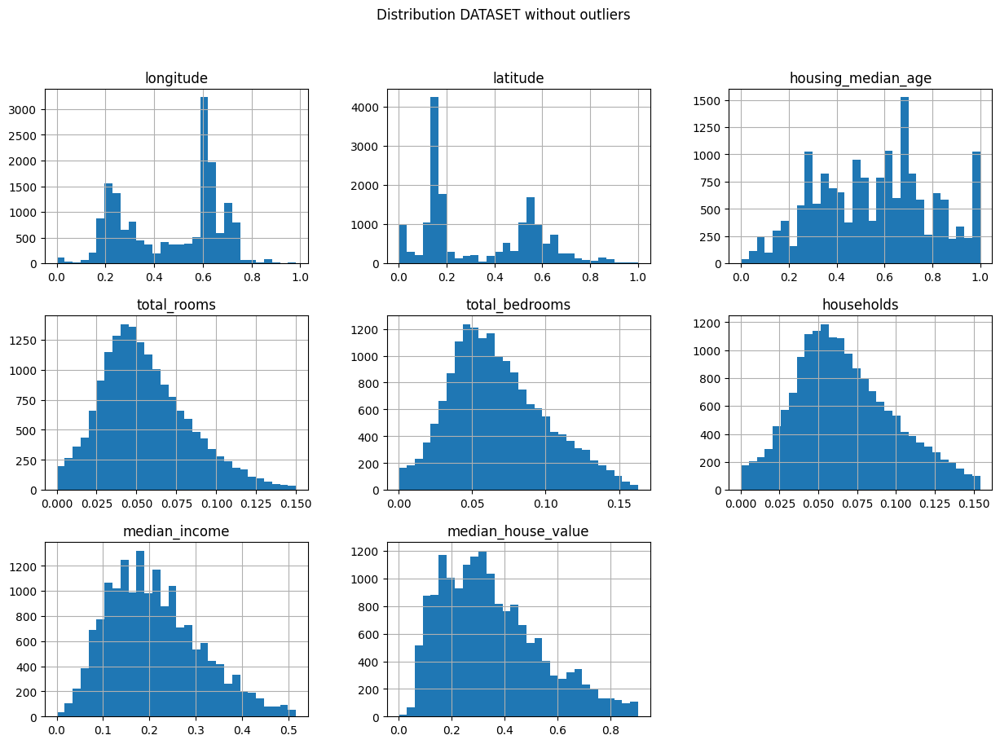

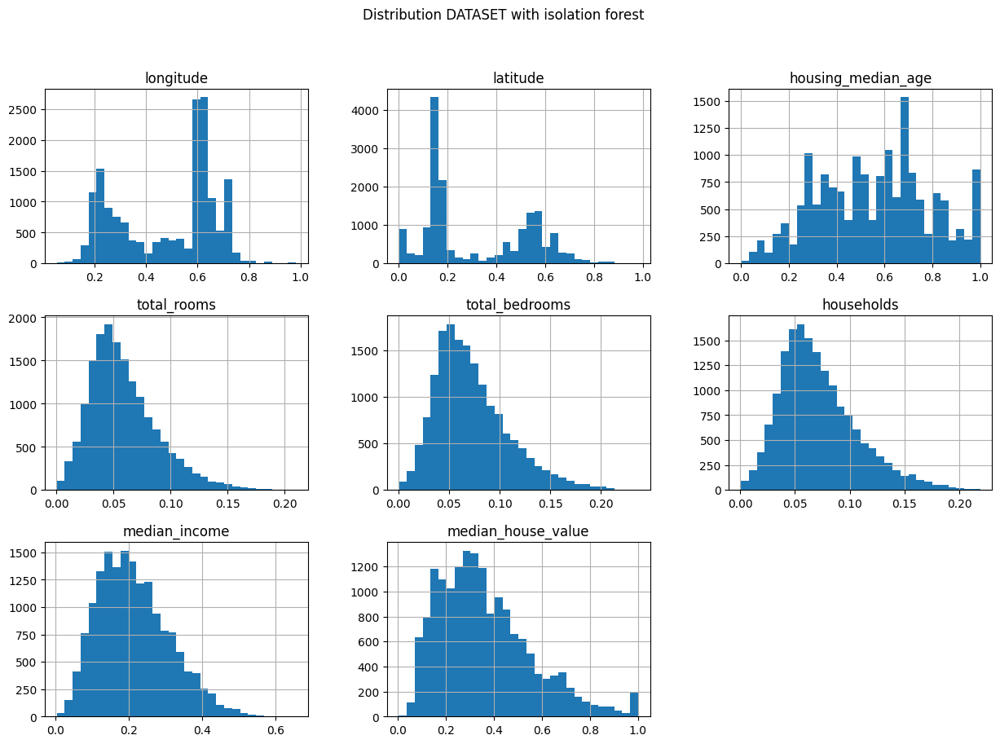

In [ ]:
dataset_wp.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET")
plt.show()

dataset_wp_outliers.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET without outliers")
plt.show()

dataset_wp_isolation.hist(bins=30, figsize=(15, 10))
plt.suptitle("Distribution DATASET with isolation forest")
plt.show()

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20000 non-null  float64
 1   latitude            20000 non-null  float64
 2   housing_median_age  20000 non-null  float64
 3   total_rooms         20000 non-null  float64
 4   total_bedrooms      20000 non-null  float64
 5   population          20000 non-null  float64
 6   households          20000 non-null  float64
 7   median_income       20000 non-null  float64
 8   median_house_value  20000 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


# Linear relationship - Relación lineal

In [ ]:
X = dataset.drop(["median_house_value"], axis=1)
X_wp = dataset_wp.drop(["median_house_value"], axis=1)

dataset_log = np.log1p(dataset[X.columns])
dataset_log["median_house_value"] = dataset["median_house_value"]

dataset_wp_log = np.log1p(dataset_wp[X_wp.columns])
dataset_wp_log["median_house_value"] = dataset["median_house_value"]

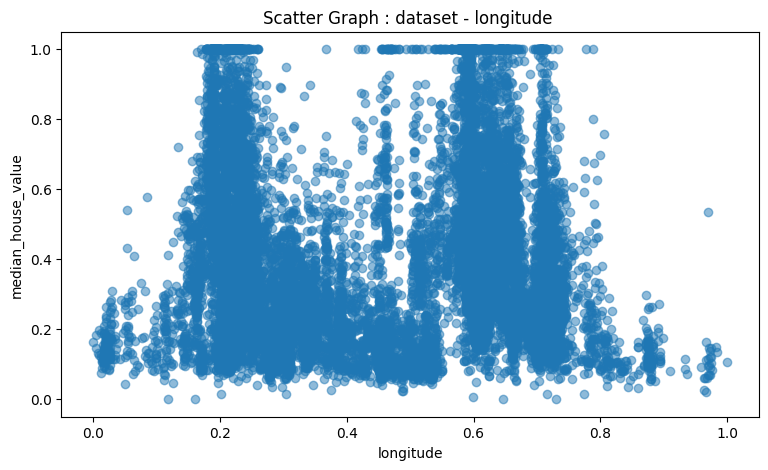

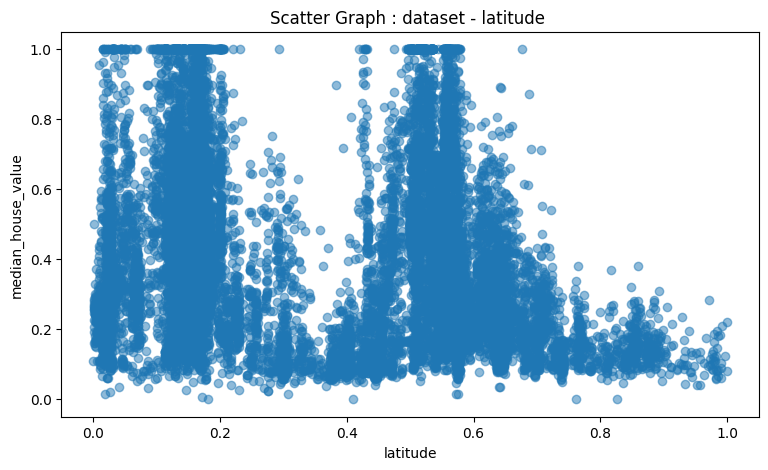

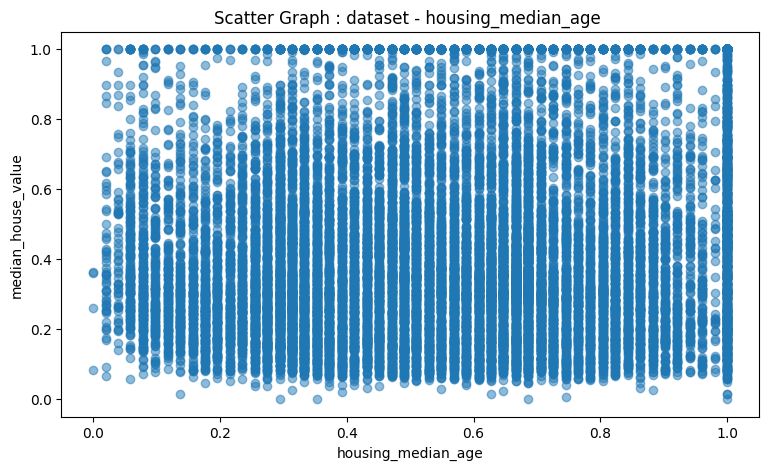

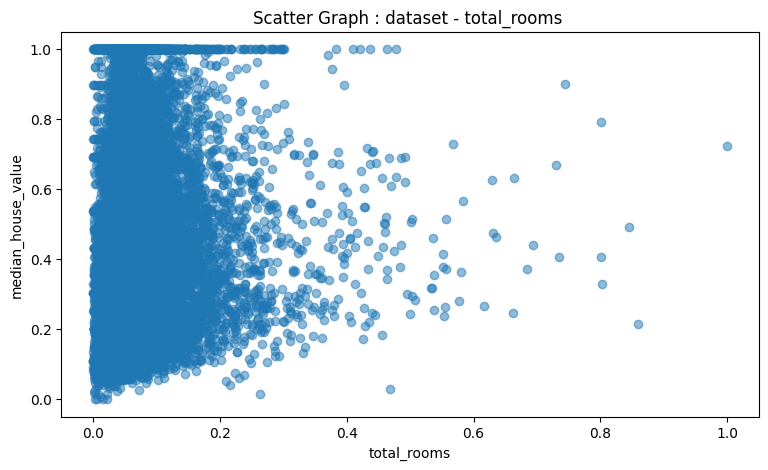

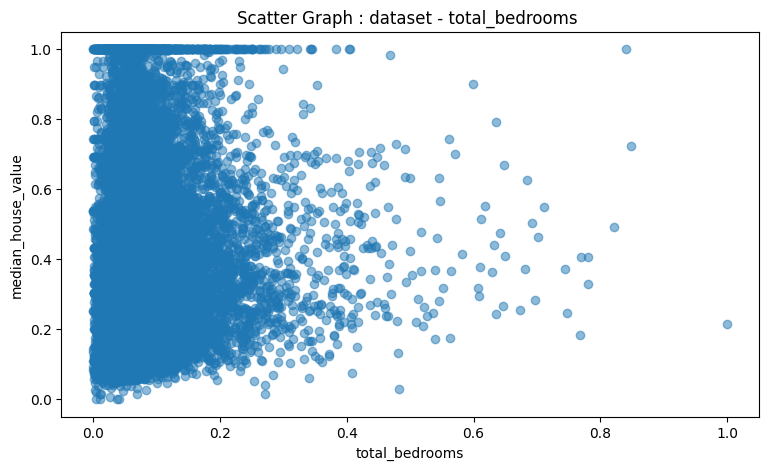

...

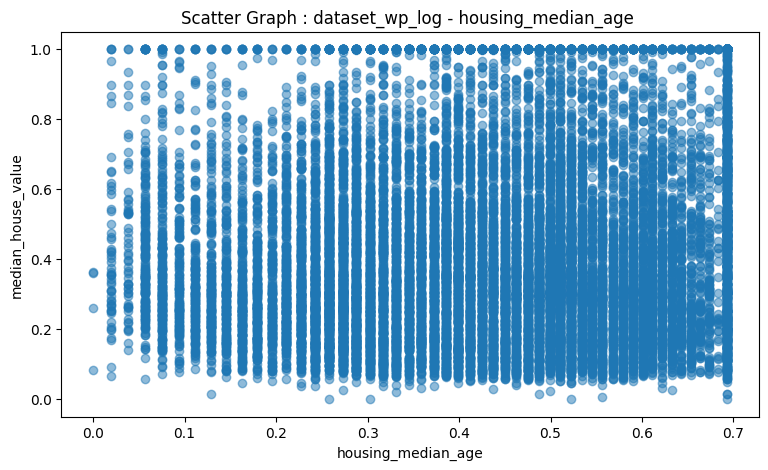

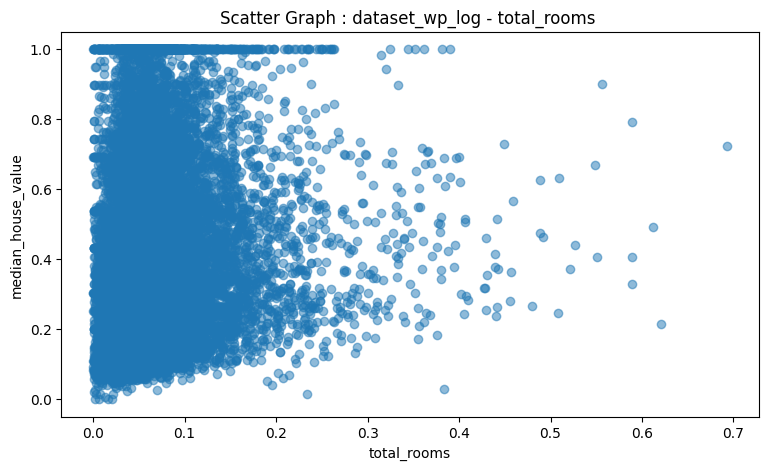

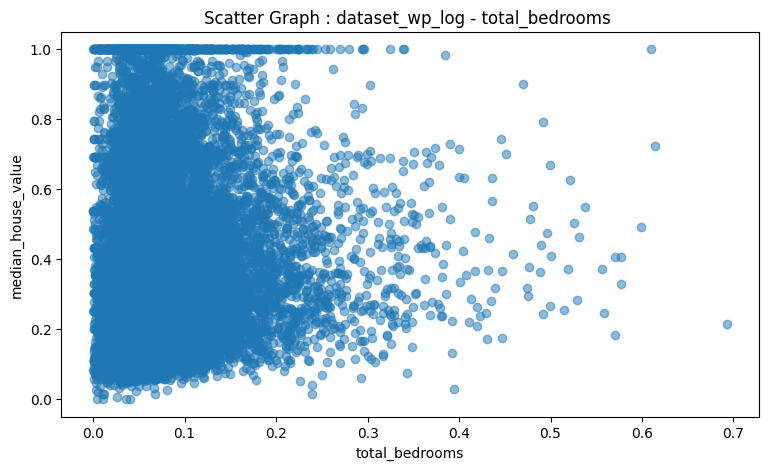

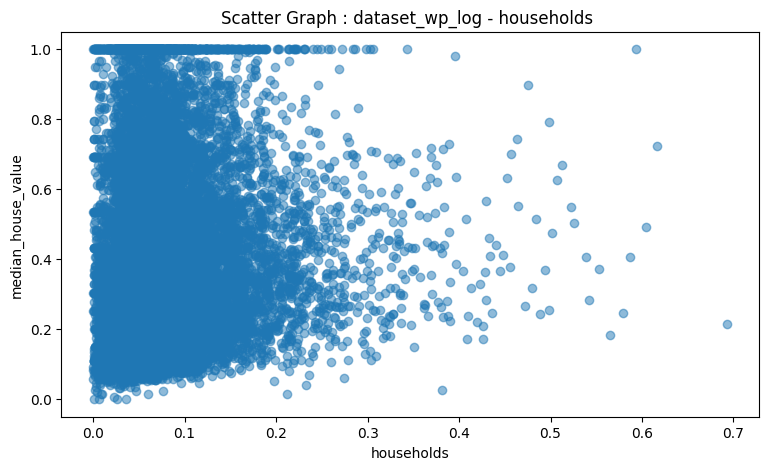

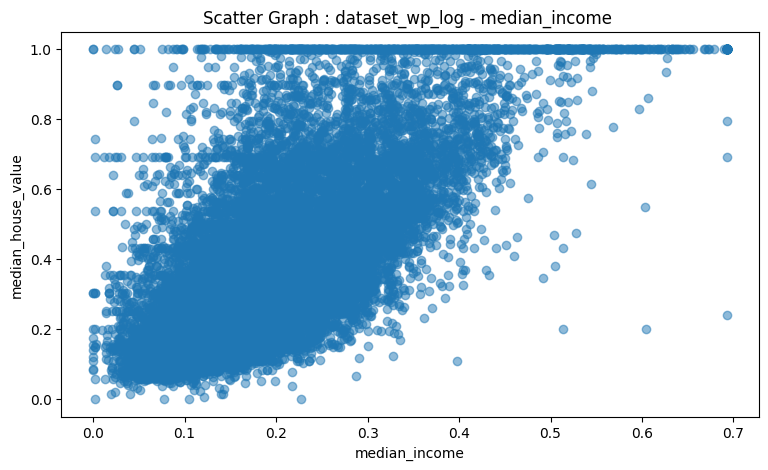

In [ ]:
def showLinealRelationship(df,name, target="median_house_value"):

    for column in df.columns:
        if column != target:
            plt.figure(figsize=(9, 5))
            plt.scatter(df[column], df[target], alpha=0.5)
            plt.title(f"Scatter Graph : {name} - {column} ")
            plt.xlabel(column)
            plt.ylabel(target)
            plt.show()


showLinealRelationship(dataset, name = "dataset")
showLinealRelationship(dataset_wp, name = "dataset_wp")

showLinealRelationship(dataset_wp_isolation, name = "dataset_wp_isolation")
showLinealRelationship(dataset_isolation, name = "dataset_isolation")

showLinealRelationship(dataset_wp_outliers, name = "dataset_wp_isolation")
showLinealRelationship(dataset_outliers, name = "dataset_outliers")

showLinealRelationship(dataset_log, name = "dataset_log")
showLinealRelationship(dataset_wp_log, name = "dataset_wp_log")



In [ ]:
def showLinealValues(df,name, target="median_house_value"):
    plt.figure(figsize=(12, 8))

    print("----------------------------------------------------")
    for column in df.columns:
        if column != target:
            correlation = np.corrcoef(dataset[column], dataset[target])[0, 1]
            print(f"{name} and {column} : {correlation}")

showLinealValues(dataset, name = "dataset")
showLinealValues(dataset_wp, name = "dataset_wp")

showLinealValues(dataset_wp_isolation, name = "dataset_wp_isolation")
showLinealValues(dataset_isolation, name = "dataset_isolation")

showLinealValues(dataset_wp_outliers, name = "dataset_wp_outliers")
showLinealValues(dataset_outliers, name = "dataset_outliers")

showLinealValues(dataset_log, name = "dataset_log")
showLinealValues(dataset_wp_log, name = "dataset_wp_log")


----------------------------------------------------
dataset and longitude : -0.04578816083789532
dataset and latitude : -0.14396892643866965
dataset and housing_median_age : 0.10446950594785628
dataset and total_rooms : 0.13529752507713722
dataset and total_bedrooms : 0.051110916518697105
dataset and population : -0.024234167294132983
dataset and households : 0.06657258076646808
dataset and median_income : 0.6891094729577245
----------------------------------------------------
dataset_wp and longitude : -0.04578816083789532
dataset_wp and latitude : -0.14396892643866965
dataset_wp and housing_median_age : 0.10446950594785628
dataset_wp and total_rooms : 0.13529752507713722
dataset_wp and total_bedrooms : 0.051110916518697105
dataset_wp and households : 0.06657258076646808
dataset_wp and median_income : 0.6891094729577245
----------------------------------------------------
dataset_wp_isolation and longitude : -0.04578816083789532
dataset_wp_isolation and latitude : -0.1439689264386696

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

In [ ]:
def linear_fit_and_residuals(df, name, target="median_house_value"):
    X_columns = [col for col in df.columns if col != target]  # Exclude the target

    for column in X_columns:
        X = df[[column]]  # Convert to 2D matrix for sklearn
        y = df[target]

        # Fit the linear model
        model = LinearRegression()
        model.fit(X, y)

        # Predictions
        y_pred = model.predict(X)
        residuals = y - y_pred

        # Fit chart
        plt.figure(figsize=(6, 3))
        plt.subplot(1, 2, 1)
        plt.scatter(X, y, alpha=0.5, label="Datos")
        plt.plot(X, y_pred, color="red", label="Línea Ajustada")
        plt.title(f"Línea Recta {name} : {column}")
        plt.xlabel(column)
        plt.ylabel(target)
        plt.legend()

        # Residual plot
        plt.subplot(1, 2, 2)
        plt.scatter(X, residuals, alpha=0.5)
        plt.axhline(y=0, color="red", linestyle="--")
        plt.title(f"Residuos {name} : {column}")
        plt.xlabel(column)
        plt.ylabel("Residuos")

        plt.tight_layout()
        plt.show()

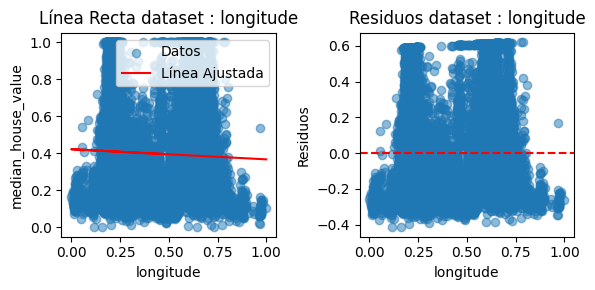

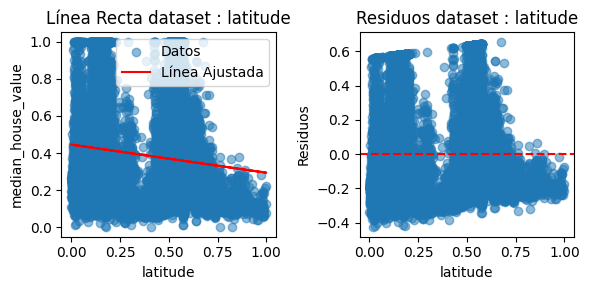

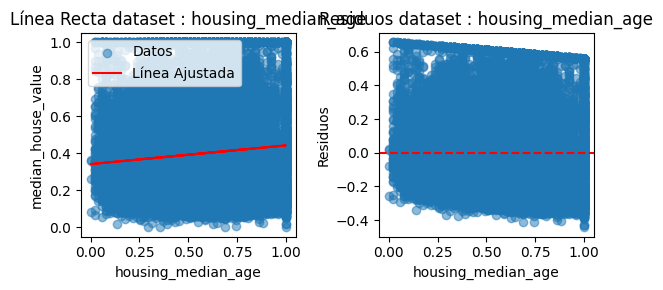

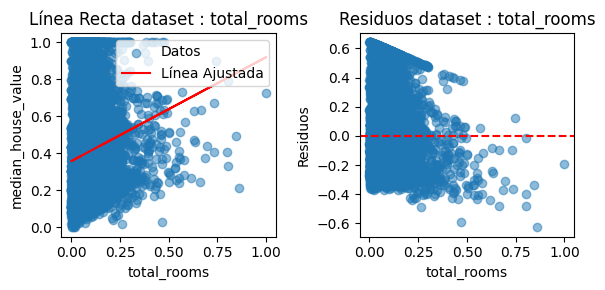

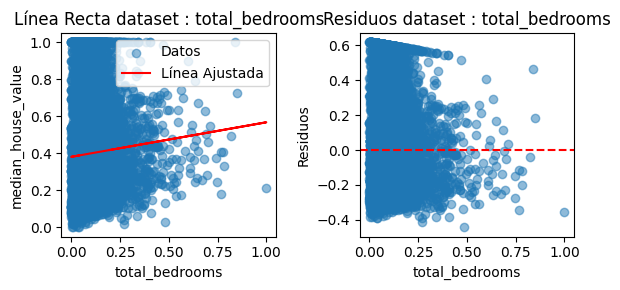

...

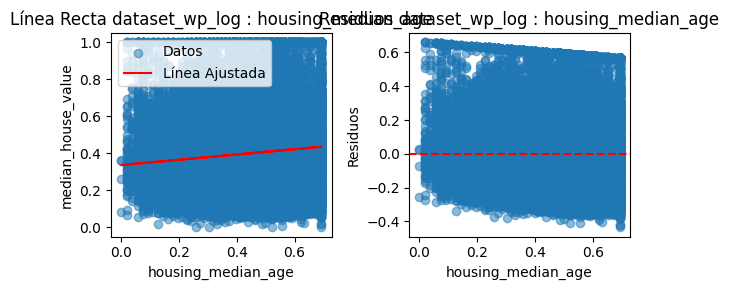

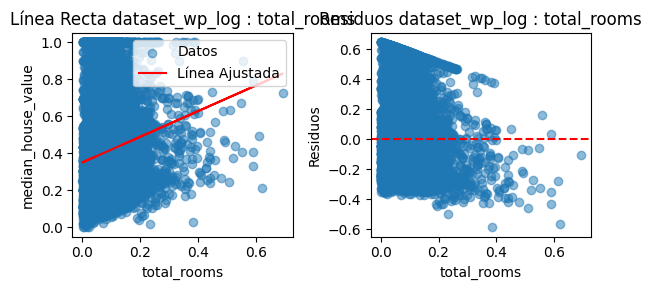

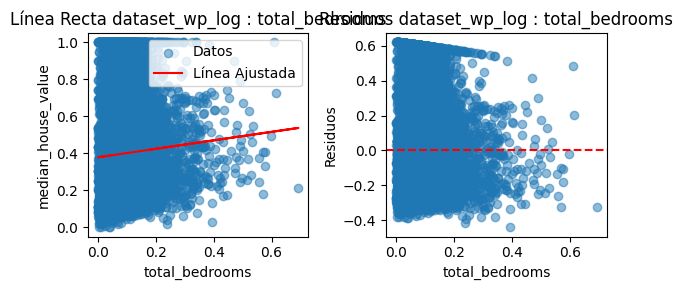

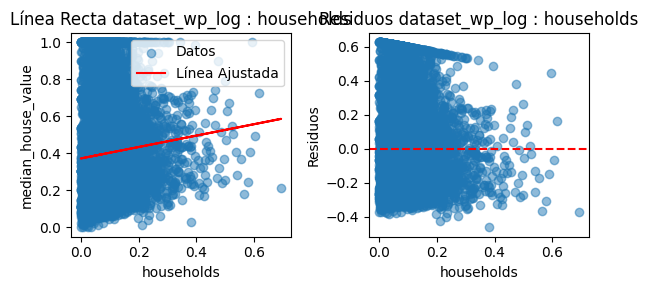

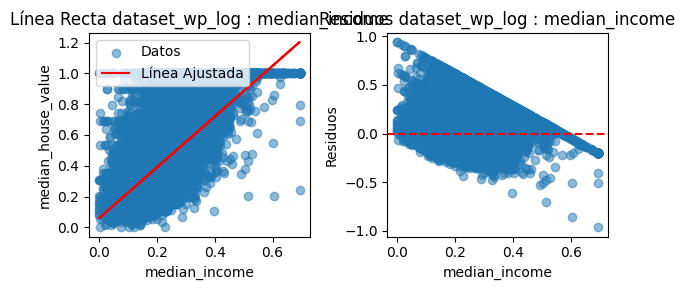

In [ ]:
linear_fit_and_residuals(dataset, name = "dataset")
linear_fit_and_residuals(dataset_wp, name = "dataset_wp")

linear_fit_and_residuals(dataset_wp_isolation, name = "dataset_wp_isolation")
linear_fit_and_residuals(dataset_isolation, name = "dataset_isolation")

linear_fit_and_residuals(dataset_wp_outliers, name = "dataset_wp_outliers")
linear_fit_and_residuals(dataset_outliers, name = "dataset_outliers")

linear_fit_and_residuals(dataset_log, name = "dataset_log")
linear_fit_and_residuals(dataset_wp_log, name = "dataset_wp_log")

# Eliminated unnecessary features - Eliminado de características innecesarias

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20000 non-null  float64
 1   latitude            20000 non-null  float64
 2   housing_median_age  20000 non-null  float64
 3   total_rooms         20000 non-null  float64
 4   total_bedrooms      20000 non-null  float64
 5   population          20000 non-null  float64
 6   households          20000 non-null  float64
 7   median_income       20000 non-null  float64
 8   median_house_value  20000 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


In [ ]:
columns = ["longitude","total_bedrooms", "population", "households"]
columns_wp = ["longitude","total_bedrooms", "households"]

dataset_l = dataset.drop(columns, axis=1)
dataset_wp_l = dataset_wp.drop(columns_wp, axis=1)

dataset_outliers_l = dataset_outliers.drop(columns, axis=1)
dataset_wp_outliers_l = dataset_wp_outliers.drop(columns_wp, axis=1)

dataset_isolation_l = dataset_isolation.drop(columns, axis=1)
dataset_wp_isolation_l = dataset_wp_isolation.drop(columns_wp, axis=1)

dataset_log_l = dataset_log.drop(columns, axis=1)
dataset_wp_log_l = dataset_wp_log.drop(columns_wp, axis=1)


In [ ]:
dataset_log_l.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   latitude            20000 non-null  float64
 1   housing_median_age  20000 non-null  float64
 2   total_rooms         20000 non-null  float64
 3   median_income       20000 non-null  float64
 4   median_house_value  20000 non-null  float64
dtypes: float64(5)
memory usage: 781.4 KB


# Sampling - Muestreo

In [ ]:
# Finite population

z = 1.96 # 95% confidence
e = 0.05
s = 0.5 # Standard deviation
N = len(dataset["latitude"])


n = round(((z ** 2) * (s ** 2) * (N)) / ((z ** 2) * (s ** 2) + (e ** 2) * (N - 1)))

dataset_sample = dataset.sample(n=n, random_state=42)

In [ ]:
dataset_sample.mean(), dataset.mean()

(longitude             0.465633
 latitude              0.343142
 housing_median_age    0.533469
 total_rooms           0.067289
 total_bedrooms        0.082821
 population            0.039185
 households            0.080573
 median_income         0.223968
 median_house_value    0.380864
 dtype: float64,
 longitude             0.476477
 latitude              0.328029
 housing_median_age    0.541721
 total_rooms           0.069462
 total_bedrooms        0.083332
 population            0.039871
 households            0.081981
 median_income         0.232565
 median_house_value    0.396047
 dtype: float64)

In [ ]:
# Central limit theorem

# Teorema del límite central

samples = []

def getSamples(n, df):
    global samples
    N = round(len(df) / n)
    for j in range(N):
        sample = df.sample(n=n)
        samples.append(sample)


getSamples(n, dataset)

all_samples = pd.concat(samples)

all_samples.mean(), dataset.mean()

(longitude             0.474530
 latitude              0.329491
 housing_median_age    0.545076
 total_rooms           0.068548
 total_bedrooms        0.082252
 population            0.039404
 households            0.080942
 median_income         0.231737
 median_house_value    0.396234
 dtype: float64,
 longitude             0.476477
 latitude              0.328029
 housing_median_age    0.541721
 total_rooms           0.069462
 total_bedrooms        0.083332
 population            0.039871
 households            0.081981
 median_income         0.232565
 median_house_value    0.396047
 dtype: float64)

# Hipotesis de muestra

In [ ]:
def hypothesis_medians_big(n, alpha, direction, u_real, u_theoretical, e):
    # confidence level
    trust = 1 - alpha

    # Determine the critical values according to the direction of the test
    if direction == "center":
        trust_left = alpha / 2
        trust_right = 1 - (alpha / 2)
        critical_values = [norm.ppf(trust_left), norm.ppf(trust_right)]
    elif direction == "left":
        critical_values = [norm.ppf(alpha)]
    elif direction == "right":
        critical_values = [norm.ppf(trust)]
    else:
        raise ValueError("Direction must be 'center', 'left', or 'right'.")

    # Calculate the test statistic (tp)
    se = e / np.sqrt(n)  # Standard error
    zp = (u_real - u_theoretical) / se

    return zp, critical_values

In [ ]:
dataset_sample["median_house_value"].mean()

0.38086414082112074

In [ ]:
# I am testing if the mean of my sample is greater than 0.5

# Estoy probando si la media de mis muestra es mayor a 0.5

# h0 = u.median_house_value > 0.5
# h1 = u.median_house_value <= 0.5

alpha = 0.05 # 95% confidence

n = n
u = dataset_sample["median_house_value"].mean()
u_theoretical = 0.38
e = dataset_sample["median_house_value"].std()

# If z (the first value) falls within the critical values, the null hypothesis is accepted. Otherwise, it is rejected.
# Si z (el primer valor) cae sobre los valores críticos, se acepta la hipótesis nula. En caso contrario, se rechaza.

# In this case, if z is less than the critical value, the null hypothesis is rejected; otherwise, it is accepted.
# En este caso, si z es menor al valor crítico se rechaza la hipótesis nula, en caso contrario, se acepta.
hypothesis_medians_big(n,alpha,"left",u,u_theoretical,e)

(0.07389571485274474, [-1.6448536269514729])

# Most representative data - Datos más representativos

In [ ]:
X = dataset.drop(["median_house_value"], axis=1)
X_outliers = dataset_outliers.drop(["median_house_value"], axis=1)

k = 100
kmeans = KMeans(n_clusters=k, random_state=42)

X_digits_dist = kmeans.fit_transform(X)
X_digits_outliers_dist = kmeans.fit_transform(X_outliers)

In [ ]:
idxs = np.argmin(X_digits_dist, axis=0)
dataset_representative = dataset.iloc[idxs]
dataset_representative.reset_index(drop=True, inplace=True)

idxs_outliers = np.argmin(X_digits_outliers_dist, axis=0)
dataset_outliers_representative = dataset_outliers.iloc[idxs_outliers]
dataset_outliers_representative.reset_index(drop=True, inplace=True)

In [ ]:
dataset_representative.info(), dataset_outliers_representative.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           100 non-null    float64
 1   latitude            100 non-null    float64
 2   housing_median_age  100 non-null    float64
 3   total_rooms         100 non-null    float64
 4   total_bedrooms      100 non-null    float64
 5   population          100 non-null    float64
 6   households          100 non-null    float64
 7   median_income       100 non-null    float64
 8   median_house_value  100 non-null    float64
dtypes: float64(9)
memory usage: 7.2 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           100 non-null    float64
 1   latitude            100 non-null    float64
 2   housing_median

(None, None)

# Increase data - Aumentar datos

In [ ]:
gm_outliers = GaussianMixture(n_components=3, n_init=10, random_state=42)
gm_outliers.fit(dataset_outliers)

gm_isolation = GaussianMixture(n_components=3, n_init=10, random_state=42)
gm_isolation.fit(dataset_isolation)

gm_outliers_l = GaussianMixture(n_components=3, n_init=10, random_state=42)
gm_outliers_l.fit(dataset_outliers_l)

gm_isolation_l = GaussianMixture(n_components=3, n_init=10, random_state=42)
gm_isolation_l.fit(dataset_isolation_l)

GaussianMixture(n_components=3, n_init=10, random_state=42)

In [ ]:
n_samples = 30000

generated_samples_outliers, _ = gm_outliers.sample(n_samples)
generated_samples_isolation, _ = gm_isolation.sample(n_samples)
generated_samples_outliers_l, _ = gm_outliers_l.sample(n_samples)
generated_samples_isolation_l, _ = gm_isolation_l.sample(n_samples)

In [ ]:
generated_samples_outliers_df = pd.DataFrame(generated_samples_outliers, columns=dataset_outliers.columns)
dataset_outliers_generated = pd.concat([dataset_outliers, generated_samples_outliers_df], ignore_index=True)

generated_samples_isolation_df = pd.DataFrame(generated_samples_isolation, columns=dataset_isolation.columns)
dataset_isolation_generated = pd.concat([dataset_isolation, generated_samples_isolation_df], ignore_index=True)

generated_samples_outliers_l_df = pd.DataFrame(generated_samples_outliers_l, columns=dataset_outliers_l.columns)
dataset_outliers_l_generated = pd.concat([dataset_outliers_l, generated_samples_outliers_l_df], ignore_index=True)

generated_samples_isolation_l_df = pd.DataFrame(generated_samples_isolation_l, columns=dataset_isolation_l.columns)
dataset_isolation_l_generated = pd.concat([dataset_isolation_l, generated_samples_isolation_l_df], ignore_index=True)

# Dimensionality reduction - Reducción de la dimensionalidad

In [ ]:
X_l = dataset_l.drop(["median_house_value"], axis=1)
X_outliers_l = dataset_outliers_l.drop(["median_house_value"], axis=1)
X_isolation_l = dataset_isolation_l.drop(["median_house_value"], axis=1)

In [ ]:
pca_dataset_l = PCA(n_components = 0.95)
pca_dataset_outliers_l = PCA(n_components = 0.95)
pca_dataset_isolation_l = PCA(n_components = 0.95)

dataset_reduce_l = pca_dataset_l.fit_transform(X_l)
dataset_reduce_outliers_l = pca_dataset_outliers_l.fit_transform(X_outliers_l)
dataset_reduce_isolation_l = pca_dataset_isolation_l.fit_transform(X_isolation_l)

median_house_value_l = dataset_l["median_house_value"].values.reshape(-1, 1)
median_house_value_outliers_l = dataset_outliers_l["median_house_value"].values.reshape(-1, 1)
median_house_value_isolation_l = dataset_isolation_l["median_house_value"].values.reshape(-1, 1)

dataset_reduce_l = np.concatenate([dataset_reduce_l, median_house_value_l], axis=1)
dataset_reduce_outliers_l = np.concatenate([dataset_reduce_outliers_l, median_house_value_outliers_l], axis=1)
dataset_reduce_isolation_l = np.concatenate([dataset_reduce_isolation_l, median_house_value_isolation_l], axis=1)

dataset_reduce_l = pd.DataFrame(dataset_reduce_l,)
dataset_reduce_outliers_l = pd.DataFrame(dataset_reduce_outliers_l)
dataset_reduce_isolation_l = pd.DataFrame(dataset_reduce_isolation_l)

# Final models - Modelos finales

In [ ]:
# Dataset
dataset.to_csv('dataset.csv', index=False)
dataset_wp.to_csv('dataset_wp.csv', index=False)

# Dataset wihtout outliers
dataset_outliers.to_csv('dataset_outliers.csv', index=False)
dataset_wp_outliers.to_csv('dataset_wp_outliers.csv', index=False)

# Dataset with Isolation forest
dataset_isolation.to_csv('dataset_isolation.csv', index=False)
dataset_wp_isolation.to_csv('dataset_wp_isolation.csv', index=False)

# Dataset with logarithm
dataset_log.to_csv('dataset_log.csv', index=False)
dataset_wp_log.to_csv('dataset_wp_log.csv', index=False)

# Dataset sample
dataset_sample.reset_index(drop=True, inplace=True)
dataset_sample.to_csv('dataset_sample.csv', index=False)

# Dataset with most important features
dataset_l.to_csv('dataset_l.csv', index=False)
dataset_wp_l.to_csv('dataset_wp_l.csv', index=False)

dataset_outliers_l.to_csv('dataset_outliers_l.csv', index=False)
dataset_wp_outliers_l.to_csv('dataset_wp_outliers_l.csv', index=False)

dataset_isolation_l.to_csv('dataset_isolation_l.csv', index=False)
dataset_wp_isolation_l.to_csv('dataset_wp_isolation_l.csv', index=False)

dataset_log_l.to_csv('dataset_log_l.csv', index=False)
dataset_wp_log_l.to_csv('dataset_wp_log_l.csv', index=False)

# Representative dataset
dataset_representative.to_csv('dataset_representative.csv', index=False)
dataset_outliers_representative.to_csv('dataset_outliers_representative.csv', index=False)

# Dataset with augmented data
dataset_isolation_l_generated.to_csv('dataset_isolation_l_generated.csv', index=False)
dataset_isolation_generated.to_csv('dataset_isolation_generated.csv', index=False)

dataset_outliers_generated.to_csv('dataset_outliers_generated.csv', index=False)
dataset_outliers_l_generated.to_csv('dataset_outliers_l_generated.csv', index=False)

# Dataset with dimensionality reduction
dataset_reduce_l.to_csv('dataset_reduce_l.csv', index=False)
dataset_reduce_outliers_l.to_csv('dataset_reduce_outliers_l.csv', index=False)
dataset_reduce_isolation_l.to_csv('dataset_reduce_isolation_l.csv', index=False)

NameError: name 'dataset' is not defined

# Uploading dataset - Cargando el dataset

In [ ]:
# Folders
os.makedirs('isolation', exist_ok=True)
os.makedirs('outliers', exist_ok=True)
os.makedirs('base', exist_ok=True)

In [ ]:
# Dataset
dataset = pd.read_csv('base/dataset.csv')
dataset_wp = pd.read_csv('base/dataset_wp.csv')

# Dataset wihtout outliers
dataset_outliers = pd.read_csv('outliers/dataset_outliers.csv')
dataset_wp_outliers = pd.read_csv('outliers/dataset_wp_outliers.csv')

# Dataset with Isolation forest
dataset_isolation = pd.read_csv('isolation/dataset_isolation.csv')
dataset_wp_isolation = pd.read_csv('isolation/dataset_wp_isolation.csv')

# Dataset with logarithm
dataset_log = pd.read_csv('base/dataset_log.csv')
dataset_wp_log = pd.read_csv('base/dataset_wp_log.csv')

# Dataset sample
dataset_sample = pd.read_csv('base/dataset_sample.csv')

# Dataset with most important features
dataset_l = pd.read_csv('base/dataset_l.csv')
dataset_wp_l = pd.read_csv('base/dataset_wp_l.csv')

dataset_outliers_l = pd.read_csv('outliers/dataset_outliers_l.csv')
dataset_wp_outliers_l = pd.read_csv('outliers/dataset_wp_outliers_l.csv')

dataset_isolation_l = pd.read_csv('isolation/dataset_isolation_l.csv')
dataset_wp_isolation_l = pd.read_csv('isolation/dataset_wp_isolation_l.csv')

dataset_log_l = pd.read_csv('base/dataset_log_l.csv')
dataset_wp_log_l = pd.read_csv('base/dataset_wp_log_l.csv')

# Representative dataset
dataset_representative = pd.read_csv('base/dataset_representative.csv')
dataset_outliers_representative = pd.read_csv('outliers/dataset_outliers_representative.csv')

# Dataset with augmented data
dataset_isolation_l_generated = pd.read_csv('isolation/dataset_isolation_l_generated.csv')
dataset_isolation_generated = pd.read_csv('isolation/dataset_isolation_generated.csv')

dataset_outliers_generated = pd.read_csv('outliers/dataset_outliers_generated.csv')
dataset_outliers_l_generated = pd.read_csv('outliers/dataset_outliers_l_generated.csv')

# Dataset with dimensionality reduction
dataset_reduce_l = pd.read_csv('base/dataset_reduce_l.csv')
dataset_reduce_outliers_l = pd.read_csv('outliers/dataset_reduce_outliers_l.csv')
dataset_reduce_isolation_l = pd.read_csv('isolation/dataset_reduce_isolation_l.csv')

In [ ]:
# Replace columns
dataset_reduce_l = dataset_reduce_l.rename(columns={'3': 'median_house_value'})
dataset_reduce_outliers_l = dataset_reduce_outliers_l.rename(columns={'3': 'median_house_value'})
dataset_reduce_isolation_l = dataset_reduce_isolation_l.rename(columns={'3': 'median_house_value'})

In [ ]:
# Models
datasets = [dataset, dataset_wp, dataset_outliers, dataset_wp_outliers, dataset_isolation, dataset_wp_isolation,
          dataset_log, dataset_wp_log, dataset_sample, dataset_l, dataset_wp_l, dataset_outliers_l, dataset_wp_outliers_l,
          dataset_isolation_l, dataset_wp_isolation_l, dataset_log_l, dataset_wp_log_l, dataset_representative, dataset_outliers_representative,
          dataset_isolation_l_generated, dataset_isolation_generated, dataset_outliers_generated, dataset_outliers_l_generated,
          dataset_reduce_l, dataset_reduce_outliers_l, dataset_reduce_isolation_l]

datasets_names = ["dataset", "dataset_wp", "dataset_outliers", "dataset_wp_outliers", "dataset_isolation", "dataset_wp_isolation",
          "dataset_log", "dataset_wp_log", "dataset_sample", "dataset_l", "dataset_wp_l", "dataset_outliers_l", "dataset_wp_outliers_l",
          "dataset_isolation_l", "dataset_wp_isolation_l", "dataset_log_l", "dataset_wp_log_l", "dataset_representative", "dataset_outliers_representative",
          "dataset_isolation_l_generated", "dataset_isolation_generated", "dataset_outliers_generated", "dataset_outliers_l_generated",
          "dataset_reduce_l", "dataset_reduce_outliers_l", "dataset_reduce_isolation_l"]

len(datasets)

26

# Train Machine Learning - Entrenamiento Machine learning

In [ ]:
def trainSimpleModel(dfs, dfs_names, target, algorithm, representative, algorithm_name, mae_i = 0.5, mse_i = 0.5):

    metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', "Score", 'Dataset', 'Algorithm'])
    train_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', "Score" ,'Dataset', 'Algorithm'])

    residuals = {}
    predictions = []

    X_r = dfs[0].drop([target], axis=1)
    y_r = dfs[0][target]
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.9)

    for i, df in enumerate(dfs):
        # Separate dataset
        X = df.drop([target], axis=1)
        y = df[target]

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

        if i == representative[0] or i == representative[1]:
          algorithm.fit(X_train, y_train)
          y_pred_train = algorithm.predict(X_train)
          prediction = algorithm.predict(X_test_r)

          # Calculate train metrics
          mae_t = mean_absolute_error(y_train, y_pred_train)
          mse_t = mean_squared_error(y_train, y_pred_train)
          r2_t = r2_score(y_train, y_pred_train)

          # Calculate metrics
          mae = mean_absolute_error(y_test_r, prediction)
          mse = mean_squared_error(y_test_r, prediction)
          r2 = r2_score(y_test_r, prediction)
          # score = mae * mae_i + mse * mse_i

          # Save residuals
          residuals[dfs_names[i]] = y_test_r - prediction

          # Save predictions
          predictions.append(prediction)
        else :
            # Cross validation
            cv = KFold(n_splits=5, shuffle=True, random_state=42)

            scoring = ['neg_mean_absolute_error', 'neg_mean_squared_error', 'r2']

            cv_results = cross_validate(algorithm, X, y, cv=cv, scoring=scoring, return_train_score=True)

            # Convert to positive values
            mae_scores = -cv_results['test_neg_mean_absolute_error']
            mse_scores = -cv_results['test_neg_mean_squared_error']
            r2_scores = cv_results['test_r2']

            # Calculate train means
            mae_t = -cv_results['train_neg_mean_absolute_error'].mean()
            mse_t = -cv_results['train_neg_mean_squared_error'].mean()
            r2_t = cv_results['train_r2'].mean()

            # Calculate means
            mae = mae_scores.mean()
            mse = mse_scores.mean()
            r2 = r2_scores.mean()

        # Calculate the score
        score = mae * mae_i + mse * mse_i
        score_t = mae_t * mae_i + mse_t * mse_i

        # Adding metrics to the dataset
        train_metrics.loc[len(metrics)] = [mae_t, mse_t, r2_t,score_t, dfs_names[i] + "-train", algorithm_name + "-train"]
        metrics.loc[len(metrics)] = [mae, mse, r2,score, dfs_names[i], algorithm_name]

    return metrics, train_metrics, residuals, predictions

In [ ]:
def plotResiduals(residuals):

    for dataset_name, residual in residuals.items():
        # Create a figure for each dataset
        print(residual.mean())
        plt.figure(figsize=(5, 3))

        plt.scatter(range(len(residual)), residual, label=dataset_name, alpha=0.6)

        plt.title(f'Residuals of the Dataset: {dataset_name}')
        plt.xlabel('Sample Index')
        plt.ylabel('Residuals (Prediction Error)')

        plt.legend()

        plt.show()

In [ ]:
# Importance of metrics

# MAE: represents the average of absolute errors.
mae = 0.5
# MSE: MSE penalizes larger errors more, focusing on avoiding large mistakes.
# However, it can be more sensitive to outliers.
mse = 0.5
# R2: variability in the data.
r2 = 0.33

0.025101104382477615


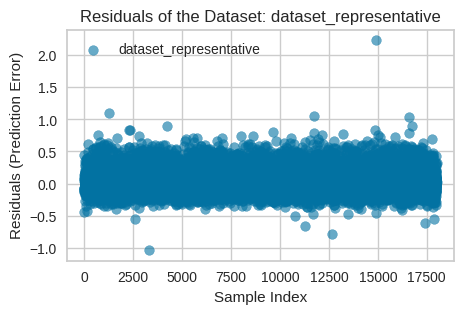

0.022009768507960305


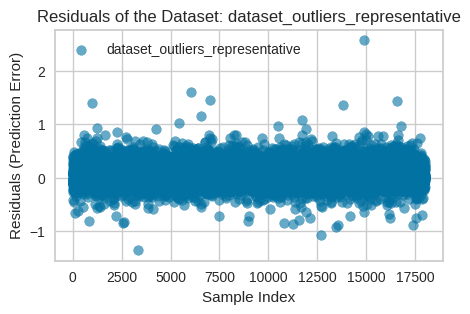

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.104792  0.020619  0.636716  0.062705                          dataset   
 1   0.108586  0.021818  0.615620  0.065202                       dataset_wp   
 2   0.088595  0.013812  0.616630  0.051204                 dataset_outliers   
 3   0.092268  0.014822  0.578143  0.053545              dataset_wp_outliers   
 4   0.095246  0.016487  0.612555  0.055866                dataset_isolation   
 5   0.098746  0.017842  0.564317  0.058294             dataset_wp_isolation   
 6   0.105259  0.020539  0.638104  0.062899                      dataset_log   
 7   0.108683  0.021745  0.616880  0.065214                   dataset_wp_log   
 8   0.095546  0.016858  0.662895  0.056202                   dataset_sample   
 9   0.123060  0.027103  0.522392  0.075081                        dataset_l   
 10  0.123060  0.027103  0.522392  0.075081                     dataset_wp_l   
 11  0.107185  0.019456  0.460008  0.063

In [ ]:
# Linear regression

r_metrics, r_train_metrics, r_residuals, r_predictions = trainSimpleModel(datasets, datasets_names, "median_house_value", LinearRegression(), [17,18], "Linear-Regression", mae, mse)

# My residuals should be centered around 0, there shouldn't be very large values, because it means the model is not capturing
# the values well. The mean of my residuals should be close to 0.
plotResiduals(r_residuals)

r_metrics, r_train_metrics, r_metrics["Score"].mean(), r_metrics["MAE"].mean(), r_metrics["MSE"].mean()

0.019463694193242734


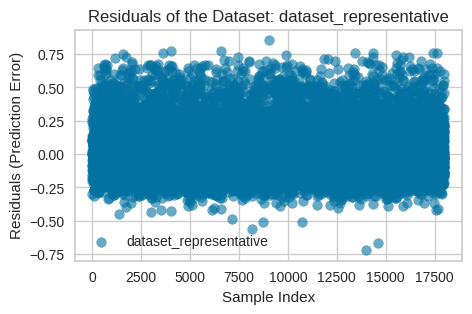

0.03979512493801094


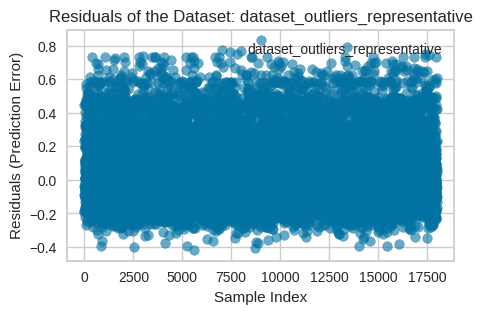

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.089466  0.017870  0.685109  0.053668                          dataset   
 1   0.092269  0.018824  0.668234  0.055546                       dataset_wp   
 2   0.079899  0.013044  0.637961  0.046472                 dataset_outliers   
 3   0.081602  0.013490  0.615968  0.047546              dataset_wp_outliers   
 4   0.084719  0.015077  0.645639  0.049898                dataset_isolation   
 5   0.087904  0.016387  0.599762  0.052145             dataset_wp_isolation   
 6   0.089165  0.017761  0.686952  0.053463                      dataset_log   
 7   0.093028  0.019139  0.662676  0.056083                   dataset_wp_log   
 8   0.109852  0.023351  0.537597  0.066602                   dataset_sample   
 9   0.116886  0.027333  0.518255  0.072110                        dataset_l   
 10  0.116886  0.027333  0.518255  0.072110                     dataset_wp_l   
 11  0.103506  0.020137  0.441066  0.061

In [ ]:
# KNN

k_metrics, k_train_metrics, k_residuals, k_predictions = trainSimpleModel(datasets, datasets_names, "median_house_value", KNeighborsRegressor(n_neighbors=3), [17,18], "KNN")

plotResiduals(k_residuals)

k_metrics, k_train_metrics, k_metrics["Score"].mean(), k_metrics["MAE"].mean(), k_metrics["MSE"].mean()

0.030287749405233457


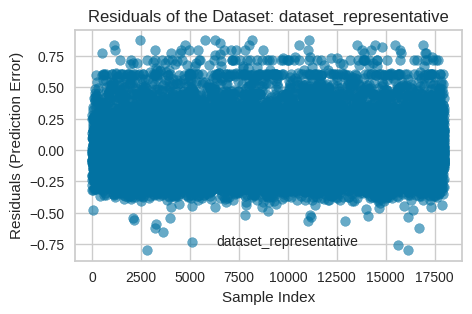

0.029436183081031957


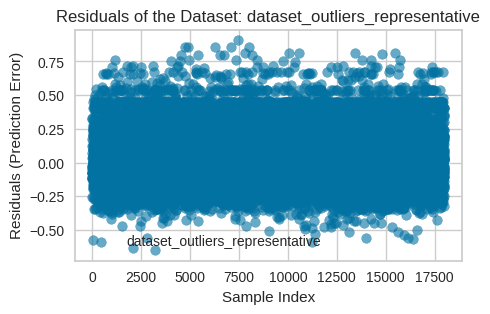

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.110271  0.023420  0.587335  0.066845                          dataset   
 1   0.110212  0.023391  0.587846  0.066802                       dataset_wp   
 2   0.097335  0.017117  0.524847  0.057226                 dataset_outliers   
 3   0.096694  0.016978  0.516977  0.056836              dataset_wp_outliers   
 4   0.103392  0.020201  0.525168  0.061797                dataset_isolation   
 5   0.103740  0.020377  0.502402  0.062059             dataset_wp_isolation   
 6   0.110287  0.023432  0.587121  0.066859                      dataset_log   
 7   0.110228  0.023403  0.587632  0.066815                   dataset_wp_log   
 8   0.123600  0.029759  0.405737  0.076679                   dataset_sample   
 9   0.115500  0.025289  0.554409  0.070394                        dataset_l   
 10  0.115500  0.025289  0.554409  0.070394                     dataset_wp_l   
 11  0.102019  0.018491  0.486787  0.060

In [ ]:
# Decision Tree

decisionTree = DecisionTreeRegressor(
    criterion='squared_error',       # Minimize the mean squared error
    splitter='best',                 # Split using the best split
    max_depth=5,                     # Maximum depth of the tree
    min_samples_split=4,             # Minimum samples required to split a node (to prevent the tree from growing too much)
    min_samples_leaf=2,              # Minimum samples required in a leaf
    random_state=42
)

dt_metrics, dt_train_metrics, dt_residuals, dt_predictions = trainSimpleModel(datasets, datasets_names, "median_house_value", decisionTree, [17,18], "Decision-Tree")

plotResiduals(dt_residuals)

dt_metrics['Score'] = mae * dt_metrics['MAE'] + mse * dt_metrics['MSE']

dt_metrics, dt_train_metrics, dt_metrics["Score"].mean(), dt_metrics["MAE"].mean(), dt_metrics["MSE"].mean()

In [ ]:
# Save all metrics

models_ml_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', 'Dataset', 'Algorithm', 'Score'])

models_ml_metrics = pd.concat([models_ml_metrics, r_metrics], ignore_index=True)
models_ml_metrics = pd.concat([models_ml_metrics, k_metrics], ignore_index=True)
models_ml_metrics = pd.concat([models_ml_metrics, dt_metrics], ignore_index=True)

models_ml_metrics.to_csv("models_ml_metrics.csv")

models_ml_train_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', 'Dataset', 'Algorithm', 'Score'])

models_ml_train_metrics = pd.concat([models_ml_train_metrics, r_train_metrics], ignore_index=True)
models_ml_train_metrics = pd.concat([models_ml_train_metrics, k_train_metrics], ignore_index=True)
models_ml_train_metrics = pd.concat([models_ml_train_metrics, dt_train_metrics], ignore_index=True)

models_ml_train_metrics.to_csv("models_ml_train_metrics.csv")

<ipython-input-18-ab2a8128f8bb>:5: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  models_ml_metrics = pd.concat([models_ml_metrics, r_metrics], ignore_index=True)
<ipython-input-18-ab2a8128f8bb>:13: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  models_ml_train_metrics = pd.concat([models_ml_train_metrics, r_train_metrics], ignore_index=True)


# Train model ensembles - Entrenamiento modelos ensamblados

In [ ]:
def trainEnsembleModel(dfs, dfs_names, target, algorithm, representative, algorithm_name, mae_i = 0.5, mse_i = 0.5):

    metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', "Score", 'Dataset', 'Algorithm'])
    train_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', "Score" ,'Dataset', 'Algorithm'])

    residuals = {}
    predictions = []

    X_r = dfs[0].drop([target], axis=1)
    y_r = dfs[0][target]
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.9)

    for i, df in enumerate(dfs):
        # Separate dataset
        X = df.drop([target], axis=1)
        y = df[target]

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

        if i == representative[0] or i == representative[1]:
          algorithm.fit(X_train, y_train)
          y_pred_train = algorithm.predict(X_train)
          prediction = algorithm.predict(X_test_r)

          # Calculate train metrics
          mae_t = mean_absolute_error(y_train, y_pred_train)
          mse_t = mean_squared_error(y_train, y_pred_train)
          r2_t = r2_score(y_train, y_pred_train)

          # Calculate metrics
          mae = mean_absolute_error(y_test_r, prediction)
          mse = mean_squared_error(y_test_r, prediction)
          r2 = r2_score(y_test_r, prediction)
          # score = mae * mae_i + mse * mse_i

          # Save residuals
          residuals[dfs_names[i]] = y_test_r - prediction

          # Save predictions
          predictions.append(prediction)
        else :
            # Cross validation
            cv = KFold(n_splits=5, shuffle=True, random_state=42)

            scoring = ['neg_mean_absolute_error', 'neg_mean_squared_error', 'r2']

            cv_results = cross_validate(algorithm, X, y, cv=cv, scoring=scoring, return_train_score=True)

            # Convert to positive values
            mae_scores = -cv_results['test_neg_mean_absolute_error']
            mse_scores = -cv_results['test_neg_mean_squared_error']
            r2_scores = cv_results['test_r2']

            # Calculate train means
            mae_t = -cv_results['train_neg_mean_absolute_error'].mean()
            mse_t = -cv_results['train_neg_mean_squared_error'].mean()
            r2_t = cv_results['train_r2'].mean()

            # Calculate means
            mae = mae_scores.mean()
            mse = mse_scores.mean()
            r2 = r2_scores.mean()

        # Calculate the score
        score = mae * mae_i + mse * mse_i
        score_t = mae_t * mae_i + mse_t * mse_i

        # Adding metrics to the dataset
        train_metrics.loc[len(metrics)] = [mae_t, mse_t, r2_t,score_t, dfs_names[i] + "-train", algorithm_name + "-train"]
        metrics.loc[len(metrics)] = [mae, mse, r2,score, dfs_names[i], algorithm_name]

        print(dfs_names[i] + " - training completed")

    os.system('clear')
    return metrics, train_metrics, residuals, predictions

In [ ]:

def tuningHyperparameter(dfs, dfs_names, params, target, algorithm, epochs, algorithm_name, score, b=False):

  # Save Hyperparameters
  hyperparameters = pd.DataFrame(columns=['Dataset', 'Algorithm','bootstrap','max_depth','max_features','min_samples_leaf','min_samples_split','n_estimators','max_samples','learning_rate'
  ,'loss','estimator__max_depth','estimator__min_samples_split', 'subsample'])

  for i, df in enumerate(dfs):

    X = df.drop([target], axis=1)
    y = df[target]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

    random_search = RandomizedSearchCV(
    algorithm,
    param_distributions=params,
    n_iter=epochs,
    scoring='neg_mean_absolute_error',
    cv=5,                               # Cross-validation
    # verbose=2,                        # Show detailed output
    random_state=42,
    # n_jobs=-1                         # Use all available CPU cores
    )

    # Fit the model
    random_search.fit(X_train, y_train)

    # Get best params
    best_params = random_search.best_params_


    hyperparameters.loc[len(hyperparameters)] = [
    dfs_names[i],
    algorithm_name,
    best_params.get('bootstrap', None),
    best_params.get('max_depth', None),
    best_params.get('max_features', None),
    best_params.get('min_samples_leaf', None),
    best_params.get('min_samples_split', None),
    best_params.get('n_estimators', None),
    best_params.get('max_samples', None),
    best_params.get('learning_rate', None),
    best_params.get('loss', None),
    best_params.get('estimator__max_depth', None),
    best_params.get('estimator__min_samples_split', None),
    best_params.get('subsample', None)
    ]

    print(dfs_names[i] + " - search completed")

  #  if(i == 2):
  #    break

  # Get best params for all models
  best_params_for_all_models = hyperparameters.mode().iloc[0]

  return hyperparameters, best_params_for_all_models


# Bagging - Empaquetado

**Random Forest**

In [ ]:
# Random Forest

rf_params = {
    'n_estimators': [10, 20, 50, 100],        # Number of trees in the forest
    'max_depth': [10, 20, 30],                # Maximum depth of trees
    'min_samples_split': [2, 5, 10],          # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],            # Minimum number of samples required at a leaf node
    'max_features': [ 'sqrt', 'log2'],        # Number of features to consider for the best split
    'bootstrap': [True, False]                # Whether to use bootstrap samples for building trees
}

rf_hyperparameters, rf_model_params = tuningHyperparameter(datasets, datasets_names, rf_params, "median_house_value", RandomForestRegressor(random_state=42), 5, "Random-Forest", "neg_mean_absolute_error")

dataset - search completed
dataset_wp - search completed
dataset_outliers - search completed
dataset_wp_outliers - search completed
dataset_isolation - search completed
dataset_wp_isolation - search completed
dataset_log - search completed
dataset_wp_log - search completed
dataset_sample - search completed
dataset_l - search completed
dataset_wp_l - search completed
dataset_outliers_l - search completed
dataset_wp_outliers_l - search completed
dataset_isolation_l - search completed
dataset_wp_isolation_l - search completed
dataset_log_l - search completed
dataset_wp_log_l - search completed
dataset_representative - search completed
dataset_outliers_representative - search completed
dataset_isolation_l_generated - search completed
dataset_isolation_generated - search completed
dataset_outliers_generated - search completed
dataset_outliers_l_generated - search completed
dataset_reduce_l - search completed
dataset_reduce_outliers_l - search completed
dataset_reduce_isolation_l - search co

In [ ]:
rf_model_params

,0
Dataset,dataset
Algorithm,Random-Forest
bootstrap,True
max_depth,20.0
max_features,sqrt
min_samples_leaf,1.0
min_samples_split,2.0
n_estimators,100.0
max_samples,NaN
learning_rate,NaN


In [ ]:
rf_hyperparameters

,Dataset,Algorithm,bootstrap,max_depth,max_features,min_samples_leaf,min_samples_split,n_estimators,max_samples,learning_rate,loss,estimator__max_depth,estimator__min_samples_split,subsample
0,dataset,Random-Forest,False,30,log2,4,5,10,None,None,None,None,None,None
1,dataset_wp,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None
2,dataset_outliers,Random-Forest,False,30,log2,4,5,10,None,None,None,None,None,None
3,dataset_wp_outliers,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None
4,dataset_isolation,Random-Forest,False,30,log2,4,5,10,None,None,None,None,None,None
5,dataset_wp_isolation,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None
6,dataset_log,Random-Forest,False,30,log2,4,5,10,None,None,None,None,None,None
7,dataset_wp_log,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None
8,dataset_sample,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None
9,dataset_l,Random-Forest,True,20,sqrt,1,2,100,None,None,None,None,None,None


dataset - training completed
dataset_wp - training completed
dataset_outliers - training completed
dataset_wp_outliers - training completed
dataset_isolation - training completed
dataset_wp_isolation - training completed
dataset_log - training completed
dataset_wp_log - training completed
dataset_sample - training completed
dataset_l - training completed
dataset_wp_l - training completed
dataset_outliers_l - training completed
dataset_wp_outliers_l - training completed
dataset_isolation_l - training completed
dataset_wp_isolation_l - training completed
dataset_log_l - training completed
dataset_wp_log_l - training completed
dataset_representative - training completed
dataset_outliers_representative - training completed
dataset_isolation_l_generated - training completed
dataset_isolation_generated - training completed
dataset_outliers_generated - training completed
dataset_outliers_l_generated - training completed
dataset_reduce_l - training completed
dataset_reduce_outliers_l - trainin

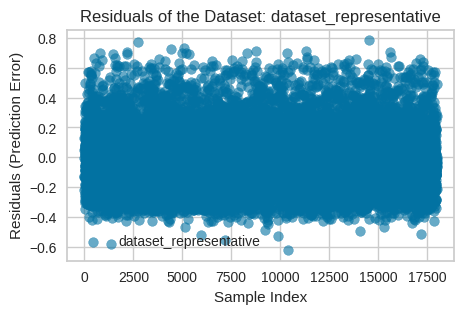

0.05137551437359478


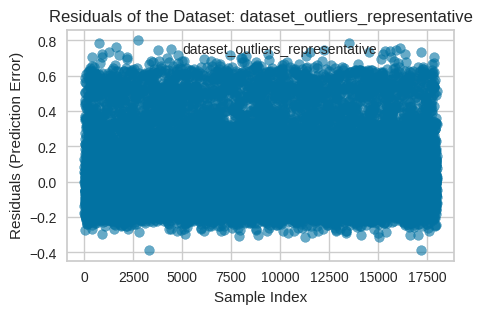

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.071703  0.011084  0.804684  0.041393                          dataset   
 1   0.073870  0.011732  0.793238  0.042801                       dataset_wp   
 2   0.064833  0.008516  0.763627  0.036675                 dataset_outliers   
 3   0.066688  0.008918  0.746196  0.037803              dataset_wp_outliers   
 4   0.067639  0.009449  0.777965  0.038544                dataset_isolation   
 5   0.069360  0.010059  0.754406  0.039709             dataset_wp_isolation   
 6   0.071663  0.011083  0.804702  0.041373                      dataset_log   
 7   0.073846  0.011739  0.793116  0.042793                   dataset_wp_log   
 8   0.105374  0.019609  0.610508  0.062492                   dataset_sample   
 9   0.100091  0.020186  0.644211  0.060139                        dataset_l   
 10  0.100091  0.020186  0.644211  0.060139                     dataset_wp_l   
 11  0.089318  0.015029  0.582851  0.052

In [ ]:
# Random Forest

randomForest = RandomForestRegressor(
    n_estimators=int(rf_model_params["n_estimators"]),            # Number of trees
    max_depth=int(rf_model_params["max_depth"]),                  # Maximum depth of the tree
    min_samples_split=int(rf_model_params["min_samples_split"]),  # Minimum samples required to split a node (to prevent the tree from growing too much)
    min_samples_leaf=int(rf_model_params["min_samples_leaf"]),    # Minimum samples required in a leaf
    max_features=rf_model_params["max_features"],                 # Use square root of features at each split
    random_state=42,
    bootstrap=rf_model_params["bootstrap"]                        # Use sampling with replacement
)

rf_metrics, rf_train_metrics, rf_residuals, rf_predictions = trainEnsembleModel(datasets, datasets_names, "median_house_value", randomForest, [17,18], "Random-Forest")

plotResiduals(rf_residuals)

rf_metrics, rf_train_metrics, rf_metrics["Score"].mean(), rf_metrics["MAE"].mean(), rf_metrics["MSE"].mean()

**Extra Trees**

In [ ]:
# Extra Trees

et_params = {
    'n_estimators': [10, 20, 50, 100],
    'max_depth': [10, 20, 30],                # Maximum depth of trees
    'min_samples_split': [2, 5, 10],          # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],            # Minimum number of samples required at a leaf node
    'max_features': ['sqrt', 'log2'],         # Number of features to consider for the best split
    'bootstrap': [True, False]                # Whether to use bootstrap samples for building trees
}

et_hyperparameters, et_model_params = tuningHyperparameter(datasets,datasets_names,et_params,"median_house_value",ExtraTreesRegressor(random_state=42),epochs=6,algorithm_name="Extra-Trees",score="neg_mean_absolute_error" )

dataset - search completed
dataset_wp - search completed
dataset_outliers - search completed
dataset_wp_outliers - search completed
dataset_isolation - search completed
dataset_wp_isolation - search completed
dataset_log - search completed
dataset_wp_log - search completed
dataset_sample - search completed
dataset_l - search completed
dataset_wp_l - search completed
dataset_outliers_l - search completed
dataset_wp_outliers_l - search completed
dataset_isolation_l - search completed
dataset_wp_isolation_l - search completed
dataset_log_l - search completed
dataset_wp_log_l - search completed
dataset_representative - search completed
dataset_outliers_representative - search completed
dataset_isolation_l_generated - search completed
dataset_isolation_generated - search completed
dataset_outliers_generated - search completed
dataset_outliers_l_generated - search completed
dataset_reduce_l - search completed
dataset_reduce_outliers_l - search completed
dataset_reduce_isolation_l - search co

In [ ]:
et_hyperparameters

,Dataset,Algorithm,bootstrap,max_depth,max_features,min_samples_leaf,min_samples_split,n_estimators,max_samples,learning_rate,loss,estimator__max_depth,estimator__min_samples_split,subsample
0,dataset,Extra-Trees,True,30,log2,1,2,10,None,None,None,None,None,None
1,dataset_wp,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
2,dataset_outliers,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
3,dataset_wp_outliers,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
4,dataset_isolation,Extra-Trees,True,30,log2,1,2,10,None,None,None,None,None,None
5,dataset_wp_isolation,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
6,dataset_log,Extra-Trees,True,30,log2,1,2,10,None,None,None,None,None,None
7,dataset_wp_log,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
8,dataset_sample,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None
9,dataset_l,Extra-Trees,True,20,sqrt,1,2,100,None,None,None,None,None,None


In [ ]:
et_model_params

,0
Dataset,dataset
Algorithm,Extra-Trees
bootstrap,True
max_depth,20.0
max_features,sqrt
min_samples_leaf,1.0
min_samples_split,2.0
n_estimators,100.0
max_samples,NaN
learning_rate,NaN


dataset - training completed
dataset_wp - training completed
dataset_outliers - training completed
dataset_wp_outliers - training completed
dataset_isolation - training completed
dataset_wp_isolation - training completed
dataset_log - training completed
dataset_wp_log - training completed
dataset_sample - training completed
dataset_l - training completed
dataset_wp_l - training completed
dataset_outliers_l - training completed
dataset_wp_outliers_l - training completed
dataset_isolation_l - training completed
dataset_wp_isolation_l - training completed
dataset_log_l - training completed
dataset_wp_log_l - training completed
dataset_representative - training completed
dataset_outliers_representative - training completed
dataset_isolation_l_generated - training completed
dataset_isolation_generated - training completed
dataset_outliers_generated - training completed
dataset_outliers_l_generated - training completed
dataset_reduce_l - training completed
dataset_reduce_outliers_l - trainin

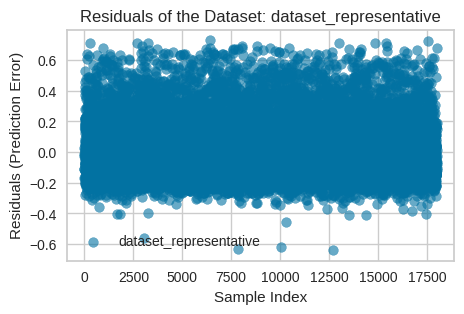

0.04448830371375326


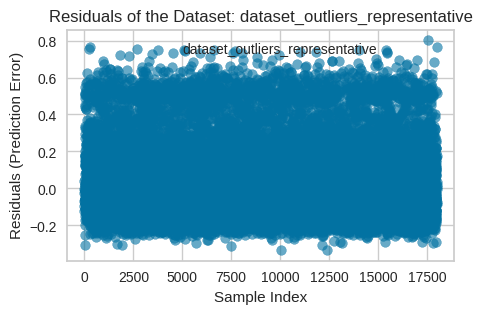

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.085621  0.014447  0.745436  0.050034                          dataset   
 1   0.087460  0.015234  0.731554  0.051347                       dataset_wp   
 2   0.075502  0.010636  0.704786  0.043069                 dataset_outliers   
 3   0.077845  0.011298  0.678551  0.044571              dataset_wp_outliers   
 4   0.078634  0.011943  0.719468  0.045288                dataset_isolation   
 5   0.081565  0.013114  0.679786  0.047339             dataset_wp_isolation   
 6   0.085571  0.014453  0.745344  0.050012                      dataset_log   
 7   0.087232  0.015150  0.733059  0.051191                   dataset_wp_log   
 8   0.106255  0.020259  0.600957  0.063257                   dataset_sample   
 9   0.103457  0.020751  0.634317  0.062104                        dataset_l   
 10  0.103457  0.020751  0.634317  0.062104                     dataset_wp_l   
 11  0.093380  0.015832  0.560584  0.054

In [ ]:
# Extra Trees

extraTrees = ExtraTreesRegressor(
    n_estimators=int(et_model_params["n_estimators"]),           # Number of trees
    max_depth=int(et_model_params["max_depth"]),                 # Maximum depth
    min_samples_split=int(et_model_params["min_samples_split"]), # Minimum samples required to split a node
    min_samples_leaf=int(et_model_params["min_samples_leaf"]),   # Minimum samples required at each leaf
    max_features=et_model_params["max_features"],                # Square root of the features at each split
    bootstrap=et_model_params["bootstrap"],                      # Use bootstrap samples (sampling with replacement)
    random_state=42,
    # n_jobs=-1,                                                 # Use all available cores
    oob_score=False,                                             # Calculate out-of-bag score
    # verbose=1
    )


et_metrics, et_train_metrics, et_residuals, et_predictions = trainEnsembleModel(datasets, datasets_names, "median_house_value", extraTrees, [17,18], "Extra-Trees")

plotResiduals(et_residuals)

et_metrics, et_train_metrics, et_metrics["Score"].mean(), et_metrics["MAE"].mean(), et_metrics["MSE"].mean()

**Bagging**

In [ ]:
# Bagging

b_params = {
    'n_estimators': [10, 20, 50, 100],
    'max_samples': [0.2,0.4,0.6,0.8],         # Number of features to consider for the best split
    'bootstrap': [True, False]                # Whether to use bootstrap samples for building trees
}

b_hyperparameters, b_model_params = tuningHyperparameter(datasets,datasets_names,b_params,"median_house_value",BaggingRegressor(DecisionTreeRegressor(),random_state=42),epochs=5,algorithm_name="Bagging",score="neg_mean_absolute_error" )

dataset - search completed
dataset_wp - search completed
dataset_outliers - search completed
dataset_wp_outliers - search completed
dataset_isolation - search completed
dataset_wp_isolation - search completed
dataset_log - search completed
dataset_wp_log - search completed
dataset_sample - search completed
dataset_l - search completed
dataset_wp_l - search completed
dataset_outliers_l - search completed
dataset_wp_outliers_l - search completed
dataset_isolation_l - search completed
dataset_wp_isolation_l - search completed
dataset_log_l - search completed
dataset_wp_log_l - search completed
dataset_representative - search completed
dataset_outliers_representative - search completed
dataset_isolation_l_generated - search completed
dataset_isolation_generated - search completed
dataset_outliers_generated - search completed
dataset_outliers_l_generated - search completed
dataset_reduce_l - search completed
dataset_reduce_outliers_l - search completed
dataset_reduce_isolation_l - search co

In [ ]:
b_hyperparameters

,Dataset,Algorithm,bootstrap,max_depth,max_features,min_samples_leaf,min_samples_split,n_estimators,max_samples,learning_rate,loss,estimator__max_depth,estimator__min_samples_split,subsample
0,dataset,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
1,dataset_wp,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
2,dataset_outliers,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
3,dataset_wp_outliers,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
4,dataset_isolation,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
5,dataset_wp_isolation,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
6,dataset_log,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
7,dataset_wp_log,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
8,dataset_sample,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None
9,dataset_l,Bagging,True,None,None,None,None,100,0.8,None,None,None,None,None


In [ ]:
b_model_params

,0
Dataset,dataset
Algorithm,Bagging
bootstrap,True
max_depth,NaN
max_features,NaN
min_samples_leaf,NaN
min_samples_split,NaN
n_estimators,100.0
max_samples,0.8
learning_rate,NaN


dataset - training completed
dataset_wp - training completed
dataset_outliers - training completed
dataset_wp_outliers - training completed
dataset_isolation - training completed
dataset_wp_isolation - training completed
dataset_log - training completed
dataset_wp_log - training completed
dataset_sample - training completed
dataset_l - training completed
dataset_wp_l - training completed
dataset_outliers_l - training completed
dataset_wp_outliers_l - training completed
dataset_isolation_l - training completed
dataset_wp_isolation_l - training completed
dataset_log_l - training completed
dataset_wp_log_l - training completed
dataset_representative - training completed
dataset_outliers_representative - training completed
dataset_isolation_l_generated - training completed
dataset_isolation_generated - training completed
dataset_outliers_generated - training completed
dataset_outliers_l_generated - training completed
dataset_reduce_l - training completed
dataset_reduce_outliers_l - trainin

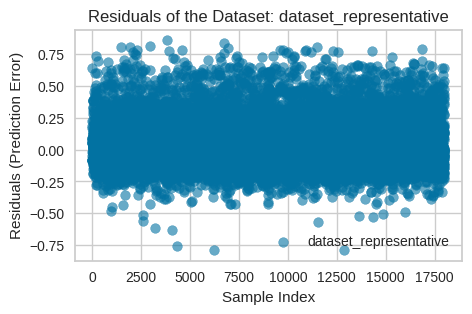

0.04138578283067795


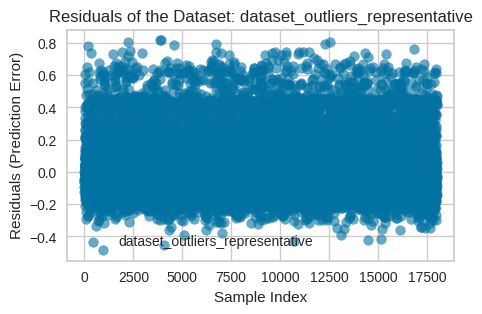

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.066053  0.010205  0.820142  0.038129                          dataset   
 1   0.067160  0.010493  0.815087  0.038827                       dataset_wp   
 2   0.059380  0.007726  0.785546  0.033553                 dataset_outliers   
 3   0.059902  0.007840  0.776858  0.033871              dataset_wp_outliers   
 4   0.062743  0.008706  0.795360  0.035725                dataset_isolation   
 5   0.062811  0.008768  0.785880  0.035790             dataset_wp_isolation   
 6   0.066063  0.010221  0.819869  0.038142                      dataset_log   
 7   0.067146  0.010513  0.814737  0.038830                   dataset_wp_log   
 8   0.098920  0.018771  0.628080  0.058845                   dataset_sample   
 9   0.101279  0.020690  0.635342  0.060985                        dataset_l   
 10  0.101279  0.020690  0.635342  0.060985                     dataset_wp_l   
 11  0.089460  0.015141  0.579758  0.052

In [ ]:
# Bagging

bagging = BaggingRegressor(
    DecisionTreeRegressor(),
    n_estimators=int(b_model_params["n_estimators"]),     # Number of trees
    max_samples=b_model_params["max_samples"],            # Fraction of samples for each tree
    bootstrap=b_model_params["bootstrap"],                # Use samples with replacement
    #n_jobs=-1,                                           # Use all available cores
    random_state=42,
    oob_score=False                                       # Calculate the OOB score
    #verbose=1                                            # Show progress during training
)

b_metrics, b_train_metrics, b_residuals, b_predictions = trainEnsembleModel(datasets, datasets_names, "median_house_value", bagging, [17,18], "Bagging")

plotResiduals(b_residuals)

b_metrics, b_train_metrics, b_metrics["Score"].mean(), b_metrics["MAE"].mean(), b_metrics["MSE"].mean()

# Boosting - Impulsados

**Ada Boost**

In [ ]:
# Ada Boost

ad_params = {
    'n_estimators': [50, 100, 200],              # Number of models
    'learning_rate': [0.01, 0.1, 0.5, 0.001],
    'loss': ['linear', 'square', 'exponential'], # Loss function
    'estimator__max_depth': [3, 5, 10],          # Maximum depth of the tree
    'estimator__min_samples_split': [2, 5, 10]   # Minimum number of samples required to split
}

ad_hyperparameters, ad_model_params = tuningHyperparameter(datasets,datasets_names,ad_params,"median_house_value",AdaBoostRegressor(DecisionTreeRegressor(),random_state=42),epochs=5,algorithm_name="Ada-Boost",score="neg_mean_absolute_error" )

dataset - search completed
dataset_wp - search completed
dataset_outliers - search completed
dataset_wp_outliers - search completed
dataset_isolation - search completed
dataset_wp_isolation - search completed
dataset_log - search completed
dataset_wp_log - search completed
dataset_sample - search completed
dataset_l - search completed
dataset_wp_l - search completed
dataset_outliers_l - search completed
dataset_wp_outliers_l - search completed
dataset_isolation_l - search completed
dataset_wp_isolation_l - search completed
dataset_log_l - search completed
dataset_wp_log_l - search completed
dataset_representative - search completed
dataset_outliers_representative - search completed
dataset_isolation_l_generated - search completed
dataset_isolation_generated - search completed
dataset_outliers_generated - search completed
dataset_outliers_l_generated - search completed
dataset_reduce_l - search completed
dataset_reduce_outliers_l - search completed
dataset_reduce_isolation_l - search co

In [ ]:
ad_hyperparameters

,Dataset,Algorithm,bootstrap,max_depth,max_features,min_samples_leaf,min_samples_split,n_estimators,max_samples,learning_rate,loss,estimator__max_depth,estimator__min_samples_split,subsample
0,dataset,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None
1,dataset_wp,Ada-Boost,None,None,None,None,None,50,None,0.010,linear,5,10,None
2,dataset_outliers,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None
3,dataset_wp_outliers,Ada-Boost,None,None,None,None,None,50,None,0.010,linear,5,10,None
4,dataset_isolation,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None
5,dataset_wp_isolation,Ada-Boost,None,None,None,None,None,50,None,0.010,linear,5,10,None
6,dataset_log,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None
7,dataset_wp_log,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None
8,dataset_sample,Ada-Boost,None,None,None,None,None,50,None,0.010,linear,5,2,None
9,dataset_l,Ada-Boost,None,None,None,None,None,200,None,0.001,linear,5,2,None


In [ ]:
ad_model_params

,0
Dataset,dataset
Algorithm,Ada-Boost
bootstrap,NaN
max_depth,NaN
max_features,NaN
min_samples_leaf,NaN
min_samples_split,NaN
n_estimators,200.0
max_samples,NaN
learning_rate,0.001


dataset - training completed
dataset_wp - training completed
dataset_outliers - training completed
dataset_wp_outliers - training completed
dataset_isolation - training completed
dataset_wp_isolation - training completed
dataset_log - training completed
dataset_wp_log - training completed
dataset_sample - training completed
dataset_l - training completed
dataset_wp_l - training completed
dataset_outliers_l - training completed
dataset_wp_outliers_l - training completed
dataset_isolation_l - training completed
dataset_wp_isolation_l - training completed
dataset_log_l - training completed
dataset_wp_log_l - training completed
dataset_representative - training completed
dataset_outliers_representative - training completed
dataset_isolation_l_generated - training completed
dataset_isolation_generated - training completed
dataset_outliers_generated - training completed
dataset_outliers_l_generated - training completed
dataset_reduce_l - training completed
dataset_reduce_outliers_l - trainin

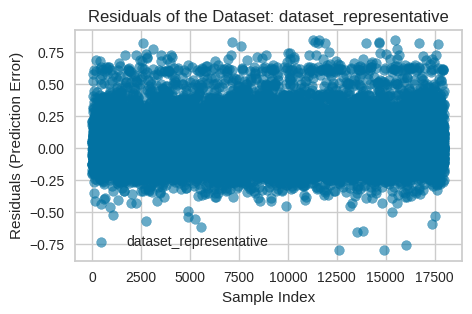

0.034033882902575294


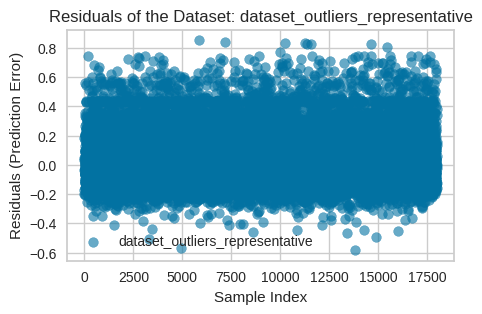

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.106624  0.021981  0.612676  0.064303                          dataset   
 1   0.106519  0.021936  0.613490  0.064228                       dataset_wp   
 2   0.093454  0.015786  0.561838  0.054620                 dataset_outliers   
 3   0.092521  0.015506  0.558863  0.054014              dataset_wp_outliers   
 4   0.100772  0.019285  0.546869  0.060028                dataset_isolation   
 5   0.099633  0.018815  0.540504  0.059224             dataset_wp_isolation   
 6   0.106651  0.021986  0.612601  0.064318                      dataset_log   
 7   0.106606  0.021986  0.612610  0.064296                   dataset_wp_log   
 8   0.102271  0.021991  0.567172  0.062131                   dataset_sample   
 9   0.113011  0.024193  0.573719  0.068602                        dataset_l   
 10  0.113011  0.024193  0.573719  0.068602                     dataset_wp_l   
 11  0.099317  0.017550  0.512890  0.058

In [ ]:
# Ada Boost

adaBoost = AdaBoostRegressor(
    DecisionTreeRegressor(max_depth=int(ad_model_params["estimator__max_depth"]),min_samples_split=int(ad_model_params["estimator__min_samples_split"])),
    n_estimators=int(ad_model_params["n_estimators"]),
    learning_rate=ad_model_params["learning_rate"],
    loss=ad_model_params["loss"],
    random_state=42
)

ad_metrics, ad_train_metrics, ad_residuals, ad_predictions = trainEnsembleModel(datasets, datasets_names, "median_house_value", adaBoost, [17,18], "Ada-Boost")

plotResiduals(ad_residuals)

ad_metrics, ad_train_metrics, ad_metrics["Score"].mean(), ad_metrics["MAE"].mean()

**Gradient Boosting Regressor**

In [ ]:
# Gradient Boosting Regressor

gb_params = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.5, 0.001],
    'max_depth': [3, 5, 10],                    # Maximum depth of the tree
    'min_samples_split': [2, 5, 10],            # Minimum samples required to split a node
    'min_samples_leaf': [1, 2, 4],              # Minimum samples required for a leaf node
    'subsample': [0.6, 0.8, 1.0],               # Proportion of data used to train each tree
    'max_features': ['sqrt', 'log2']            # Features to consider for each split
}

gb_hyperparameters, gb_model_params = tuningHyperparameter(datasets,datasets_names,gb_params,"median_house_value",GradientBoostingRegressor(random_state=42),epochs=5,algorithm_name="Gradient-Boosting-Regressor",score="neg_mean_absolute_error" )

dataset - search completed
dataset_wp - search completed
dataset_outliers - search completed
dataset_wp_outliers - search completed
dataset_isolation - search completed
dataset_wp_isolation - search completed
dataset_log - search completed
dataset_wp_log - search completed
dataset_sample - search completed
dataset_l - search completed
dataset_wp_l - search completed
dataset_outliers_l - search completed
dataset_wp_outliers_l - search completed
dataset_isolation_l - search completed
dataset_wp_isolation_l - search completed
dataset_log_l - search completed
dataset_wp_log_l - search completed
dataset_representative - search completed
dataset_outliers_representative - search completed
dataset_isolation_l_generated - search completed
dataset_isolation_generated - search completed
dataset_outliers_generated - search completed
dataset_outliers_l_generated - search completed
dataset_reduce_l - search completed
dataset_reduce_outliers_l - search completed
dataset_reduce_isolation_l - search co

In [ ]:
gb_hyperparameters

,Dataset,Algorithm,bootstrap,max_depth,max_features,min_samples_leaf,min_samples_split,n_estimators,max_samples,learning_rate,loss,estimator__max_depth,estimator__min_samples_split,subsample
0,dataset,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
1,dataset_wp,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
2,dataset_outliers,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
3,dataset_wp_outliers,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
4,dataset_isolation,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
5,dataset_wp_isolation,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
6,dataset_log,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
7,dataset_wp_log,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
8,dataset_sample,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0
9,dataset_l,Gradient-Boosting-Regressor,None,10,sqrt,2,10,100,None,0.1,None,None,None,1.0


In [ ]:
gb_model_params

,0
Dataset,dataset
Algorithm,Gradient-Boosting-Regressor
bootstrap,NaN
max_depth,10.0
max_features,sqrt
min_samples_leaf,2.0
min_samples_split,10.0
n_estimators,100.0
max_samples,NaN
learning_rate,0.1


dataset - training completed
dataset_wp - training completed
dataset_outliers - training completed
dataset_wp_outliers - training completed
dataset_isolation - training completed
dataset_wp_isolation - training completed
dataset_log - training completed
dataset_wp_log - training completed
dataset_sample - training completed
dataset_l - training completed
dataset_wp_l - training completed
dataset_outliers_l - training completed
dataset_wp_outliers_l - training completed
dataset_isolation_l - training completed
dataset_wp_isolation_l - training completed
dataset_log_l - training completed
dataset_wp_log_l - training completed
dataset_representative - training completed
dataset_outliers_representative - training completed
dataset_isolation_l_generated - training completed
dataset_isolation_generated - training completed
dataset_outliers_generated - training completed
dataset_outliers_l_generated - training completed
dataset_reduce_l - training completed
dataset_reduce_outliers_l - trainin

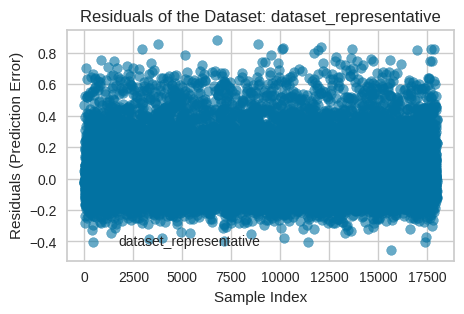

0.053030568994500246


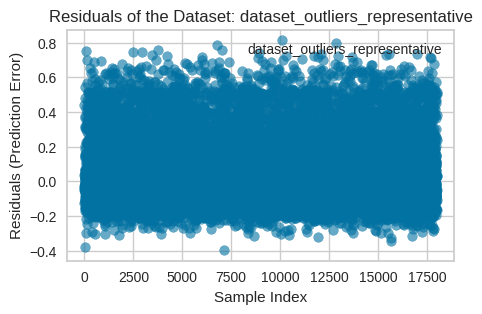

(         MAE       MSE        R2     Score                          Dataset  \
 0   0.066859  0.010805  0.809605  0.038832                          dataset   
 1   0.070233  0.011837  0.791369  0.041035                       dataset_wp   
 2   0.060159  0.008081  0.775712  0.034120                 dataset_outliers   
 3   0.062830  0.008673  0.753153  0.035752              dataset_wp_outliers   
 4   0.062875  0.009029  0.787819  0.035952                dataset_isolation   
 5   0.065459  0.009874  0.758908  0.037667             dataset_wp_isolation   
 6   0.066872  0.010807  0.809569  0.038839                      dataset_log   
 7   0.070257  0.011845  0.791222  0.041051                   dataset_wp_log   
 8   0.092221  0.016373  0.676616  0.054297                   dataset_sample   
 9   0.095749  0.020705  0.635063  0.058227                        dataset_l   
 10  0.095749  0.020705  0.635063  0.058227                     dataset_wp_l   
 11  0.085804  0.015142  0.579795  0.050

In [ ]:
# Gradient Boosting Regressor

GBregressor = GradientBoostingRegressor(
    n_estimators=int(gb_model_params["n_estimators"]),
    learning_rate=gb_model_params["learning_rate"],
    max_depth=int(gb_model_params["max_depth"]),
    min_samples_split=int(gb_model_params["min_samples_split"]),
    min_samples_leaf=int(gb_model_params["min_samples_leaf"]),
    subsample=gb_model_params["subsample"],
    max_features=gb_model_params["max_features"],
    random_state=42,
    loss="absolute_error"
)

gb_metrics, gb_train_metrics, gb_residuals, gb_predictions = trainEnsembleModel(datasets, datasets_names, "median_house_value", GBregressor, [17,18], "Gradient-Boosting-Regressor")

plotResiduals(gb_residuals)

gb_metrics, gb_train_metrics, gb_metrics["Score"].mean(), gb_metrics["MAE"].mean()

# Save metrics and hyperparameters - Guardar métricas y hiperparámetros

In [ ]:
models_e_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', 'Dataset', 'Algorithm', 'Score'])

# Bagging
models_e_metrics = pd.concat([models_e_metrics, rf_metrics], ignore_index=True)
models_e_metrics = pd.concat([models_e_metrics, et_metrics], ignore_index=True)
models_e_metrics = pd.concat([models_e_metrics, b_metrics], ignore_index=True)
# Boosting
models_e_metrics = pd.concat([models_e_metrics, ad_metrics], ignore_index=True)
models_e_metrics = pd.concat([models_e_metrics, gb_metrics], ignore_index=True)

models_e_metrics.to_csv("models_e_metrics.csv")

models_e_train_metrics = pd.DataFrame(columns=['MAE', 'MSE', 'R2', 'Dataset', 'Algorithm', 'Score'])

# Bagging
models_e_train_metrics = pd.concat([models_e_train_metrics, rf_train_metrics], ignore_index=True)
models_e_train_metrics = pd.concat([models_e_train_metrics, et_train_metrics], ignore_index=True)
models_e_train_metrics = pd.concat([models_e_train_metrics, b_train_metrics], ignore_index=True)
# Boosting
models_e_train_metrics = pd.concat([models_e_train_metrics, ad_train_metrics], ignore_index=True)
models_e_train_metrics = pd.concat([models_e_train_metrics, gb_train_metrics], ignore_index=True)

models_e_train_metrics.to_csv("models_e_train_metrics.csv")

# Hyperparameters

hyperparameters_e = pd.DataFrame(columns=['Dataset','Algorithm','bootstrap','max_depth','max_features','min_samples_leaf','min_samples_split','n_estimators','max_samples','learning_rate'
  ,'loss','estimator__max_depth','estimator__min_samples_split', 'subsample'])

# Bagging
hyperparameters_e = pd.concat([hyperparameters_e, rf_hyperparameters], ignore_index=True)
hyperparameters_e = pd.concat([hyperparameters_e, et_hyperparameters], ignore_index=True)
hyperparameters_e = pd.concat([hyperparameters_e, b_hyperparameters], ignore_index=True)
# Boosting
hyperparameters_e = pd.concat([hyperparameters_e, ad_hyperparameters], ignore_index=True)
hyperparameters_e = pd.concat([hyperparameters_e, gb_hyperparameters], ignore_index=True)

hyperparameters_e.to_csv("hyperparameters_e.csv")

hyperparameters_better_e = pd.DataFrame(columns=['Dataset','Algorithm','bootstrap','max_depth','max_features','min_samples_leaf','min_samples_split','n_estimators','max_samples','learning_rate'
  ,'loss','estimator__max_depth','estimator__min_samples_split', 'subsample'])

# Bagging
hyperparameters_better_e = pd.concat([hyperparameters_better_e, pd.DataFrame([rf_model_params])], ignore_index=True)
hyperparameters_better_e = pd.concat([hyperparameters_better_e, pd.DataFrame([et_model_params])], ignore_index=True)
hyperparameters_better_e = pd.concat([hyperparameters_better_e, pd.DataFrame([b_model_params])], ignore_index=True)
# Boosting
hyperparameters_better_e = pd.concat([hyperparameters_better_e, pd.DataFrame([ad_model_params])], ignore_index=True)
hyperparameters_better_e = pd.concat([hyperparameters_better_e, pd.DataFrame([gb_model_params])], ignore_index=True)

hyperparameters_better_e.to_csv("hyperparameters_better_e.csv")

<ipython-input-107-1c95d575aa86>:4: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  models_e_metrics = pd.concat([models_e_metrics, rf_metrics], ignore_index=True)
<ipython-input-107-1c95d575aa86>:16: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  models_e_train_metrics = pd.concat([models_e_train_metrics, rf_train_metrics], ignore_index=True)
<ipython-input-107-1c95d575aa86>:33: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, 

# Deep learning - Aprendizaje profundo

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [ ]:
# Create Datasets

def createPytorchDataloaders(dfs, target, representative, batch_size=64):
    pytorch_dataloaders = []

    # Create a representative dataset
    X_r = dfs[0].drop([target], axis=1)
    y_r = dfs[0][target]
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.8)

    # Iterate on the other datasets
    for i, df in enumerate(dfs):
        X = df.drop([target], axis=1)
        y = df[target]

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

        train_dataset = TensorDataset(torch.tensor(X_train.values, dtype=torch.float32), torch.tensor(y_train.values, dtype=torch.float32))

        if i == representative[0] or i == representative[1]:
          # Convert to PyTorch datasets
          test_dataset = TensorDataset(torch.tensor(X_test_r.values, dtype=torch.float32), torch.tensor(y_test_r.values, dtype=torch.float32))
        else:
          # Convert to PyTorch datasets
          test_dataset = TensorDataset(torch.tensor(X_test.values, dtype=torch.float32), torch.tensor(y_test.values, dtype=torch.float32))


        # DataLoaders
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

        pytorch_dataloaders.append((train_loader, test_loader))

    return pytorch_dataloaders

In [ ]:
dataLoaders = createPytorchDataloaders(datasets,"median_house_value", [17,18],64)

dataLoaders[0]

(<torch.utils.data.dataloader.DataLoader at 0x7ac1d9d958a0>,
 <torch.utils.data.dataloader.DataLoader at 0x7ac1d9d973a0>)

In [ ]:
def summarizeLoader(loader, name="Loader", df_name=""):

    total_batches = 0
    batch_size = None
    feature_size = None

    for X_batch, y_batch in loader:
        total_batches += 1
        if batch_size is None:
            batch_size = X_batch.size(0)
            feature_size = X_batch.size(1)

    print(f"{df_name} Summary:")
    print(f"  Total Batches: {total_batches}")
    print(f"  Batch Size: {batch_size}")
    print(f"  Feature Columns: {feature_size}")


In [ ]:
ind = 25
train_loader, test_loader = dataLoaders[ind]
summarizeLoader(train_loader, name="Train Loader",df_name=datasets_names[ind])
summarizeLoader(test_loader, name="Test Loader", df_name=datasets_names[ind])

dataset_reduce_isolation_l Summary:
  Total Batches: 219
  Batch Size: 64
  Feature Columns: 3
dataset_reduce_isolation_l Summary:
  Total Batches: 55
  Batch Size: 64
  Feature Columns: 3


In [ ]:
# Model

def block(c_in, c_out, relu=True, bn=False, ln=False, dropout=False, dropout_prob=0.5, use_xavier_init=False):
    layers = [torch.nn.Linear(c_in, c_out)]

    # Starting weights with Xavier
    if use_xavier_init:
      torch.nn.init.xavier_uniform_(layers[0].weight)

    if relu:
        layers.append(torch.nn.ReLU())

    # Batch Normalization
    if bn:
        layers.append(torch.nn.BatchNorm1d(c_out))

    # Layer Normalization
    if ln:
        layers.append(torch.nn.LayerNorm(c_out))

    # Dropout
    if dropout:
        layers.append(torch.nn.Dropout(p=dropout_prob))

    return torch.nn.Sequential(*layers)


class Model(torch.nn.Module):
    def __init__(self, n_outputs=1, layers=None, use_xavier_init=False):
        super().__init__()

        self.blocks = torch.nn.ModuleDict()

        for i, layer in enumerate(layers):
            self.blocks[f"conv{i+1}"] = block(layer["c_in"], layer["c_out"], layer["relu"], layer["bn"], layer["ln"], layer["dropout"], layer["dropout_prob"],use_xavier_init)

        # Final layer
        self.fc = torch.nn.Linear(layers[-1]["c_out"], n_outputs)

        # Starting weights of the final layer with Xavier
        if use_xavier_init:
            torch.nn.init.xavier_uniform_(self.fc.weight)

    def forward(self, x):
        # Go through all layers dynamically
        for name, layer in self.blocks.items():
            x = layer(x)

        x = self.fc(x)
        return x

In [ ]:
# Train function
def fit(model, train_loader, val_loader, criterion, optimizer, epochs=1, device="cuda", lr=1e-3, epochs_log=10, lr_decay_rate=0.95, lr_decay_steps=1, patience=10):

    model.to(device)

    # Initializing the scheduler to reduce the learning rate exponentially
    # Inicializar el scheduler para reducir el learning rate exponencialmente
    scheduler = ExponentialLR(optimizer, gamma=lr_decay_rate)

    best_val_loss = np.inf  # Initialize the best value of the loss as infinity - Iniciar el mejor valor de la pérdida como infinito
    epochs_without_improvement = 0  # Period counter without improvement - Contador de épocas sin mejora
    best_model_state = None  # For save the best model - Para guardar el mejor estado del modelo

    # Lists to store the losses of each epoch
    train_losses = []
    val_losses = []

    for epoch in range(1, epochs + 1):
        model.train()
        train_loss = []

        # Training
        for X_batch, y_batch in train_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            optimizer.zero_grad()

            y_hat = model(X_batch).squeeze(-1)

            loss = criterion(y_hat, y_batch)
            loss.backward()
            optimizer.step()
            train_loss.append(loss.item())

        # Validation
        model.eval()
        val_loss = []
        with torch.no_grad():
            for X_val, y_val in val_loader:
                X_val, y_val = X_val.to(device), y_val.to(device)
                y_val_hat = model(X_val).squeeze(-1)
                val_loss.append(criterion(y_val_hat, y_val).item())

        # Average losses
        avg_train_loss = np.mean(train_loss)
        avg_val_loss = np.mean(val_loss)

        # Save the losses of the lists
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)

        # Print results
        if epoch % epochs_log == 0 or epoch == epochs:
            print(
                f"Epoch {epoch}/{epochs} | "
                f"Train Loss: {avg_train_loss:.5f} | "
                f"Validation Loss: {avg_val_loss:.5f}"
            )

        # Verify if there has been improvement in validation
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            epochs_without_improvement = 0
            best_model_state = model.state_dict()  # Save the best state of the model
        else:
            epochs_without_improvement += 1

        # Early stopping if there is no improvement for 'patience' epochs
        if epochs_without_improvement >= patience:
            print(f"Early stopping triggered after {epoch} epochs with no improvement.")
            break

        # Update the learning rate with the scheduler
        scheduler.step()

    # Load the best model
    if best_model_state is not None:
        model.load_state_dict(best_model_state)

    return model,train_losses, val_losses

In [ ]:
# Plot the training losses and the validation losses
def graphLoss(t_loss, v_loss):
    epochs = len(t_loss)
    plt.plot(range(1, epochs + 1), t_loss, label="Train Loss")
    plt.plot(range(1, epochs + 1), v_loss, label="Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.title("Training and Validation Loss")
    plt.show()

In [ ]:
deep_params = [
                {"c_in": 8, "c_out": 16, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5},
                {"c_in": 16, "c_out": 32, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5}
                ,{"c_in": 32, "c_out": 64, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.4}
            ]
# Test model
model = Model(n_outputs=1, layers=deep_params, use_xavier_init=True)
output = model(torch.randn(64, 8))
output.shape

torch.Size([64, 1])

In [ ]:
lr = 0.007
epochs = 100
epochs_log = 10
patience = 30
lr_decay_rate = 0.8
lr_decay_steps = 5

optimizer = torch.optim.Adam(model.parameters(), lr=lr)
# MSELoss
criterion = torch.nn.L1Loss()

train_loader, test_loader = dataLoaders[0]

model,train_losses,val_losses = fit(model, train_loader, test_loader, criterion, optimizer, epochs=epochs, device=device, lr=lr, epochs_log=epochs_log, lr_decay_rate=lr_decay_rate, lr_decay_steps=lr_decay_steps, patience=patience)

Epoch 10/100 | Train Loss: 0.08092 | Validation Loss: 0.08151
Epoch 20/100 | Train Loss: 0.07819 | Validation Loss: 0.07926
Epoch 30/100 | Train Loss: 0.07787 | Validation Loss: 0.07902
Epoch 40/100 | Train Loss: 0.07782 | Validation Loss: 0.07900
Epoch 50/100 | Train Loss: 0.07782 | Validation Loss: 0.07899
Epoch 60/100 | Train Loss: 0.07782 | Validation Loss: 0.07899
Epoch 70/100 | Train Loss: 0.07782 | Validation Loss: 0.07899
Epoch 80/100 | Train Loss: 0.07782 | Validation Loss: 0.07899
Early stopping triggered after 83 epochs with no improvement.


In [ ]:
graphLoss(train_losses,val_losses)

NameError: name 'train_losses' is not defined

In [ ]:
def trainModels(dataLoaders, dfs_names,model_params,epochs,device,lr,epochs_log,lr_decay_rate,lr_decay_steps,patience, use_xavier_init):

  # Save models
  models = []

  # Save losses
  train_model_losses = []
  test_model_losses = []

  # Save metrics
  train_metrics = pd.DataFrame(columns=['Dataset', 'loss'])
  test_metrics = pd.DataFrame(columns=['Dataset', 'loss'])

  for i, (train_loader, test_loader) in enumerate(dataLoaders):

    iterator = iter(train_loader)
    inputs, labels = next(iterator)

    model_params[0]["c_in"] = inputs.shape[1]

    deep_model = Model(n_outputs=1, layers=model_params, use_xavier_init=use_xavier_init)

    optimizer = torch.optim.Adam(deep_model.parameters(), lr=lr)
    criterion = torch.nn.L1Loss()

    trained_model,train_losses,val_losses = fit(deep_model, train_loader, test_loader, criterion, optimizer, epochs=epochs, device=device, lr=lr, epochs_log=epochs_log, lr_decay_rate=lr_decay_rate, lr_decay_steps=lr_decay_steps, patience=patience)
    print(dfs_names[i] + " Finish")

    graphLoss(train_losses, val_losses)

    models.append(trained_model)
    train_model_losses.append(train_losses)
    test_model_losses.append(val_losses)

    train_metrics.loc[len(train_metrics)] = [dfs_names[i], train_losses[len(train_losses) - 1]]
    test_metrics.loc[len(test_metrics)] = [dfs_names[i], val_losses[len(val_losses) - 1]]

  return models,train_model_losses,test_model_losses, train_metrics, test_metrics



Epoch 10/50 | Train Loss: 0.08280 | Validation Loss: 0.08494
Epoch 20/50 | Train Loss: 0.08060 | Validation Loss: 0.08248
Epoch 30/50 | Train Loss: 0.08031 | Validation Loss: 0.08233
Epoch 40/50 | Train Loss: 0.08027 | Validation Loss: 0.08233
Epoch 50/50 | Train Loss: 0.08027 | Validation Loss: 0.08233
dataset Finish


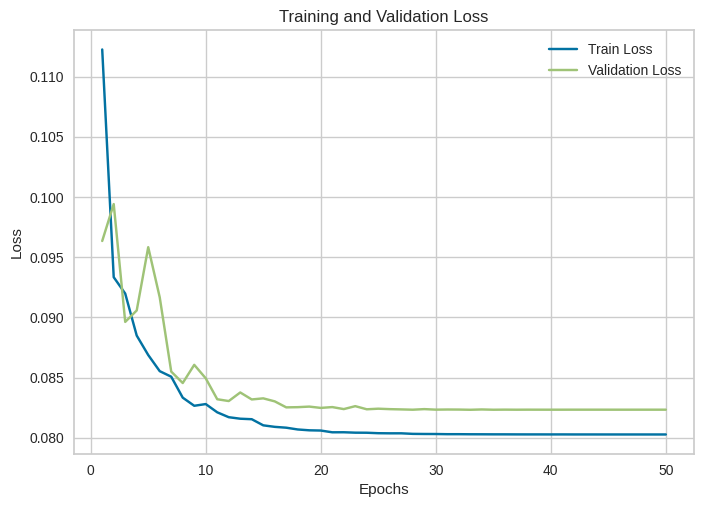

Epoch 10/50 | Train Loss: 0.08897 | Validation Loss: 0.09020
Epoch 20/50 | Train Loss: 0.08704 | Validation Loss: 0.08928
Epoch 30/50 | Train Loss: 0.08677 | Validation Loss: 0.08897
Epoch 40/50 | Train Loss: 0.08673 | Validation Loss: 0.08894
Epoch 50/50 | Train Loss: 0.08672 | Validation Loss: 0.08894
dataset_wp Finish


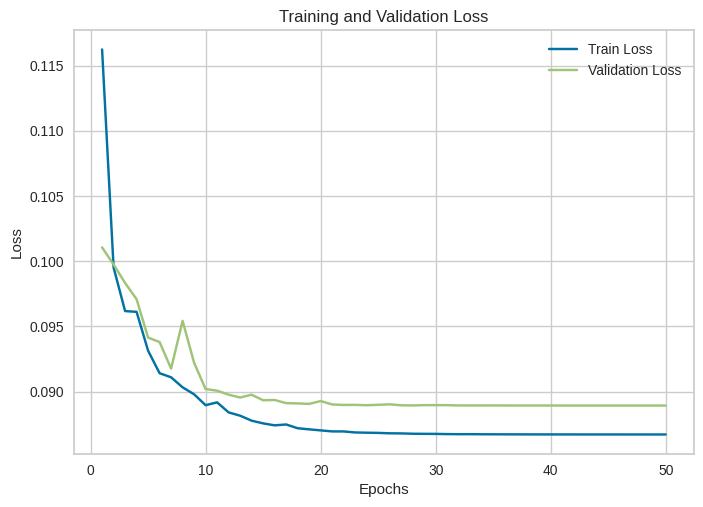

Epoch 10/50 | Train Loss: 0.07253 | Validation Loss: 0.07347
Epoch 20/50 | Train Loss: 0.07037 | Validation Loss: 0.07291
Epoch 30/50 | Train Loss: 0.06991 | Validation Loss: 0.07266
Epoch 40/50 | Train Loss: 0.06995 | Validation Loss: 0.07270
Epoch 50/50 | Train Loss: 0.06992 | Validation Loss: 0.07270
dataset_outliers Finish


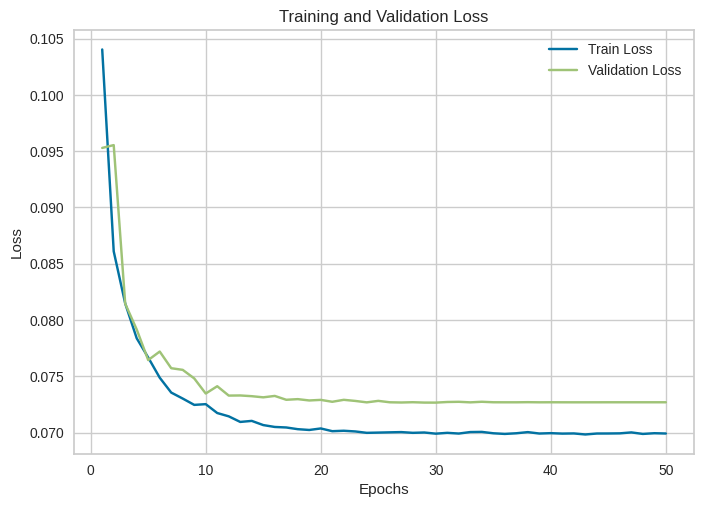

Epoch 10/50 | Train Loss: 0.08110 | Validation Loss: 0.08040
Epoch 20/50 | Train Loss: 0.07890 | Validation Loss: 0.07865
Epoch 30/50 | Train Loss: 0.07861 | Validation Loss: 0.07853
Epoch 40/50 | Train Loss: 0.07861 | Validation Loss: 0.07850
Epoch 50/50 | Train Loss: 0.07859 | Validation Loss: 0.07850
dataset_wp_outliers Finish


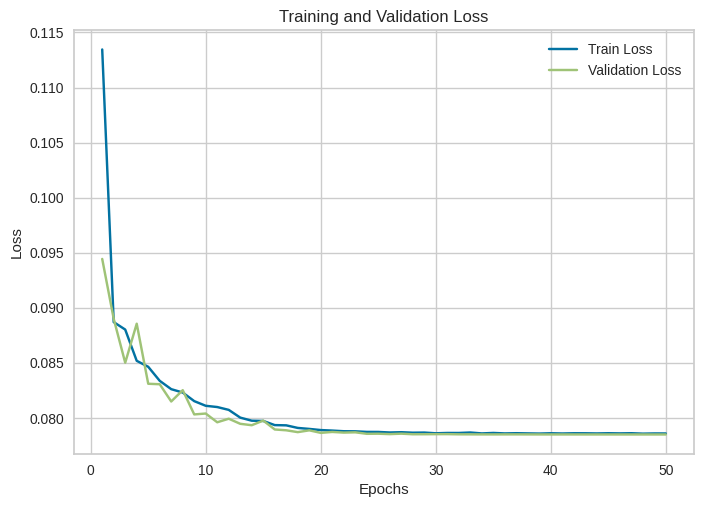

Epoch 10/50 | Train Loss: 0.07941 | Validation Loss: 0.07822
Epoch 20/50 | Train Loss: 0.07651 | Validation Loss: 0.07657
Epoch 30/50 | Train Loss: 0.07606 | Validation Loss: 0.07600
Epoch 40/50 | Train Loss: 0.07606 | Validation Loss: 0.07600
Epoch 50/50 | Train Loss: 0.07604 | Validation Loss: 0.07600
dataset_isolation Finish


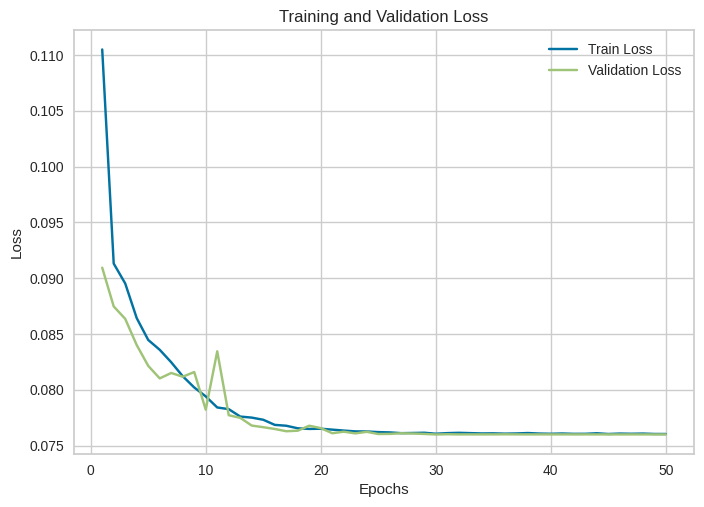

Epoch 10/50 | Train Loss: 0.08728 | Validation Loss: 0.08882
Epoch 20/50 | Train Loss: 0.08541 | Validation Loss: 0.08622
Epoch 30/50 | Train Loss: 0.08522 | Validation Loss: 0.08622
Epoch 40/50 | Train Loss: 0.08514 | Validation Loss: 0.08621
Epoch 50/50 | Train Loss: 0.08520 | Validation Loss: 0.08620
dataset_wp_isolation Finish


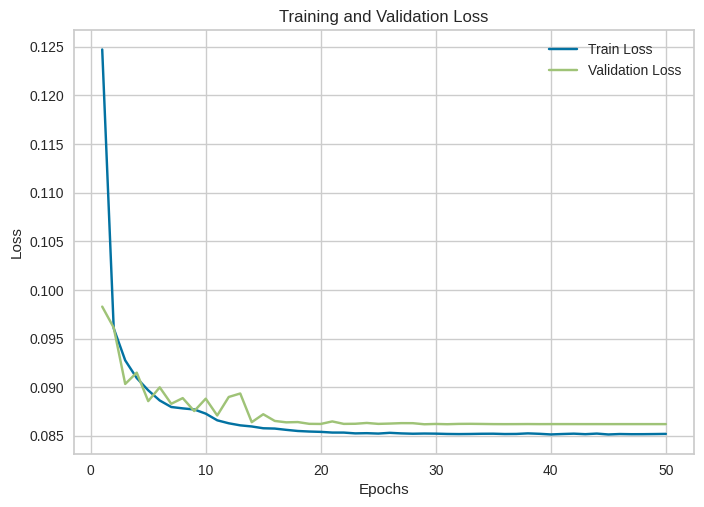

Epoch 10/50 | Train Loss: 0.08266 | Validation Loss: 0.08500
Epoch 20/50 | Train Loss: 0.07994 | Validation Loss: 0.08260
Epoch 30/50 | Train Loss: 0.07960 | Validation Loss: 0.08236
Epoch 40/50 | Train Loss: 0.07956 | Validation Loss: 0.08235
Epoch 50/50 | Train Loss: 0.07955 | Validation Loss: 0.08234
dataset_log Finish


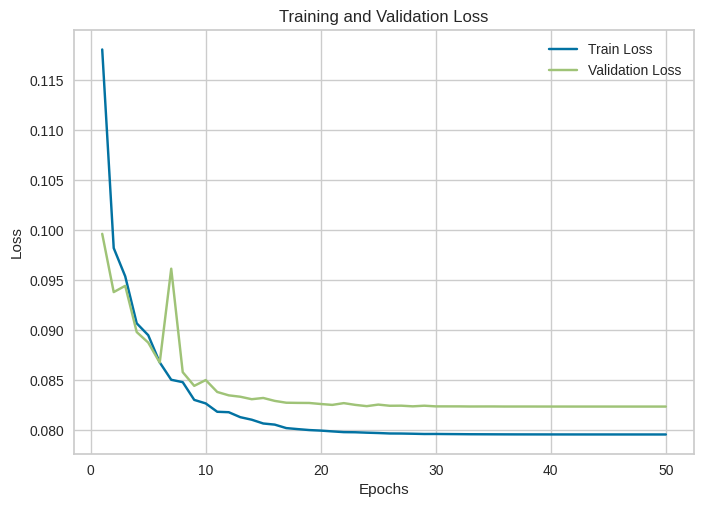

Epoch 10/50 | Train Loss: 0.09211 | Validation Loss: 0.08593
Epoch 20/50 | Train Loss: 0.09000 | Validation Loss: 0.08458
Epoch 30/50 | Train Loss: 0.08970 | Validation Loss: 0.08438
Epoch 40/50 | Train Loss: 0.08966 | Validation Loss: 0.08437
Epoch 50/50 | Train Loss: 0.08965 | Validation Loss: 0.08437
dataset_wp_log Finish


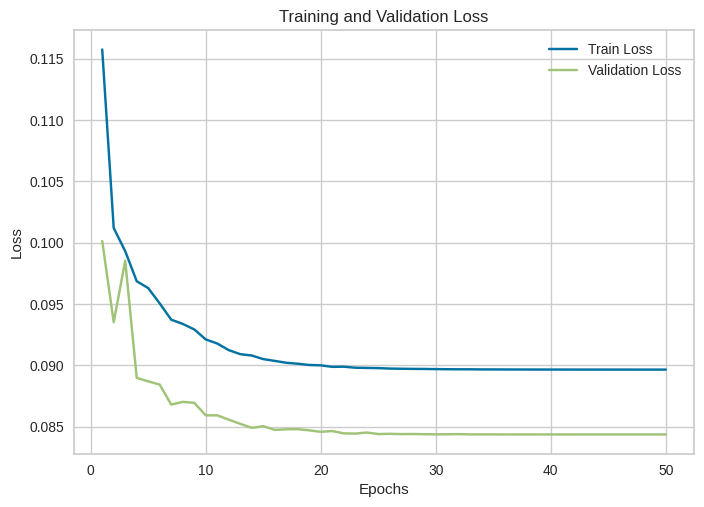

Epoch 10/50 | Train Loss: 0.09927 | Validation Loss: 0.08965
Epoch 20/50 | Train Loss: 0.09629 | Validation Loss: 0.08764
Epoch 30/50 | Train Loss: 0.09558 | Validation Loss: 0.08705
Epoch 40/50 | Train Loss: 0.09593 | Validation Loss: 0.08709
Early stopping triggered after 48 epochs with no improvement.
dataset_sample Finish


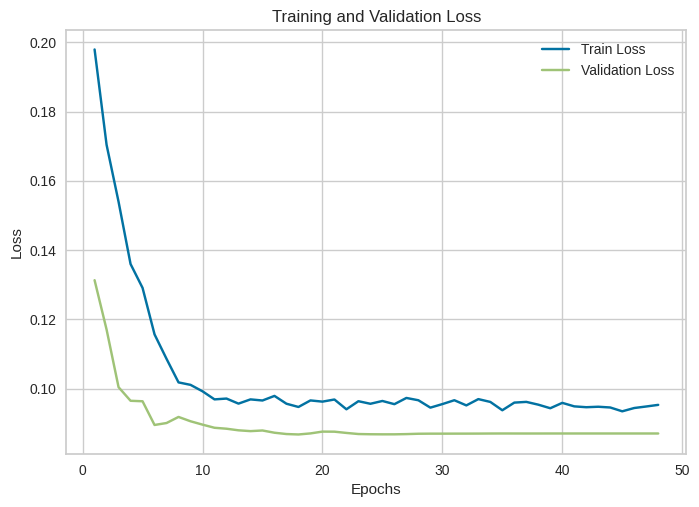

Epoch 10/50 | Train Loss: 0.10463 | Validation Loss: 0.10488
Epoch 20/50 | Train Loss: 0.10340 | Validation Loss: 0.10402
Epoch 30/50 | Train Loss: 0.10318 | Validation Loss: 0.10392
Epoch 40/50 | Train Loss: 0.10316 | Validation Loss: 0.10392
Epoch 50/50 | Train Loss: 0.10316 | Validation Loss: 0.10392
dataset_l Finish


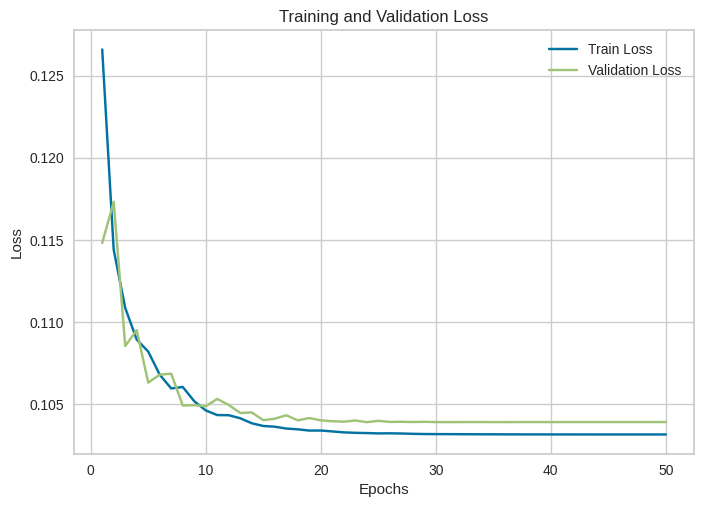

Epoch 10/50 | Train Loss: 0.10480 | Validation Loss: 0.10626
Epoch 20/50 | Train Loss: 0.10294 | Validation Loss: 0.10493
Epoch 30/50 | Train Loss: 0.10277 | Validation Loss: 0.10473
Epoch 40/50 | Train Loss: 0.10275 | Validation Loss: 0.10473
Epoch 50/50 | Train Loss: 0.10274 | Validation Loss: 0.10473
dataset_wp_l Finish


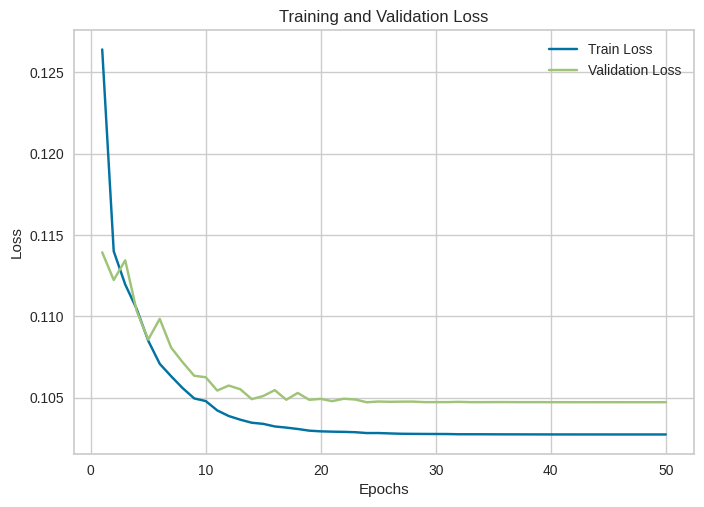

Epoch 10/50 | Train Loss: 0.09693 | Validation Loss: 0.09649
Epoch 20/50 | Train Loss: 0.09547 | Validation Loss: 0.09558
Epoch 30/50 | Train Loss: 0.09537 | Validation Loss: 0.09555
Epoch 40/50 | Train Loss: 0.09532 | Validation Loss: 0.09554
Epoch 50/50 | Train Loss: 0.09537 | Validation Loss: 0.09554
dataset_outliers_l Finish


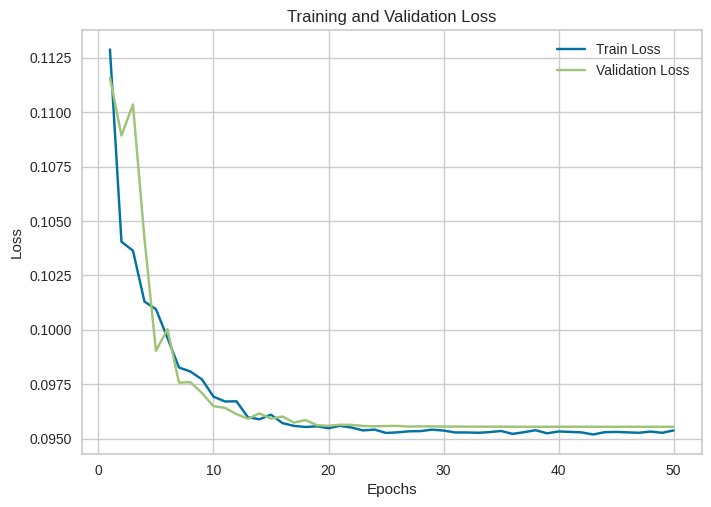

Epoch 10/50 | Train Loss: 0.09573 | Validation Loss: 0.09855
Epoch 20/50 | Train Loss: 0.09403 | Validation Loss: 0.09689
Epoch 30/50 | Train Loss: 0.09386 | Validation Loss: 0.09679
Epoch 40/50 | Train Loss: 0.09385 | Validation Loss: 0.09679
Epoch 50/50 | Train Loss: 0.09383 | Validation Loss: 0.09679
dataset_wp_outliers_l Finish


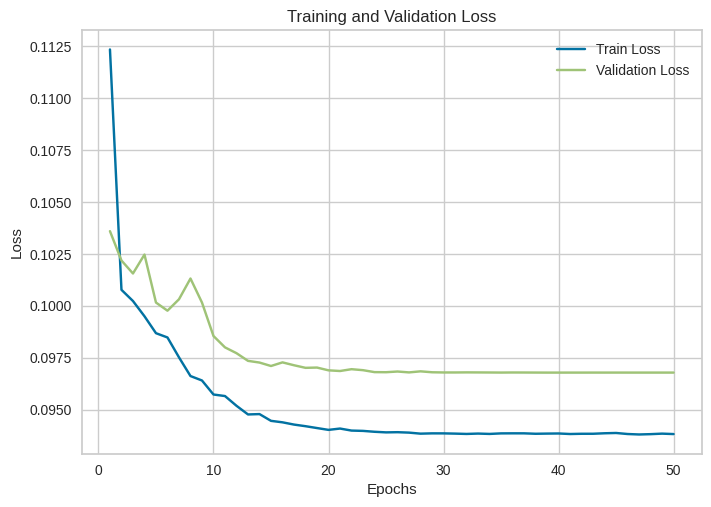

Epoch 10/50 | Train Loss: 0.10458 | Validation Loss: 0.10665
Epoch 20/50 | Train Loss: 0.10295 | Validation Loss: 0.10531
Epoch 30/50 | Train Loss: 0.10266 | Validation Loss: 0.10523
Epoch 40/50 | Train Loss: 0.10269 | Validation Loss: 0.10521
Epoch 50/50 | Train Loss: 0.10264 | Validation Loss: 0.10521
dataset_isolation_l Finish


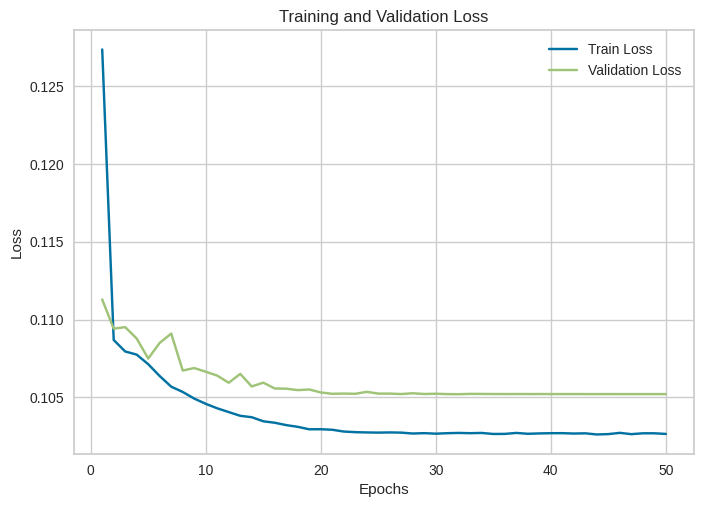

Epoch 10/50 | Train Loss: 0.10308 | Validation Loss: 0.10436
Epoch 20/50 | Train Loss: 0.10140 | Validation Loss: 0.10306
Epoch 30/50 | Train Loss: 0.10109 | Validation Loss: 0.10294
Epoch 40/50 | Train Loss: 0.10103 | Validation Loss: 0.10292
Epoch 50/50 | Train Loss: 0.10109 | Validation Loss: 0.10292
dataset_wp_isolation_l Finish


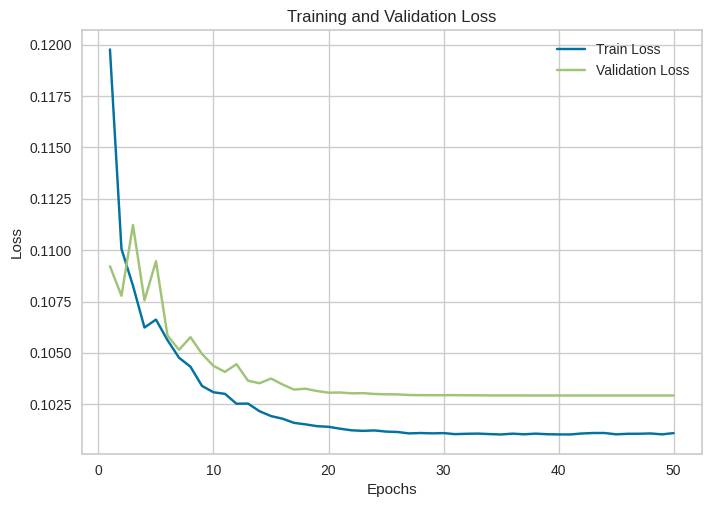

Epoch 10/50 | Train Loss: 0.10897 | Validation Loss: 0.10735
Epoch 20/50 | Train Loss: 0.10684 | Validation Loss: 0.10641
Epoch 30/50 | Train Loss: 0.10660 | Validation Loss: 0.10627
Epoch 40/50 | Train Loss: 0.10657 | Validation Loss: 0.10626
Epoch 50/50 | Train Loss: 0.10656 | Validation Loss: 0.10626
dataset_log_l Finish


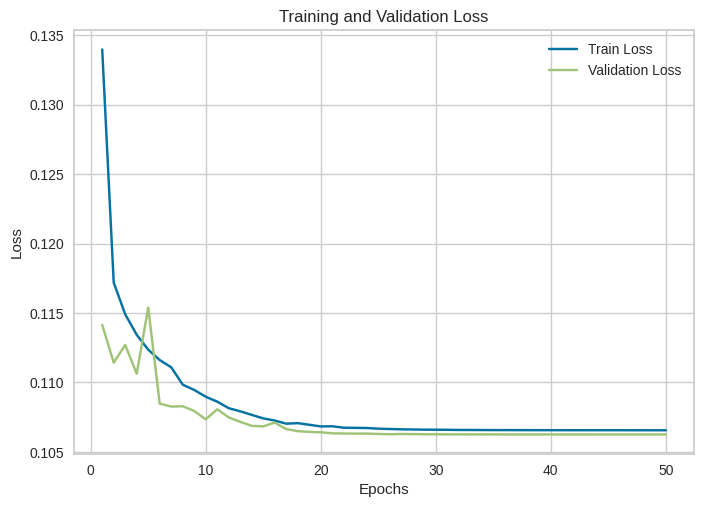

Epoch 10/50 | Train Loss: 0.10852 | Validation Loss: 0.10882
Epoch 20/50 | Train Loss: 0.10627 | Validation Loss: 0.10700
Epoch 30/50 | Train Loss: 0.10600 | Validation Loss: 0.10683
Epoch 40/50 | Train Loss: 0.10596 | Validation Loss: 0.10681
Epoch 50/50 | Train Loss: 0.10596 | Validation Loss: 0.10681
dataset_wp_log_l Finish


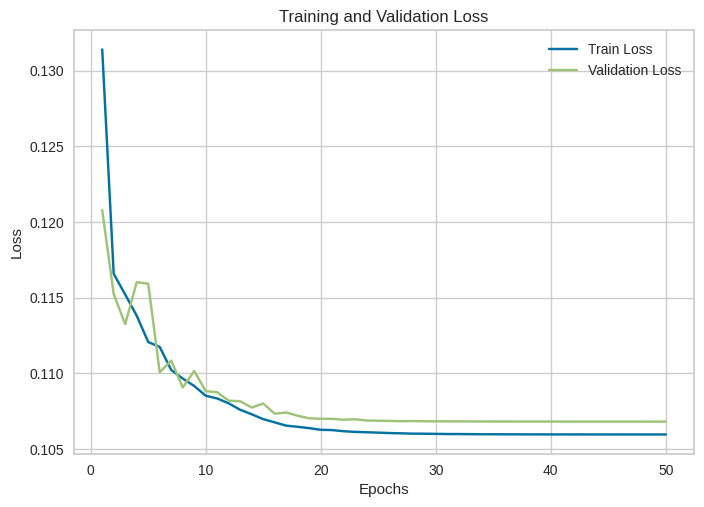

Epoch 10/50 | Train Loss: 0.12888 | Validation Loss: 0.16153
Epoch 20/50 | Train Loss: 0.12446 | Validation Loss: 0.15724
Epoch 30/50 | Train Loss: 0.11783 | Validation Loss: 0.15685
Epoch 40/50 | Train Loss: 0.14422 | Validation Loss: 0.15682
Epoch 50/50 | Train Loss: 0.14027 | Validation Loss: 0.15682
dataset_representative Finish


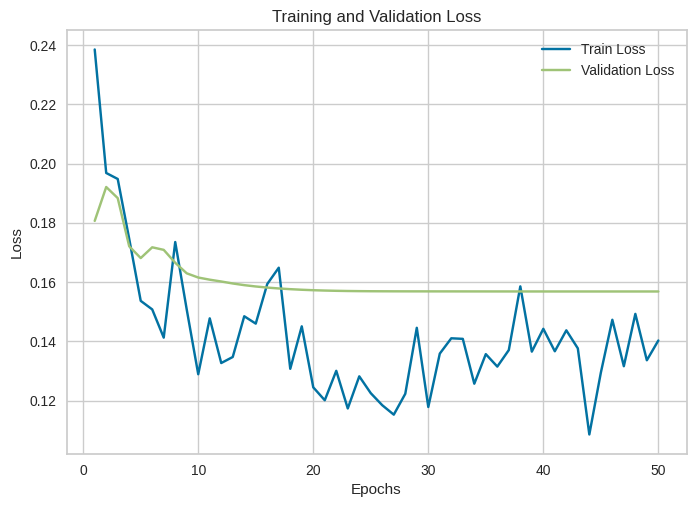

Epoch 10/50 | Train Loss: 0.13544 | Validation Loss: 0.18382
Epoch 20/50 | Train Loss: 0.12227 | Validation Loss: 0.17985
Epoch 30/50 | Train Loss: 0.13502 | Validation Loss: 0.17953
Epoch 40/50 | Train Loss: 0.12284 | Validation Loss: 0.17950
Epoch 50/50 | Train Loss: 0.12975 | Validation Loss: 0.17950
dataset_outliers_representative Finish


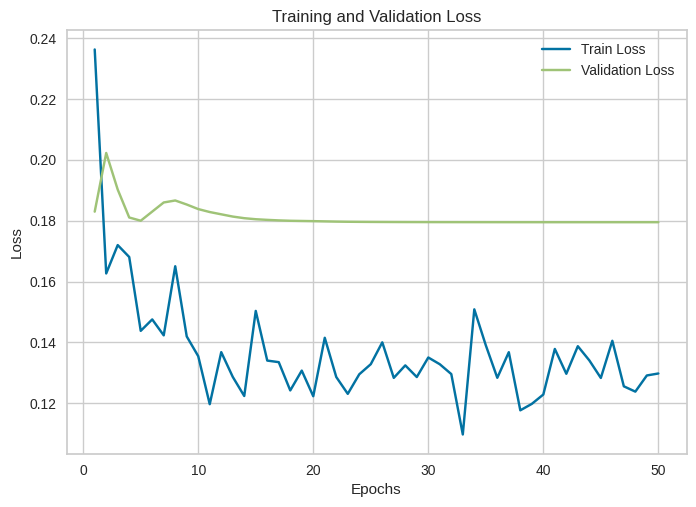

Epoch 10/50 | Train Loss: 0.10897 | Validation Loss: 0.10711
Epoch 20/50 | Train Loss: 0.10766 | Validation Loss: 0.10618
Epoch 30/50 | Train Loss: 0.10748 | Validation Loss: 0.10615
Epoch 40/50 | Train Loss: 0.10750 | Validation Loss: 0.10616
Epoch 50/50 | Train Loss: 0.10747 | Validation Loss: 0.10616
dataset_isolation_l_generated Finish


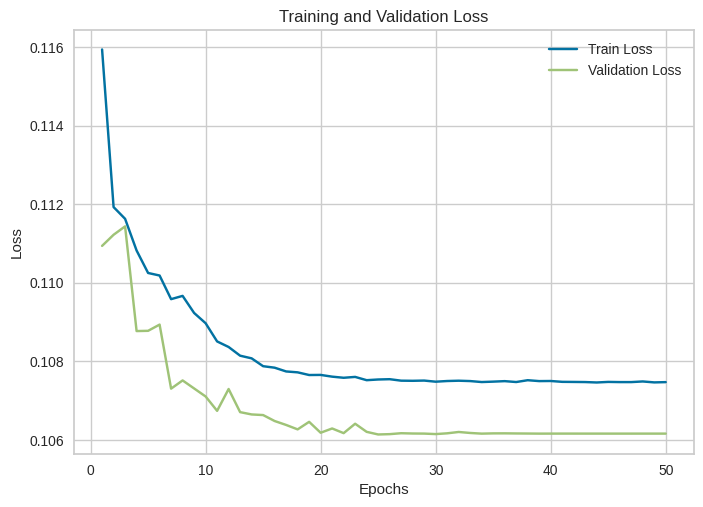

Epoch 10/50 | Train Loss: 0.09464 | Validation Loss: 0.09563
Epoch 20/50 | Train Loss: 0.09340 | Validation Loss: 0.09447
Epoch 30/50 | Train Loss: 0.09327 | Validation Loss: 0.09442
Epoch 40/50 | Train Loss: 0.09323 | Validation Loss: 0.09442
Epoch 50/50 | Train Loss: 0.09325 | Validation Loss: 0.09442
dataset_isolation_generated Finish


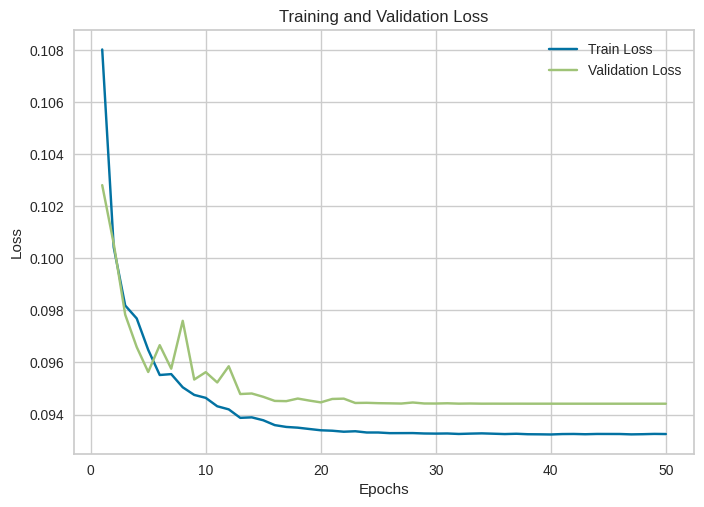

Epoch 10/50 | Train Loss: 0.08892 | Validation Loss: 0.08894
Epoch 20/50 | Train Loss: 0.08804 | Validation Loss: 0.08731
Epoch 30/50 | Train Loss: 0.08793 | Validation Loss: 0.08723
Epoch 40/50 | Train Loss: 0.08794 | Validation Loss: 0.08722
Epoch 50/50 | Train Loss: 0.08791 | Validation Loss: 0.08722
dataset_outliers_generated Finish


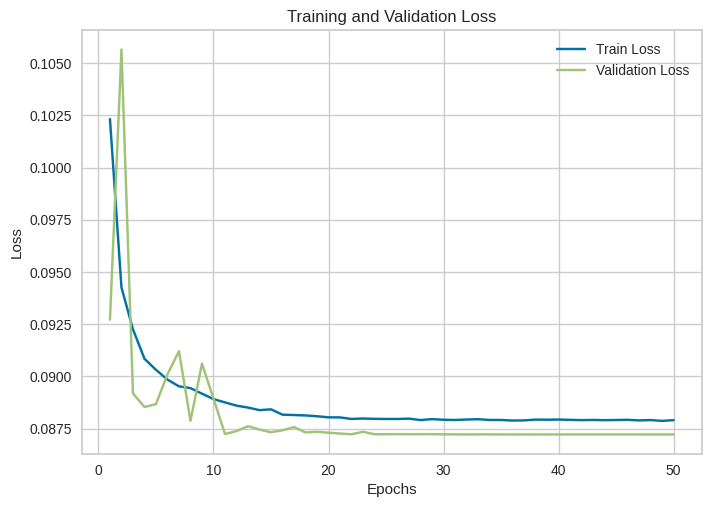

Epoch 10/50 | Train Loss: 0.10143 | Validation Loss: 0.10127
Epoch 20/50 | Train Loss: 0.10080 | Validation Loss: 0.10063
Epoch 30/50 | Train Loss: 0.10068 | Validation Loss: 0.10061
Epoch 40/50 | Train Loss: 0.10072 | Validation Loss: 0.10060
Epoch 50/50 | Train Loss: 0.10070 | Validation Loss: 0.10060
dataset_outliers_l_generated Finish


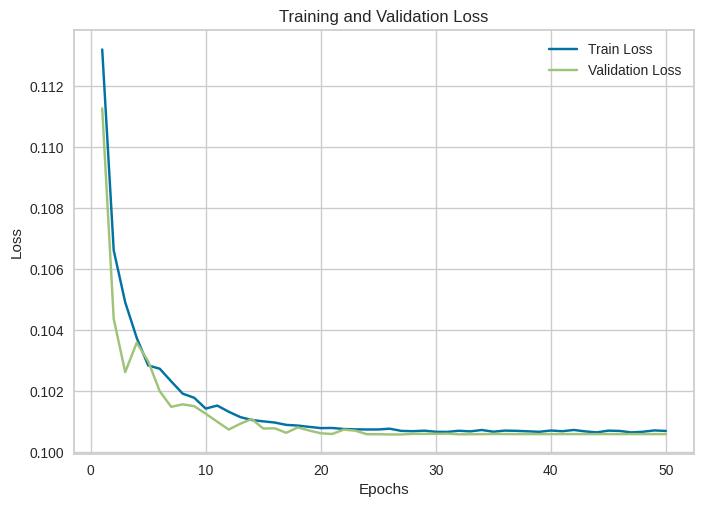

Epoch 10/50 | Train Loss: 0.11020 | Validation Loss: 0.10869
Epoch 20/50 | Train Loss: 0.10928 | Validation Loss: 0.10843
Epoch 30/50 | Train Loss: 0.10914 | Validation Loss: 0.10836
Epoch 40/50 | Train Loss: 0.10913 | Validation Loss: 0.10835
Epoch 50/50 | Train Loss: 0.10912 | Validation Loss: 0.10835
dataset_reduce_l Finish


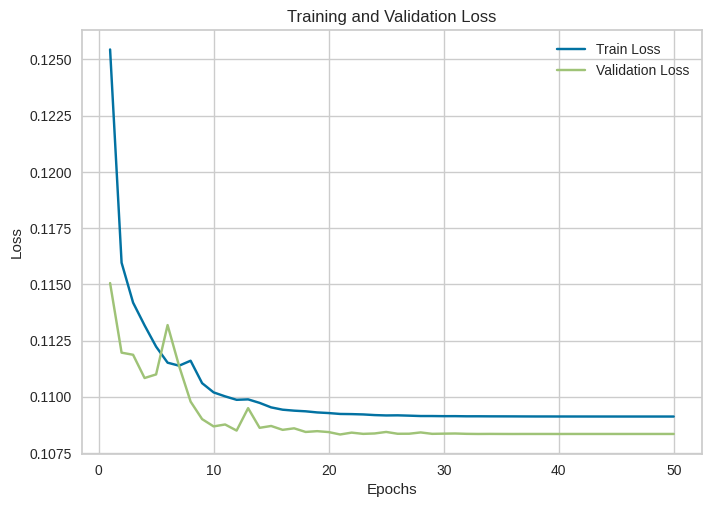

Epoch 10/50 | Train Loss: 0.09798 | Validation Loss: 0.09368
Epoch 20/50 | Train Loss: 0.09682 | Validation Loss: 0.09241
Epoch 30/50 | Train Loss: 0.09671 | Validation Loss: 0.09237
Epoch 40/50 | Train Loss: 0.09670 | Validation Loss: 0.09237
Epoch 50/50 | Train Loss: 0.09668 | Validation Loss: 0.09237
dataset_reduce_outliers_l Finish


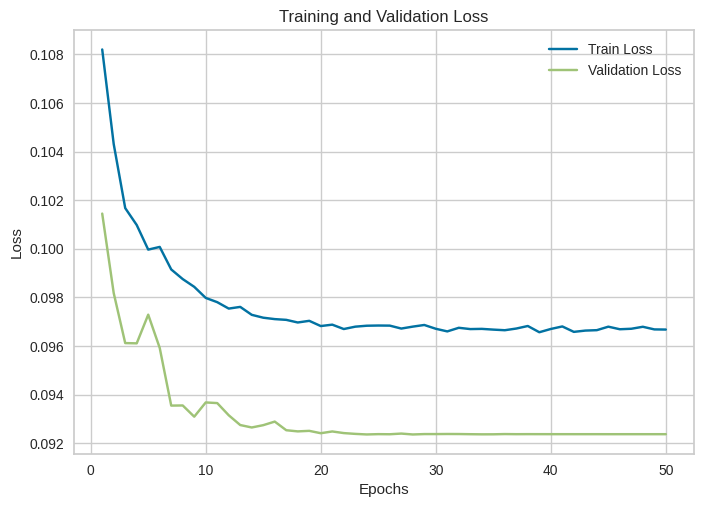

Epoch 10/50 | Train Loss: 0.10351 | Validation Loss: 0.10372
Epoch 20/50 | Train Loss: 0.10202 | Validation Loss: 0.10245
Epoch 30/50 | Train Loss: 0.10191 | Validation Loss: 0.10237
Epoch 40/50 | Train Loss: 0.10178 | Validation Loss: 0.10236
Epoch 50/50 | Train Loss: 0.10179 | Validation Loss: 0.10236
dataset_reduce_isolation_l Finish


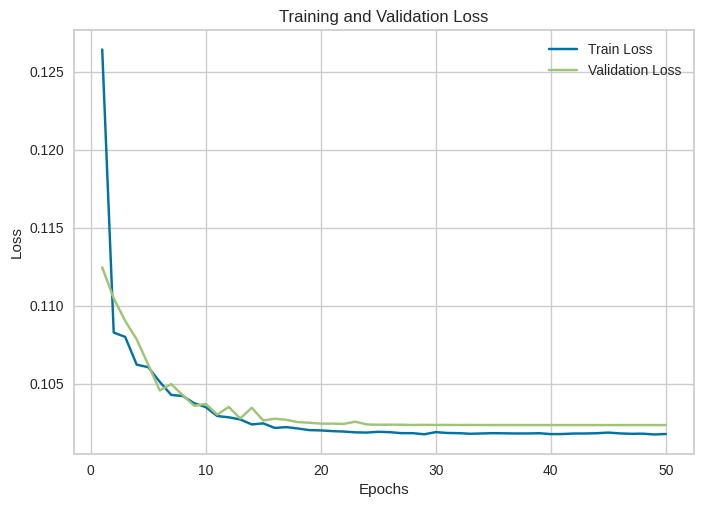

In [ ]:
# Train all datasets

model_params = [
                {"c_in": 8, "c_out": 16, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5},
                {"c_in": 16, "c_out": 32, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5}
                ,{"c_in": 32, "c_out": 64, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.4}
            ]


lr = 0.007
epochs = 50
epochs_log = 10
patience = 30
lr_decay_rate = 0.8
lr_decay_steps = 5
use_xavier_init=True

models, train_model_losses, test_model_losses, train_metrics, test_metrics = trainModels(dataLoaders,datasets_names,model_params,epochs, device, lr, epochs_log,lr_decay_rate,lr_decay_steps,patience,use_xavier_init)

In [ ]:
train_metrics

,Dataset,loss
0,dataset,0.080270
1,dataset_wp,0.086723
2,dataset_outliers,0.069920
3,dataset_wp_outliers,0.078593
4,dataset_isolation,0.076039
5,dataset_wp_isolation,0.085198
6,dataset_log,0.079553
7,dataset_wp_log,0.089655
8,dataset_sample,0.095352
9,dataset_l,0.103162


In [ ]:
test_metrics

,Dataset,loss
0,dataset,0.082329
1,dataset_wp,0.088940
2,dataset_outliers,0.072695
3,dataset_wp_outliers,0.078501
4,dataset_isolation,0.076000
5,dataset_wp_isolation,0.086204
6,dataset_log,0.082345
7,dataset_wp_log,0.084368
8,dataset_sample,0.087095
9,dataset_l,0.103918


# Cross-validation

In [ ]:
# Reset weights of my models
def reset_weights(m):
  if type(m) == nn.Linear:
      nn.init.normal_(m.weight, std=0.01)

def crossValidationDeepLearning(n_splits, lr, epochs, epochs_log, patience, lr_decay_rate, lr_decay_steps, batch_size, folds, df,model):

    kfold=KFold(n_splits=5,shuffle=True)

    loss = []


    for fold,(train_idx,test_idx) in enumerate(kfold.split(k_dataset)):
      print('------------fold no---------{}----------------------'.format(fold))

      # Create de datasets
      train_subsampler = torch.utils.data.SubsetRandomSampler(train_idx)
      test_subsampler = torch.utils.data.SubsetRandomSampler(test_idx)

      # Create de dataloaders
      trainloader = torch.utils.data.DataLoader(
                      k_dataset,
                      batch_size=batch_size, sampler=train_subsampler)
      testloader = torch.utils.data.DataLoader(
                      k_dataset,
                      batch_size=batch_size, sampler=test_subsampler)

      optimizer = torch.optim.Adam(model.parameters(), lr=lr)
      criterion = torch.nn.L1Loss()

      # I readjust the weights of the kfolds, so that they do not learn
      model.apply(reset_weights)

      # Accuracy of each fold
      fold_loss = 0

      # I iterate through each epoch and pass the train_loader
      trained_model,train_losses,val_losses = fit(model, trainloader, testloader, criterion, optimizer, epochs=epochs, device=device, lr=lr, epochs_log=epochs_log, lr_decay_rate=lr_decay_rate, lr_decay_steps=lr_decay_steps, patience=patience)
      fold_loss = val_losses[len(val_losses)- 1]
      loss.append(fold_loss)

    return loss

In [ ]:
X = datasets[0].drop(["median_house_value"], axis=1).values
y = datasets[0]["median_house_value"].values

X_tensor = torch.tensor(X, dtype=torch.float32)
y_tensor = torch.tensor(y, dtype=torch.float32)

# Create the Dataset
k_dataset = torch.utils.data.TensorDataset(X_tensor, y_tensor)

lr = 0.007
epochs = 40
epochs_log = 10
patience = 30
lr_decay_rate = 0.8
lr_decay_steps = 5
batch_size= 64
folds = 5
n_splits = 5


crossLoss = crossValidationDeepLearning(n_splits,lr, epochs, epochs_log, patience, lr_decay_rate, lr_decay_steps, batch_size,folds, k_dataset, model)

------------fold no---------0----------------------
Epoch 10/40 | Train Loss: 0.09049 | Validation Loss: 0.09229
Epoch 20/40 | Train Loss: 0.08916 | Validation Loss: 0.09172
Epoch 30/40 | Train Loss: 0.08897 | Validation Loss: 0.09130
Epoch 40/40 | Train Loss: 0.08893 | Validation Loss: 0.09134
------------fold no---------1----------------------
Epoch 10/40 | Train Loss: 0.08919 | Validation Loss: 0.09180
Epoch 20/40 | Train Loss: 0.08846 | Validation Loss: 0.09044
Epoch 30/40 | Train Loss: 0.08833 | Validation Loss: 0.09024
Epoch 40/40 | Train Loss: 0.08832 | Validation Loss: 0.09042
------------fold no---------2----------------------
Epoch 10/40 | Train Loss: 0.09004 | Validation Loss: 0.08738
Epoch 20/40 | Train Loss: 0.08900 | Validation Loss: 0.08717
Epoch 30/40 | Train Loss: 0.08892 | Validation Loss: 0.08744
Epoch 40/40 | Train Loss: 0.08891 | Validation Loss: 0.08702
------------fold no---------3----------------------
Epoch 10/40 | Train Loss: 0.09007 | Validation Loss: 0.08896

In [ ]:
np.array(crossLoss).mean()

NameError: name 'crossLoss' is not defined

In [ ]:
def trainCrossValidationModels(n_splits,dfs, dfs_names,model_params,epochs,device,lr,epochs_log,lr_decay_rate,lr_decay_steps,patience, use_xavier_init,batch_size):

  kfold=KFold(n_splits=n_splits,shuffle=True)
  loss_metrics = pd.DataFrame(columns=['Dataset', 'loss'])

  for i, df in enumerate(dfs):

    loss = []

    X = df.drop(["median_house_value"], axis=1).values
    y = df["median_house_value"].values

    X_tensor = torch.tensor(X, dtype=torch.float32)
    y_tensor = torch.tensor(y, dtype=torch.float32)

    # Create the dataset
    k_dataset = torch.utils.data.TensorDataset(X_tensor, y_tensor)

    for fold,(train_idx,test_idx) in enumerate(kfold.split(k_dataset)):

      print('------------fold no---------{}----------------------'.format(fold))

      # Create the dataloaders
      train_subsampler = torch.utils.data.SubsetRandomSampler(train_idx)
      test_subsampler = torch.utils.data.SubsetRandomSampler(test_idx)

      trainloader = torch.utils.data.DataLoader(
                      k_dataset,
                      batch_size=batch_size, sampler=train_subsampler)
      testloader = torch.utils.data.DataLoader(
                      k_dataset,
                      batch_size=batch_size, sampler=test_subsampler)

      # Accuracy of each fold.
      fold_loss = 0

      iterator = iter(trainloader)
      inputs, labels = next(iterator)
      model_params[0]["c_in"] = inputs.shape[1]

      deep_model = Model(n_outputs=1, layers=model_params, use_xavier_init=use_xavier_init)

      optimizer = torch.optim.Adam(deep_model.parameters(), lr=lr)
      criterion = torch.nn.L1Loss()

      deep_model.apply(reset_weights)

      trained_model,train_losses,val_losses = fit(deep_model, trainloader, testloader, criterion, optimizer, epochs=epochs, device=device, lr=lr, epochs_log=epochs_log, lr_decay_rate=lr_decay_rate, lr_decay_steps=lr_decay_steps, patience=patience)
      fold_loss = val_losses[len(val_losses) - 1]
      graphLoss(train_losses, val_losses)
      print(dfs_names[i] + " Finish - epoch : " + " fold : " + str(fold))

      loss.append(fold_loss)

    loss_metrics.loc[len(loss_metrics)] = [dfs_names[i], np.array(loss).mean()]

  return loss_metrics


------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.08993 | Validation Loss: 0.08994
Epoch 20/60 | Train Loss: 0.08905 | Validation Loss: 0.08820
Epoch 30/60 | Train Loss: 0.08896 | Validation Loss: 0.08775
Epoch 40/60 | Train Loss: 0.08892 | Validation Loss: 0.08913
Early stopping triggered after 45 epochs with no improvement.


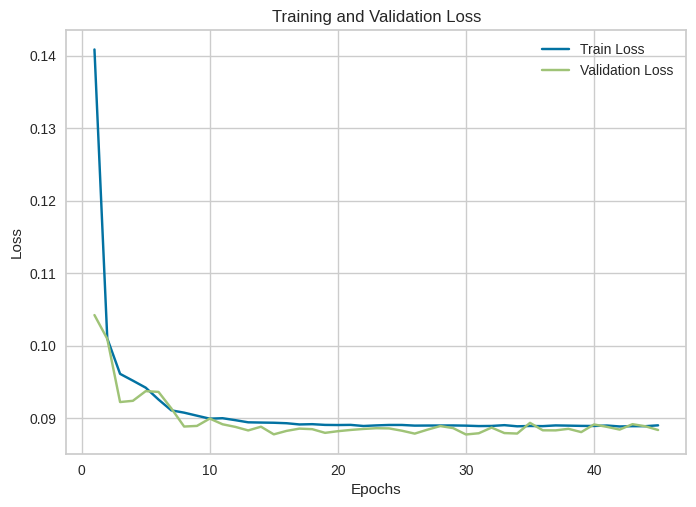

dataset Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09120 | Validation Loss: 0.08730
Epoch 20/60 | Train Loss: 0.09035 | Validation Loss: 0.08651
Epoch 30/60 | Train Loss: 0.09023 | Validation Loss: 0.08785
Early stopping triggered after 36 epochs with no improvement.


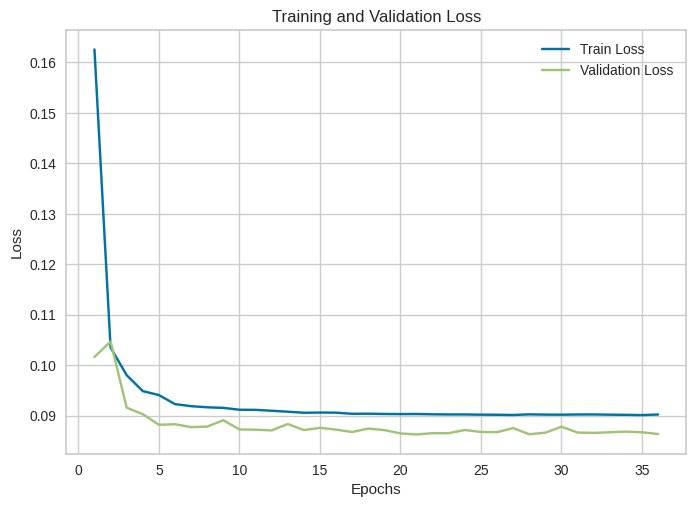

dataset Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09024 | Validation Loss: 0.09093
Epoch 20/60 | Train Loss: 0.08865 | Validation Loss: 0.08984
Epoch 30/60 | Train Loss: 0.08855 | Validation Loss: 0.08932
Epoch 40/60 | Train Loss: 0.08846 | Validation Loss: 0.08971
Epoch 50/60 | Train Loss: 0.08848 | Validation Loss: 0.08925
Epoch 60/60 | Train Loss: 0.08841 | Validation Loss: 0.09007
Early stopping triggered after 60 epochs with no improvement.


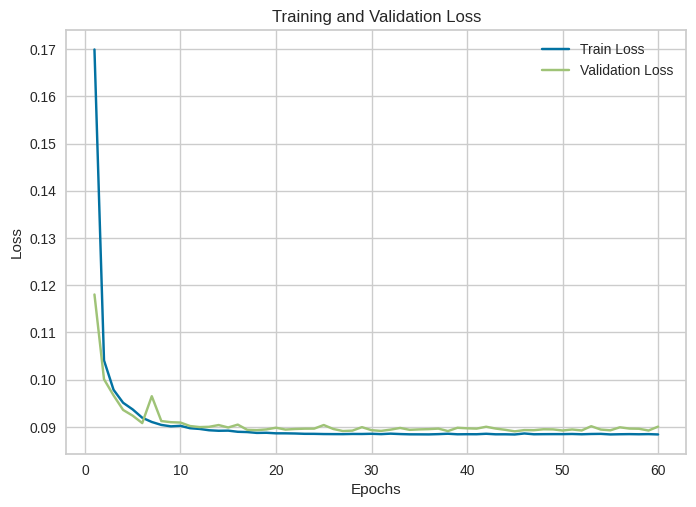

dataset Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09175 | Validation Loss: 0.09471
Epoch 20/60 | Train Loss: 0.09005 | Validation Loss: 0.09415
Epoch 30/60 | Train Loss: 0.08985 | Validation Loss: 0.09293
Early stopping triggered after 39 epochs with no improvement.


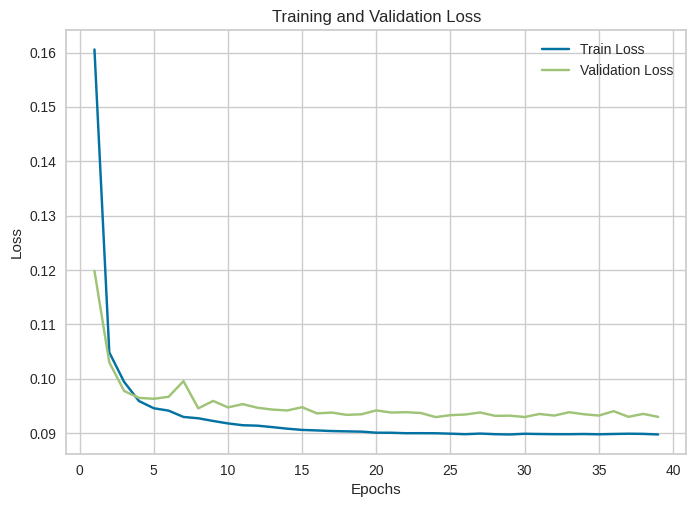

dataset Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09678 | Validation Loss: 0.09856
Epoch 20/60 | Train Loss: 0.09548 | Validation Loss: 0.09728
Epoch 30/60 | Train Loss: 0.09539 | Validation Loss: 0.09728
Epoch 40/60 | Train Loss: 0.09531 | Validation Loss: 0.09716
Epoch 50/60 | Train Loss: 0.09544 | Validation Loss: 0.09721
Early stopping triggered after 54 epochs with no improvement.


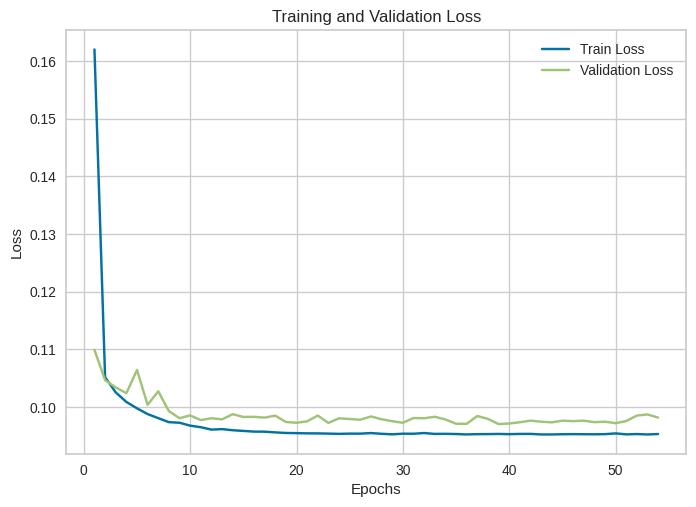

dataset_wp Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09391 | Validation Loss: 0.09150
Epoch 20/60 | Train Loss: 0.09227 | Validation Loss: 0.09025
Epoch 30/60 | Train Loss: 0.09220 | Validation Loss: 0.09022
Early stopping triggered after 36 epochs with no improvement.


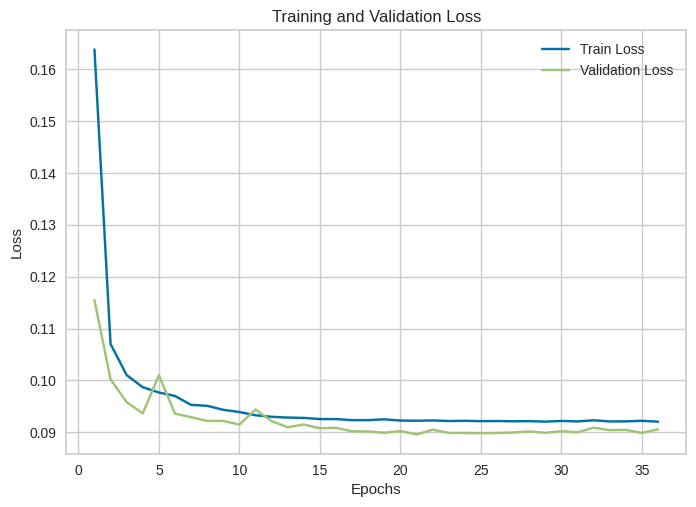

dataset_wp Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09251 | Validation Loss: 0.09394
Epoch 20/60 | Train Loss: 0.09142 | Validation Loss: 0.09409
Epoch 30/60 | Train Loss: 0.09113 | Validation Loss: 0.09361
Epoch 40/60 | Train Loss: 0.09117 | Validation Loss: 0.09362
Epoch 50/60 | Train Loss: 0.09108 | Validation Loss: 0.09342
Early stopping triggered after 50 epochs with no improvement.


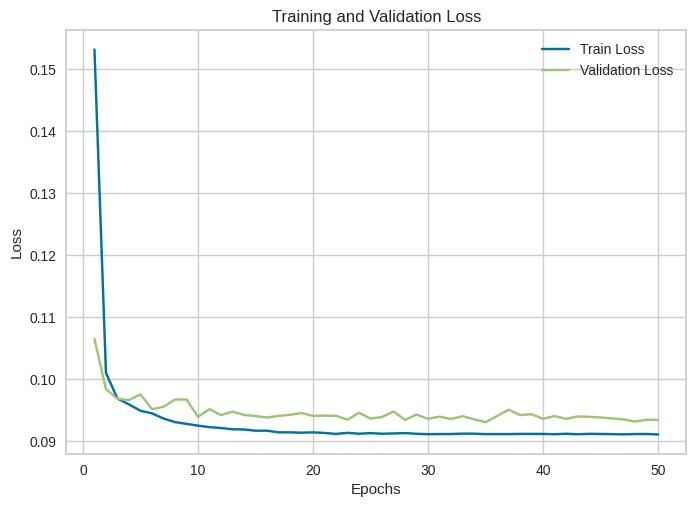

dataset_wp Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09594 | Validation Loss: 0.09765
Epoch 20/60 | Train Loss: 0.09332 | Validation Loss: 0.09200
Epoch 30/60 | Train Loss: 0.09308 | Validation Loss: 0.09160
Epoch 40/60 | Train Loss: 0.09292 | Validation Loss: 0.09167
Epoch 50/60 | Train Loss: 0.09298 | Validation Loss: 0.09115
Early stopping triggered after 50 epochs with no improvement.


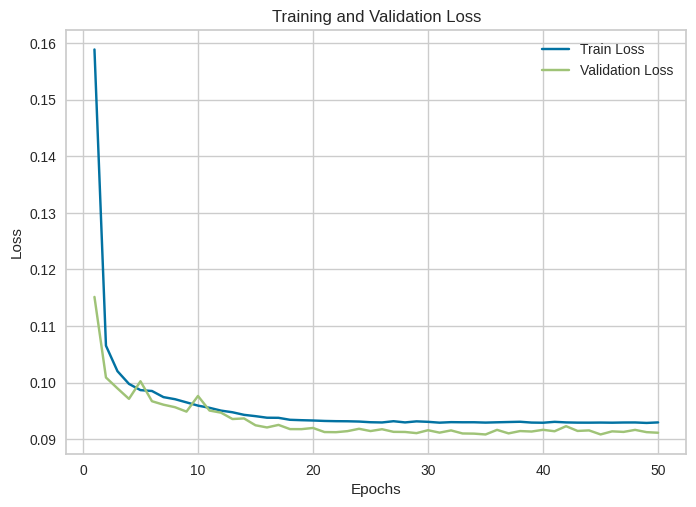

dataset_wp Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.08055 | Validation Loss: 0.08143
Epoch 20/60 | Train Loss: 0.07970 | Validation Loss: 0.07858
Epoch 30/60 | Train Loss: 0.07958 | Validation Loss: 0.07847
Early stopping triggered after 37 epochs with no improvement.


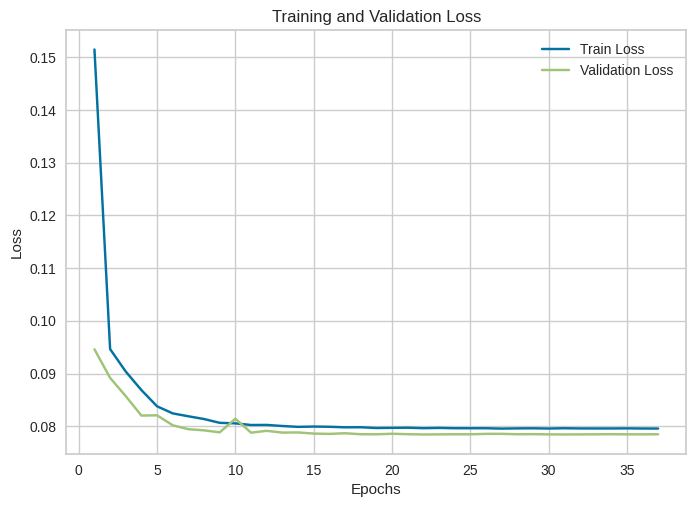

dataset_outliers Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.07827 | Validation Loss: 0.07966
Epoch 20/60 | Train Loss: 0.07695 | Validation Loss: 0.07906
Epoch 30/60 | Train Loss: 0.07677 | Validation Loss: 0.07881
Epoch 40/60 | Train Loss: 0.07673 | Validation Loss: 0.07889
Early stopping triggered after 45 epochs with no improvement.


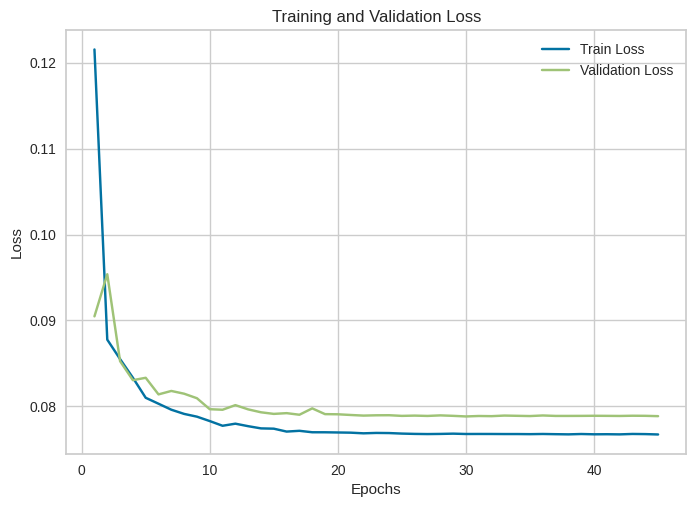

dataset_outliers Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.08188 | Validation Loss: 0.08072
Epoch 20/60 | Train Loss: 0.08088 | Validation Loss: 0.08012
Epoch 30/60 | Train Loss: 0.08076 | Validation Loss: 0.07989
Epoch 40/60 | Train Loss: 0.08071 | Validation Loss: 0.07986
Early stopping triggered after 42 epochs with no improvement.


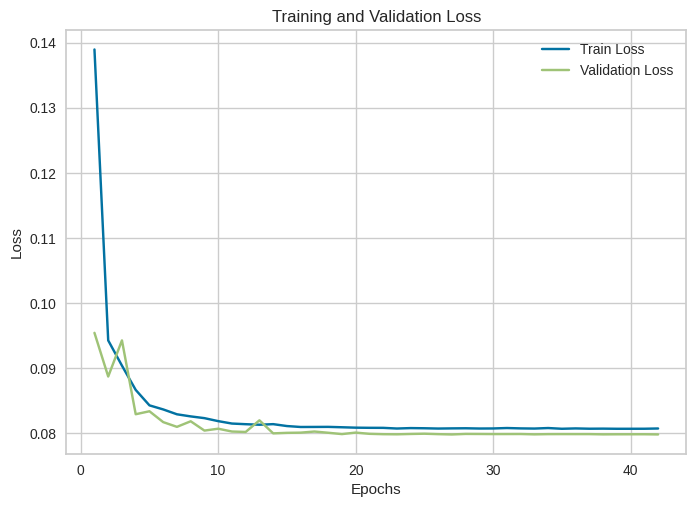

dataset_outliers Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.08233 | Validation Loss: 0.08305
Epoch 20/60 | Train Loss: 0.08130 | Validation Loss: 0.08271
Epoch 30/60 | Train Loss: 0.08119 | Validation Loss: 0.08249
Epoch 40/60 | Train Loss: 0.08118 | Validation Loss: 0.08250
Early stopping triggered after 46 epochs with no improvement.


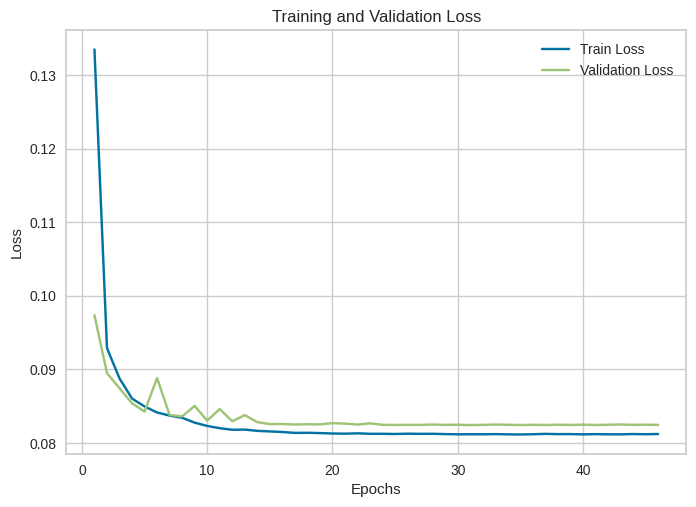

dataset_outliers Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.08405 | Validation Loss: 0.08602
Epoch 20/60 | Train Loss: 0.08334 | Validation Loss: 0.08583
Epoch 30/60 | Train Loss: 0.08321 | Validation Loss: 0.08583
Early stopping triggered after 39 epochs with no improvement.


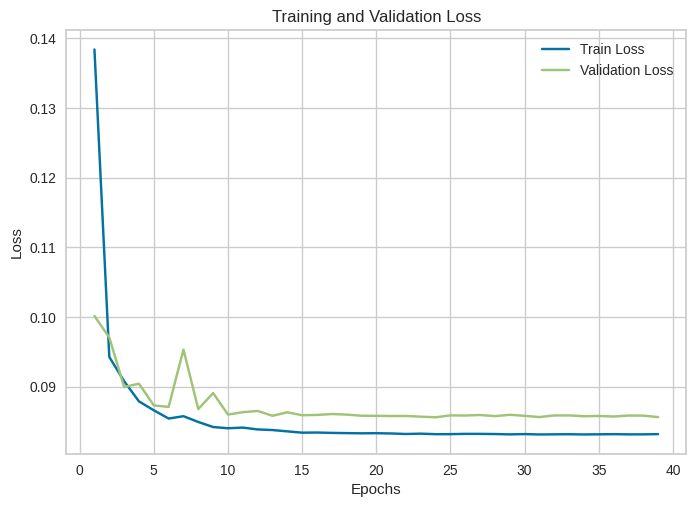

dataset_wp_outliers Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.08383 | Validation Loss: 0.08360
Epoch 20/60 | Train Loss: 0.08265 | Validation Loss: 0.08323
Epoch 30/60 | Train Loss: 0.08255 | Validation Loss: 0.08318
Epoch 40/60 | Train Loss: 0.08252 | Validation Loss: 0.08305
Epoch 50/60 | Train Loss: 0.08251 | Validation Loss: 0.08317
Early stopping triggered after 51 epochs with no improvement.


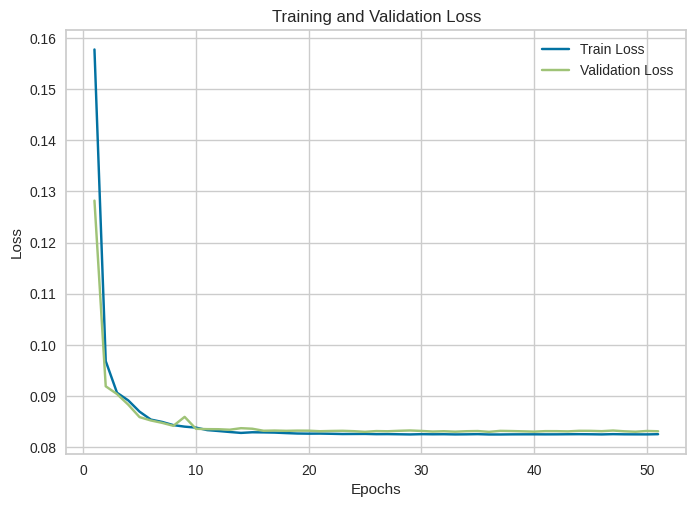

dataset_wp_outliers Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.08507 | Validation Loss: 0.08429
Epoch 20/60 | Train Loss: 0.08365 | Validation Loss: 0.08332
Epoch 30/60 | Train Loss: 0.08354 | Validation Loss: 0.08342
Epoch 40/60 | Train Loss: 0.08351 | Validation Loss: 0.08320
Epoch 50/60 | Train Loss: 0.08348 | Validation Loss: 0.08324
Early stopping triggered after 55 epochs with no improvement.


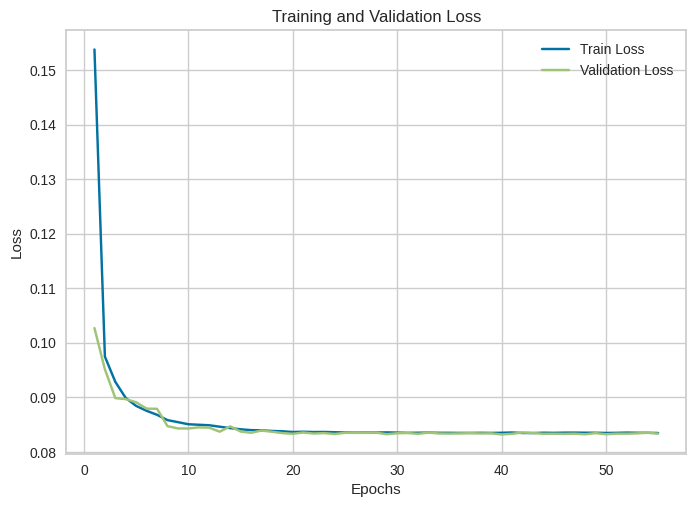

dataset_wp_outliers Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.08523 | Validation Loss: 0.08249
Epoch 20/60 | Train Loss: 0.08446 | Validation Loss: 0.08239
Epoch 30/60 | Train Loss: 0.08435 | Validation Loss: 0.08213
Epoch 40/60 | Train Loss: 0.08438 | Validation Loss: 0.08236
Epoch 50/60 | Train Loss: 0.08435 | Validation Loss: 0.08230
Early stopping triggered after 59 epochs with no improvement.


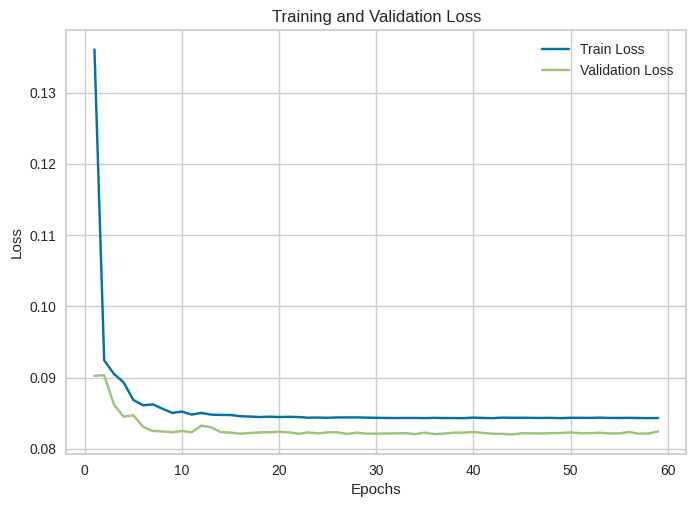

dataset_wp_outliers Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.08758 | Validation Loss: 0.08612
Epoch 20/60 | Train Loss: 0.08636 | Validation Loss: 0.08623
Epoch 30/60 | Train Loss: 0.08628 | Validation Loss: 0.08582
Early stopping triggered after 34 epochs with no improvement.


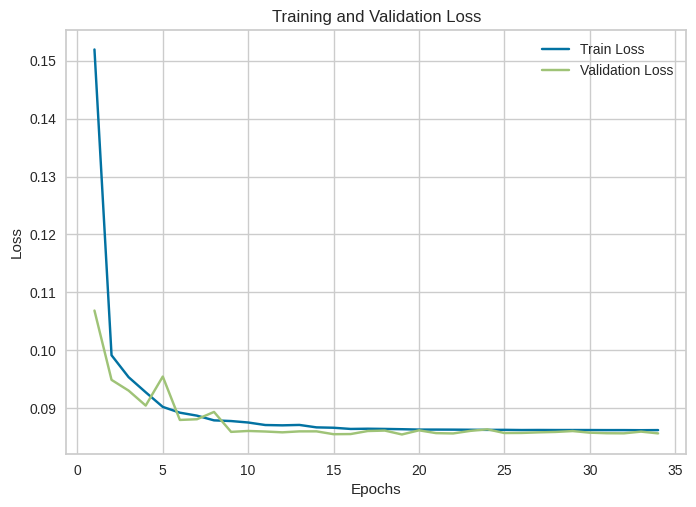

dataset_isolation Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.08658 | Validation Loss: 0.08944
Epoch 20/60 | Train Loss: 0.08578 | Validation Loss: 0.08626
Epoch 30/60 | Train Loss: 0.08563 | Validation Loss: 0.08641
Epoch 40/60 | Train Loss: 0.08562 | Validation Loss: 0.08651
Epoch 50/60 | Train Loss: 0.08562 | Validation Loss: 0.08631
Early stopping triggered after 53 epochs with no improvement.


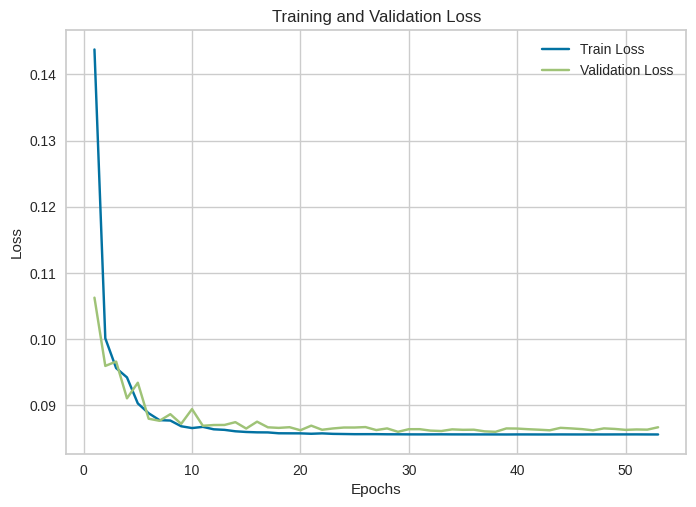

dataset_isolation Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.08600 | Validation Loss: 0.08463
Epoch 20/60 | Train Loss: 0.08503 | Validation Loss: 0.08466
Epoch 30/60 | Train Loss: 0.08489 | Validation Loss: 0.08447
Early stopping triggered after 34 epochs with no improvement.


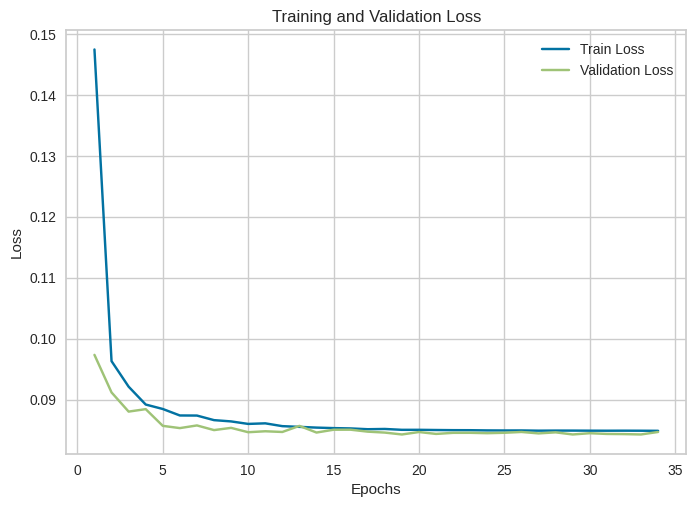

dataset_isolation Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.08519 | Validation Loss: 0.08512
Epoch 20/60 | Train Loss: 0.08445 | Validation Loss: 0.08494
Epoch 30/60 | Train Loss: 0.08434 | Validation Loss: 0.08458
Epoch 40/60 | Train Loss: 0.08432 | Validation Loss: 0.08488
Early stopping triggered after 41 epochs with no improvement.


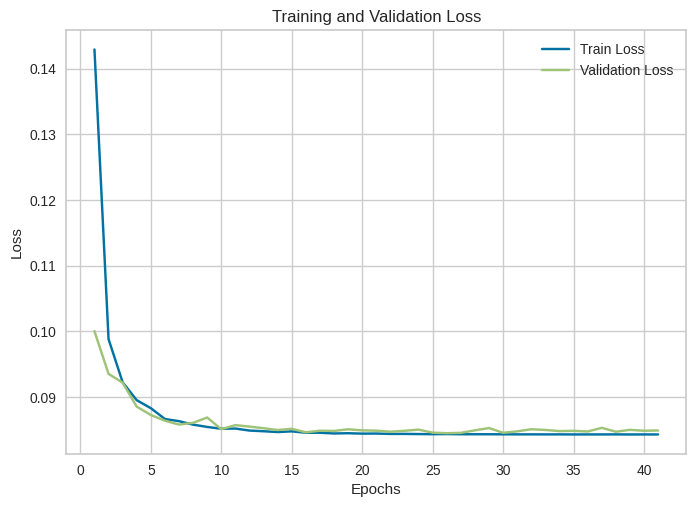

dataset_isolation Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09016 | Validation Loss: 0.09329
Epoch 20/60 | Train Loss: 0.08934 | Validation Loss: 0.09340
Epoch 30/60 | Train Loss: 0.08915 | Validation Loss: 0.09287
Epoch 40/60 | Train Loss: 0.08915 | Validation Loss: 0.09318
Early stopping triggered after 45 epochs with no improvement.


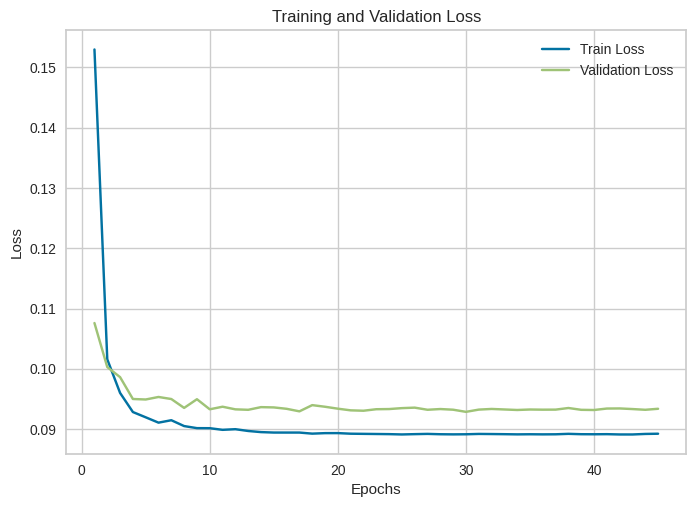

dataset_wp_isolation Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09216 | Validation Loss: 0.09250
Epoch 20/60 | Train Loss: 0.09065 | Validation Loss: 0.09149
Epoch 30/60 | Train Loss: 0.09045 | Validation Loss: 0.09116
Early stopping triggered after 39 epochs with no improvement.


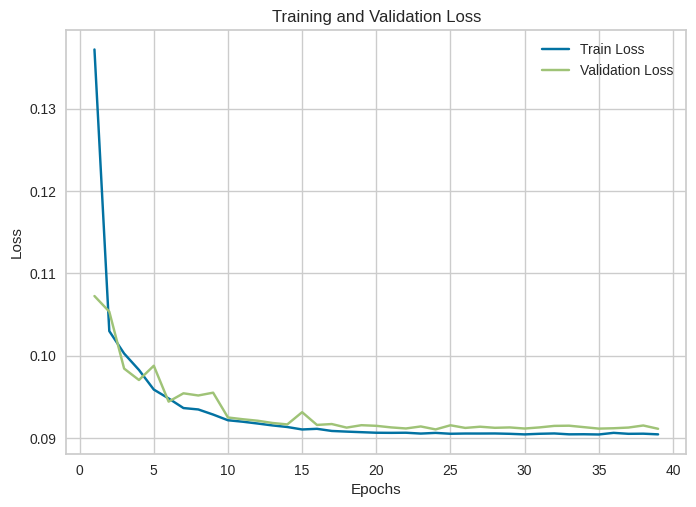

dataset_wp_isolation Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.08924 | Validation Loss: 0.08749
Epoch 20/60 | Train Loss: 0.08847 | Validation Loss: 0.08724
Epoch 30/60 | Train Loss: 0.08839 | Validation Loss: 0.08718
Early stopping triggered after 39 epochs with no improvement.


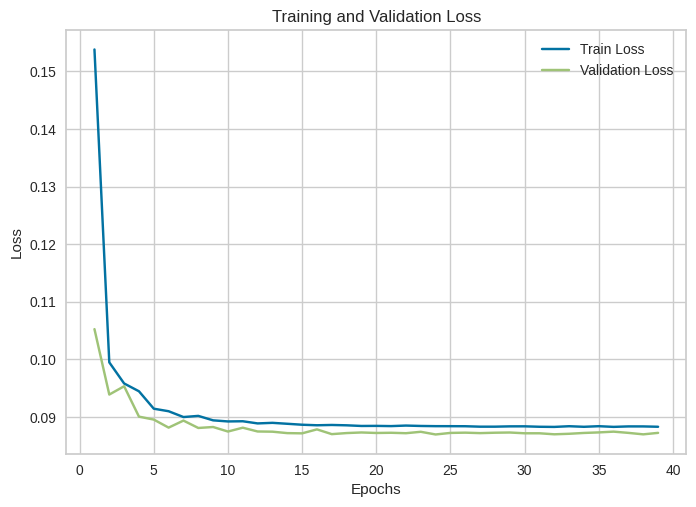

dataset_wp_isolation Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09147 | Validation Loss: 0.08845
Epoch 20/60 | Train Loss: 0.09043 | Validation Loss: 0.08740
Epoch 30/60 | Train Loss: 0.09033 | Validation Loss: 0.08738
Early stopping triggered after 39 epochs with no improvement.


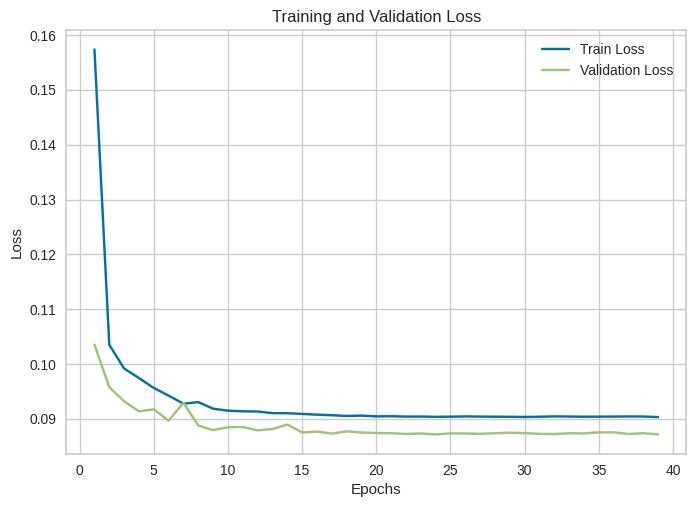

dataset_wp_isolation Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09276 | Validation Loss: 0.09424
Epoch 20/60 | Train Loss: 0.09164 | Validation Loss: 0.09087
Epoch 30/60 | Train Loss: 0.09155 | Validation Loss: 0.09182
Early stopping triggered after 33 epochs with no improvement.


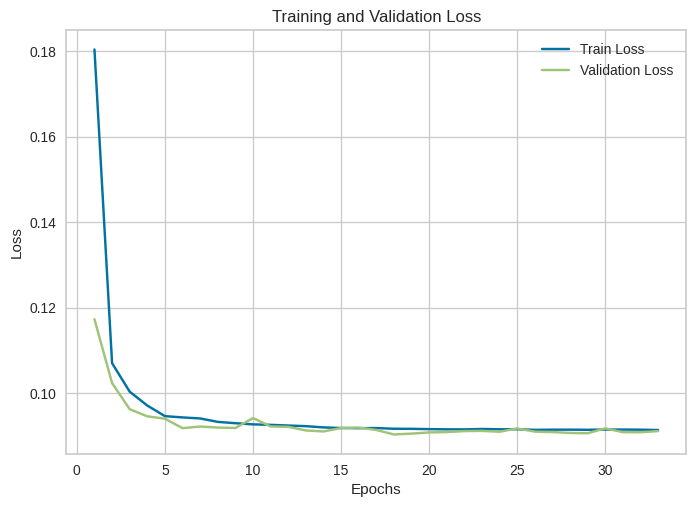

dataset_log Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09245 | Validation Loss: 0.09391
Epoch 20/60 | Train Loss: 0.09142 | Validation Loss: 0.09321
Epoch 30/60 | Train Loss: 0.09135 | Validation Loss: 0.09288
Epoch 40/60 | Train Loss: 0.09139 | Validation Loss: 0.09241
Epoch 50/60 | Train Loss: 0.09125 | Validation Loss: 0.09295
Early stopping triggered after 53 epochs with no improvement.


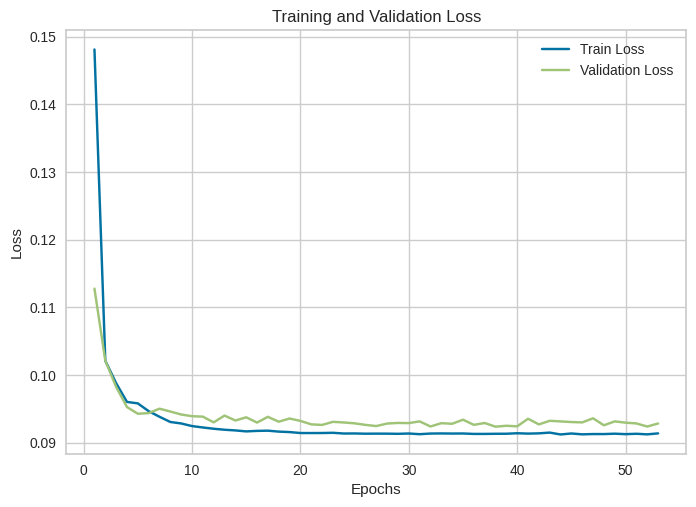

dataset_log Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09087 | Validation Loss: 0.09273
Epoch 20/60 | Train Loss: 0.08996 | Validation Loss: 0.09170
Epoch 30/60 | Train Loss: 0.08990 | Validation Loss: 0.09229
Epoch 40/60 | Train Loss: 0.08986 | Validation Loss: 0.09121
Early stopping triggered after 42 epochs with no improvement.


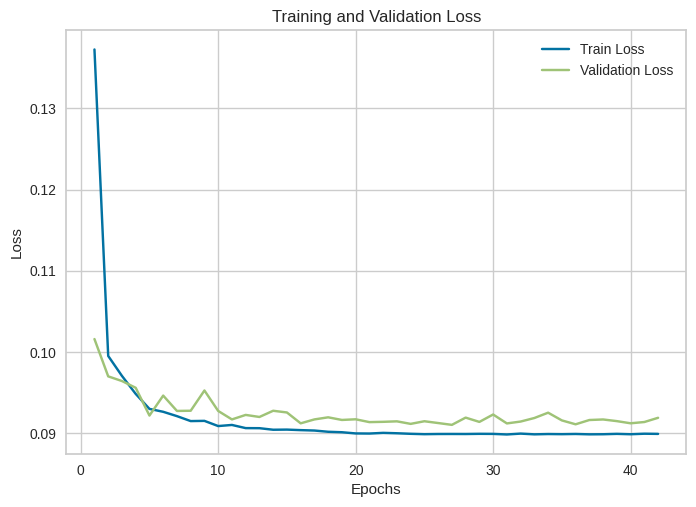

dataset_log Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09288 | Validation Loss: 0.09517
Epoch 20/60 | Train Loss: 0.09100 | Validation Loss: 0.08842
Epoch 30/60 | Train Loss: 0.09080 | Validation Loss: 0.08870
Early stopping triggered after 38 epochs with no improvement.


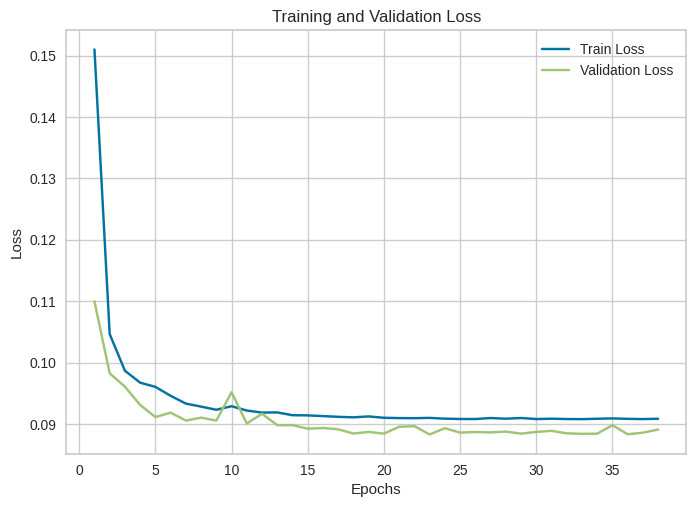

dataset_log Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09646 | Validation Loss: 0.09403
Epoch 20/60 | Train Loss: 0.09536 | Validation Loss: 0.09311
Epoch 30/60 | Train Loss: 0.09505 | Validation Loss: 0.09352
Early stopping triggered after 35 epochs with no improvement.


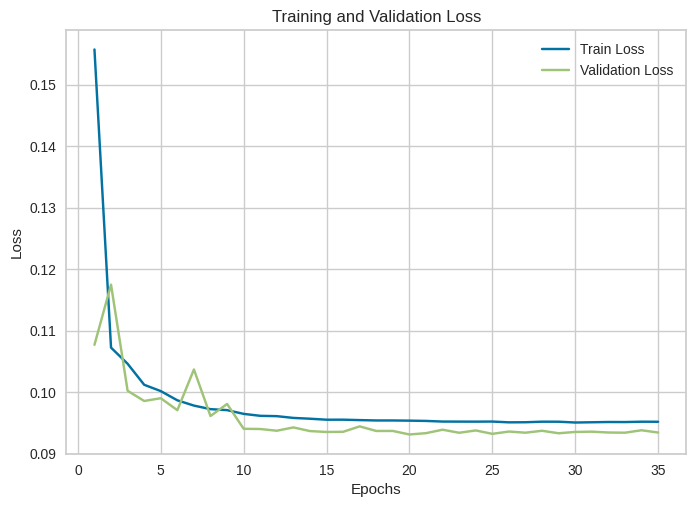

dataset_wp_log Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09757 | Validation Loss: 0.09730
Epoch 20/60 | Train Loss: 0.09643 | Validation Loss: 0.09686
Epoch 30/60 | Train Loss: 0.09625 | Validation Loss: 0.09671
Epoch 40/60 | Train Loss: 0.09634 | Validation Loss: 0.09629
Epoch 50/60 | Train Loss: 0.09620 | Validation Loss: 0.09619
Early stopping triggered after 52 epochs with no improvement.


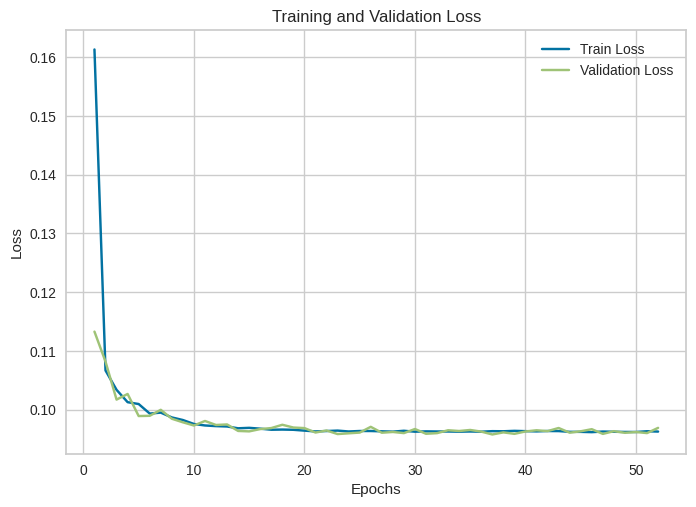

dataset_wp_log Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09301 | Validation Loss: 0.09584
Epoch 20/60 | Train Loss: 0.09167 | Validation Loss: 0.09445
Epoch 30/60 | Train Loss: 0.09148 | Validation Loss: 0.09394
Epoch 40/60 | Train Loss: 0.09136 | Validation Loss: 0.09467
Early stopping triggered after 45 epochs with no improvement.


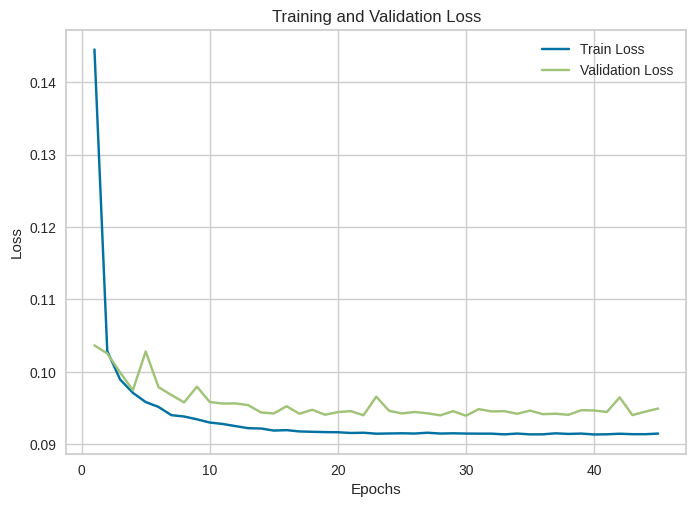

dataset_wp_log Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09567 | Validation Loss: 0.09702
Epoch 20/60 | Train Loss: 0.09478 | Validation Loss: 0.09449
Epoch 30/60 | Train Loss: 0.09457 | Validation Loss: 0.09403
Epoch 40/60 | Train Loss: 0.09459 | Validation Loss: 0.09432
Epoch 50/60 | Train Loss: 0.09455 | Validation Loss: 0.09501
Early stopping triggered after 52 epochs with no improvement.


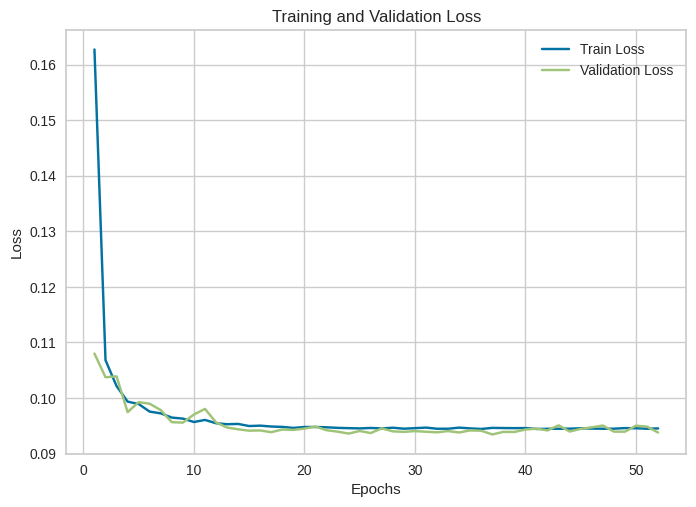

dataset_wp_log Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.17175 | Validation Loss: 0.16303
Early stopping triggered after 16 epochs with no improvement.


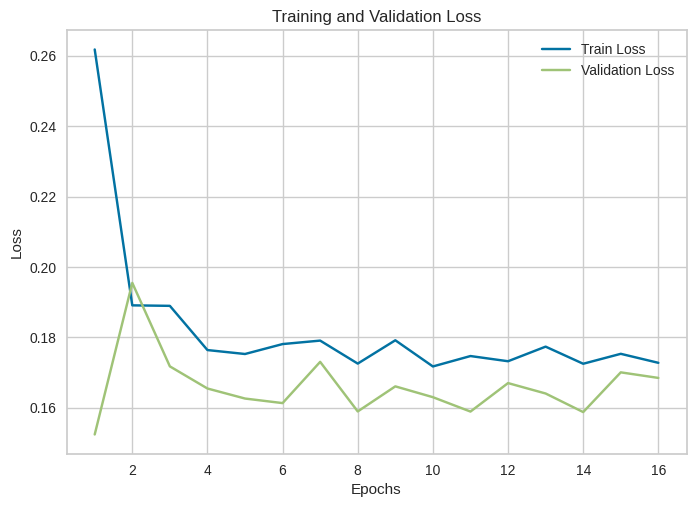

dataset_sample Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.15999 | Validation Loss: 0.21213
Epoch 20/60 | Train Loss: 0.16231 | Validation Loss: 0.19702
Epoch 30/60 | Train Loss: 0.15504 | Validation Loss: 0.20351
Epoch 40/60 | Train Loss: 0.15936 | Validation Loss: 0.20054
Early stopping triggered after 41 epochs with no improvement.


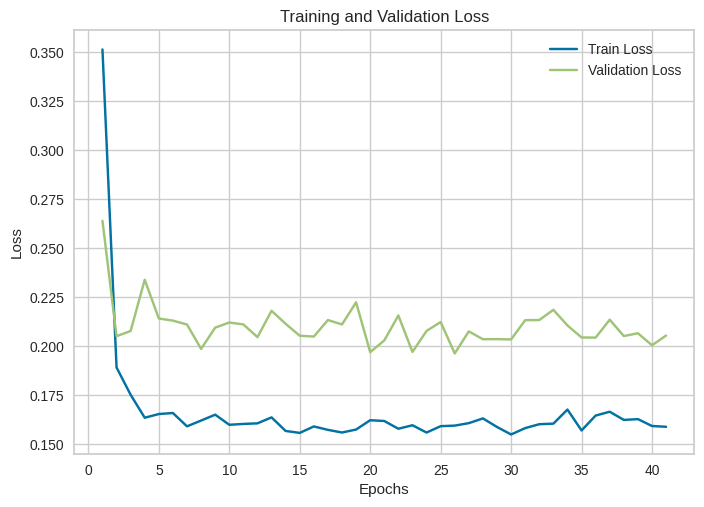

dataset_sample Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.18113 | Validation Loss: 0.15337
Epoch 20/60 | Train Loss: 0.17388 | Validation Loss: 0.15475
Epoch 30/60 | Train Loss: 0.18170 | Validation Loss: 0.16006
Early stopping triggered after 31 epochs with no improvement.


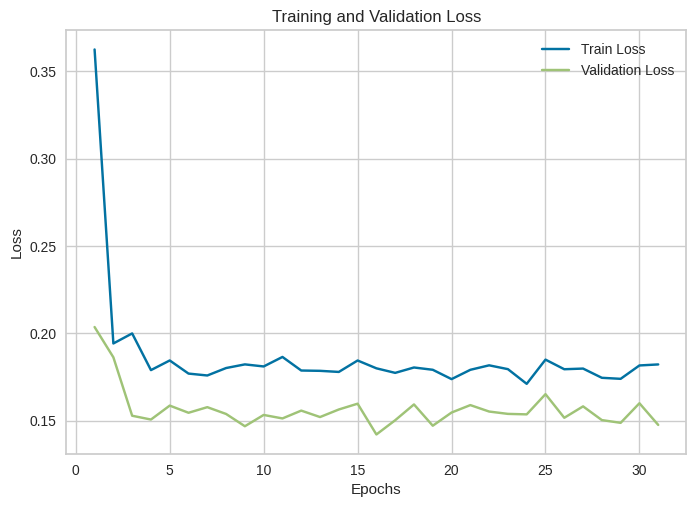

dataset_sample Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.17448 | Validation Loss: 0.16122
Epoch 20/60 | Train Loss: 0.17611 | Validation Loss: 0.15737
Epoch 30/60 | Train Loss: 0.17621 | Validation Loss: 0.15740
Early stopping triggered after 34 epochs with no improvement.


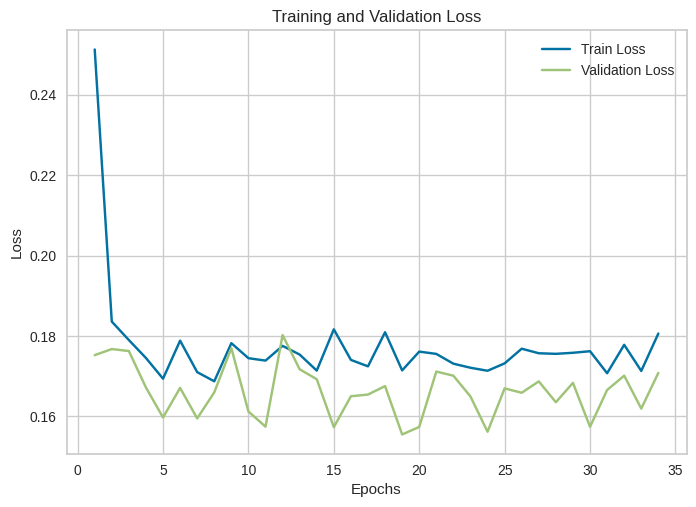

dataset_sample Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11160 | Validation Loss: 0.11400
Epoch 20/60 | Train Loss: 0.11030 | Validation Loss: 0.11308
Epoch 30/60 | Train Loss: 0.11018 | Validation Loss: 0.11239
Epoch 40/60 | Train Loss: 0.11026 | Validation Loss: 0.11329
Early stopping triggered after 45 epochs with no improvement.


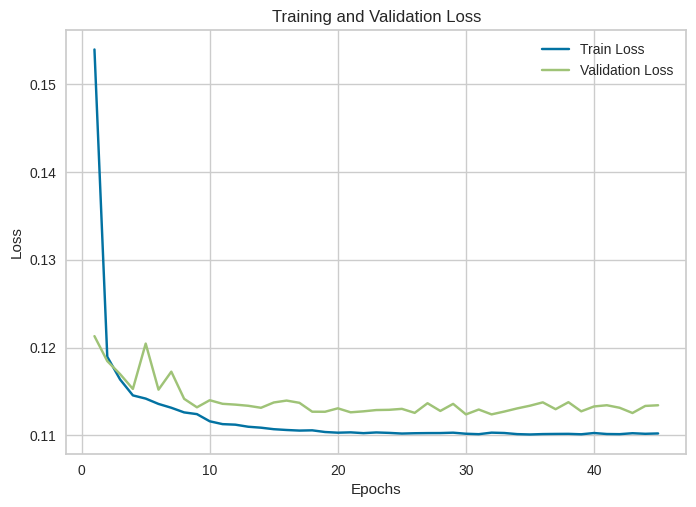

dataset_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.11233 | Validation Loss: 0.11603
Epoch 20/60 | Train Loss: 0.11110 | Validation Loss: 0.11427
Epoch 30/60 | Train Loss: 0.11091 | Validation Loss: 0.11556
Epoch 40/60 | Train Loss: 0.11092 | Validation Loss: 0.11454
Epoch 50/60 | Train Loss: 0.11083 | Validation Loss: 0.11562
Early stopping triggered after 52 epochs with no improvement.


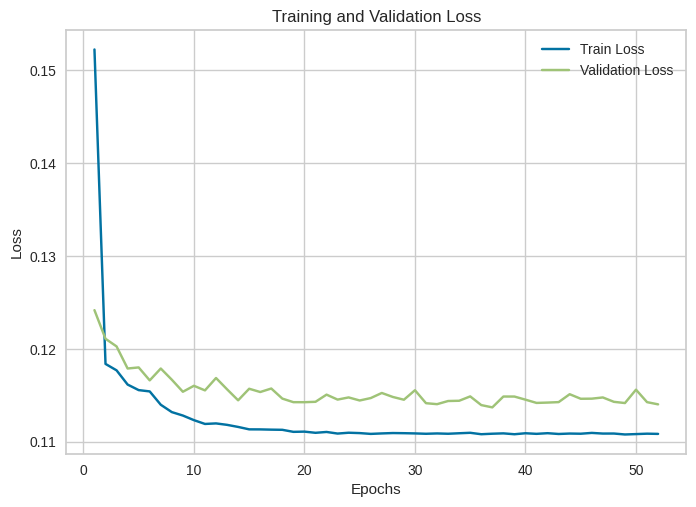

dataset_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.11294 | Validation Loss: 0.11018
Epoch 20/60 | Train Loss: 0.11193 | Validation Loss: 0.10914
Epoch 30/60 | Train Loss: 0.11184 | Validation Loss: 0.10845
Early stopping triggered after 32 epochs with no improvement.


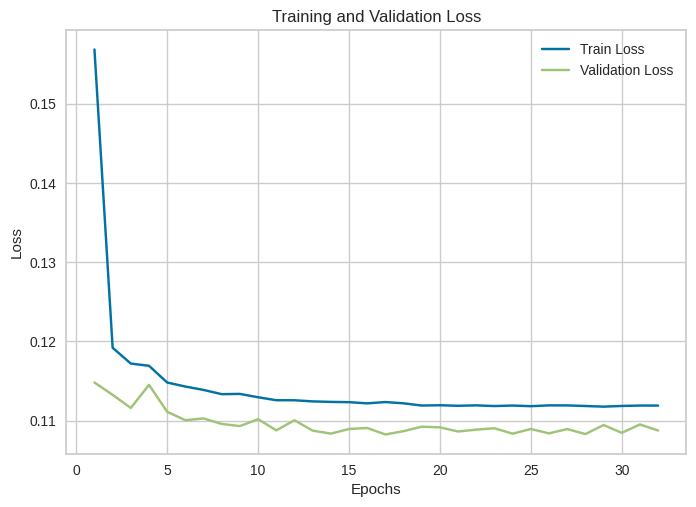

dataset_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.11255 | Validation Loss: 0.11175
Epoch 20/60 | Train Loss: 0.11187 | Validation Loss: 0.11046
Epoch 30/60 | Train Loss: 0.11162 | Validation Loss: 0.10903
Epoch 40/60 | Train Loss: 0.11169 | Validation Loss: 0.10884
Epoch 50/60 | Train Loss: 0.11155 | Validation Loss: 0.10910
Early stopping triggered after 51 epochs with no improvement.


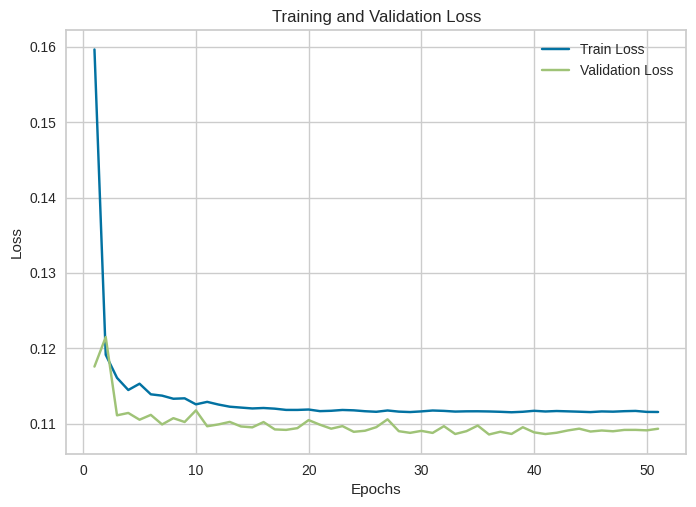

dataset_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11408 | Validation Loss: 0.11214
Epoch 20/60 | Train Loss: 0.11315 | Validation Loss: 0.11008
Epoch 30/60 | Train Loss: 0.11303 | Validation Loss: 0.11038
Epoch 40/60 | Train Loss: 0.11296 | Validation Loss: 0.11018
Epoch 50/60 | Train Loss: 0.11290 | Validation Loss: 0.11062
Early stopping triggered after 54 epochs with no improvement.


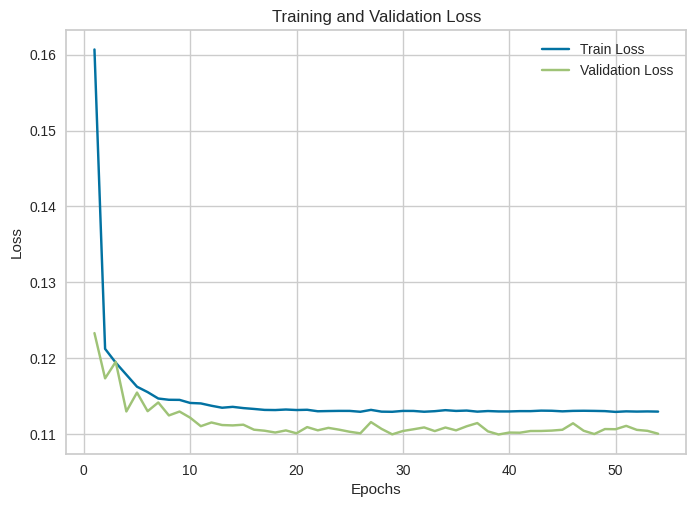

dataset_wp_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.11178 | Validation Loss: 0.11224
Epoch 20/60 | Train Loss: 0.11113 | Validation Loss: 0.11210
Epoch 30/60 | Train Loss: 0.11097 | Validation Loss: 0.11157
Early stopping triggered after 38 epochs with no improvement.


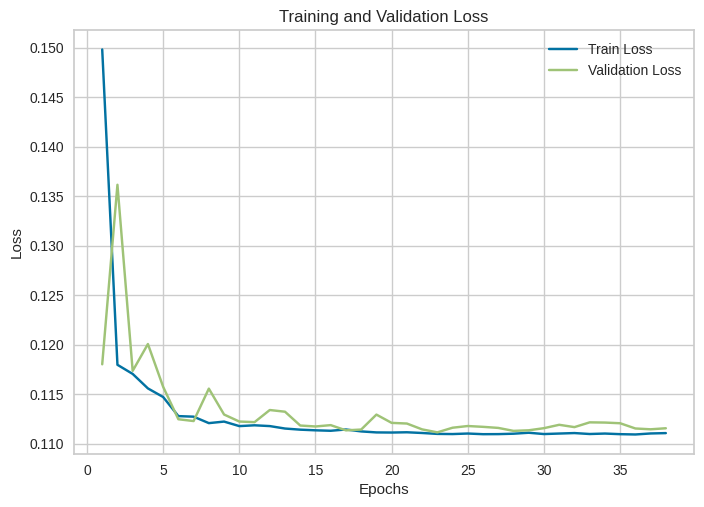

dataset_wp_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.11041 | Validation Loss: 0.11484
Epoch 20/60 | Train Loss: 0.10953 | Validation Loss: 0.11326
Epoch 30/60 | Train Loss: 0.10943 | Validation Loss: 0.11267
Epoch 40/60 | Train Loss: 0.10944 | Validation Loss: 0.11297
Early stopping triggered after 44 epochs with no improvement.


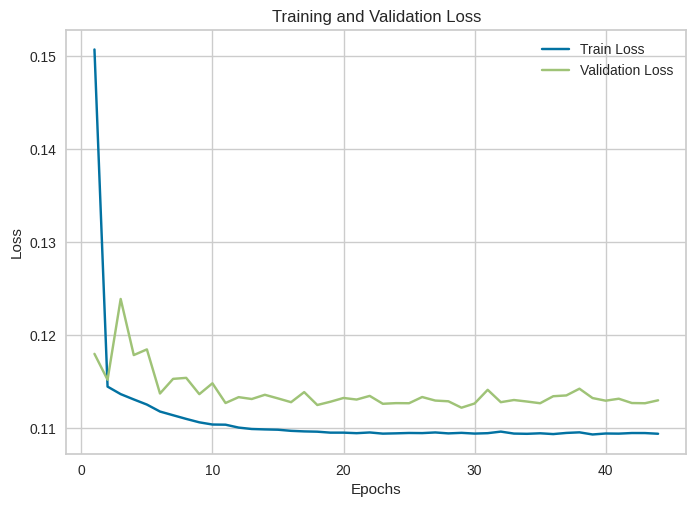

dataset_wp_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.11413 | Validation Loss: 0.11308
Epoch 20/60 | Train Loss: 0.11195 | Validation Loss: 0.11137
Epoch 30/60 | Train Loss: 0.11171 | Validation Loss: 0.11010
Epoch 40/60 | Train Loss: 0.11166 | Validation Loss: 0.11080
Early stopping triggered after 48 epochs with no improvement.


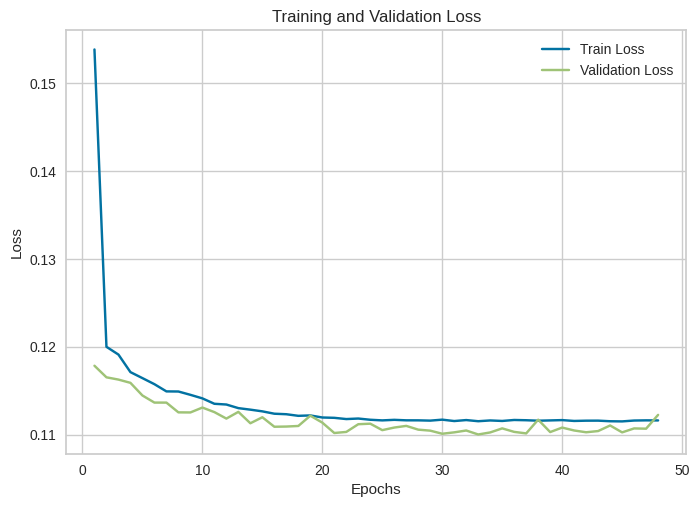

dataset_wp_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10058 | Validation Loss: 0.10094
Epoch 20/60 | Train Loss: 0.10007 | Validation Loss: 0.10080
Epoch 30/60 | Train Loss: 0.10002 | Validation Loss: 0.10070
Epoch 40/60 | Train Loss: 0.09995 | Validation Loss: 0.10067
Early stopping triggered after 40 epochs with no improvement.


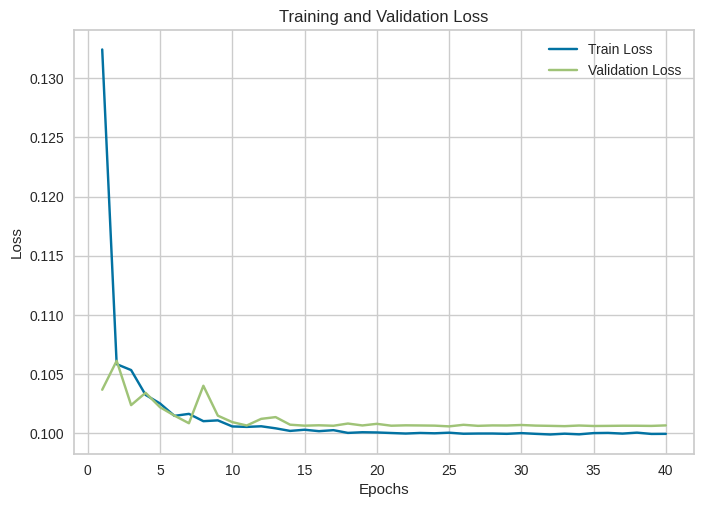

dataset_outliers_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10122 | Validation Loss: 0.09927
Epoch 20/60 | Train Loss: 0.10006 | Validation Loss: 0.09852
Epoch 30/60 | Train Loss: 0.09984 | Validation Loss: 0.09843
Epoch 40/60 | Train Loss: 0.09987 | Validation Loss: 0.09839
Early stopping triggered after 46 epochs with no improvement.


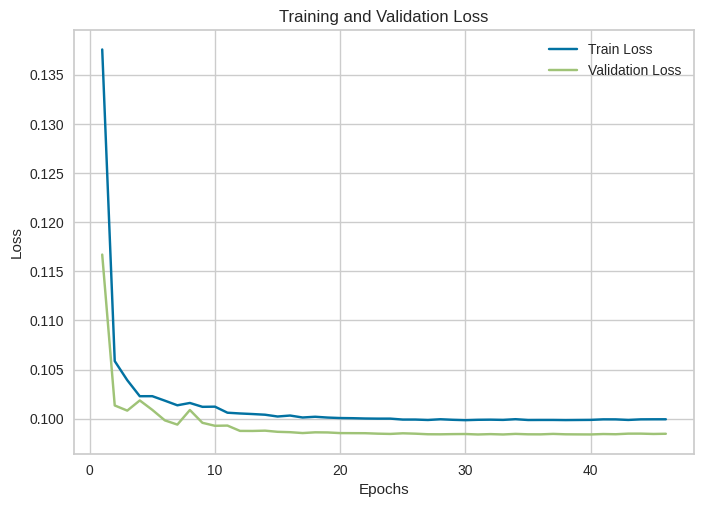

dataset_outliers_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10048 | Validation Loss: 0.10042
Epoch 20/60 | Train Loss: 0.09977 | Validation Loss: 0.09955
Epoch 30/60 | Train Loss: 0.09973 | Validation Loss: 0.09924
Epoch 40/60 | Train Loss: 0.09973 | Validation Loss: 0.09928
Early stopping triggered after 45 epochs with no improvement.


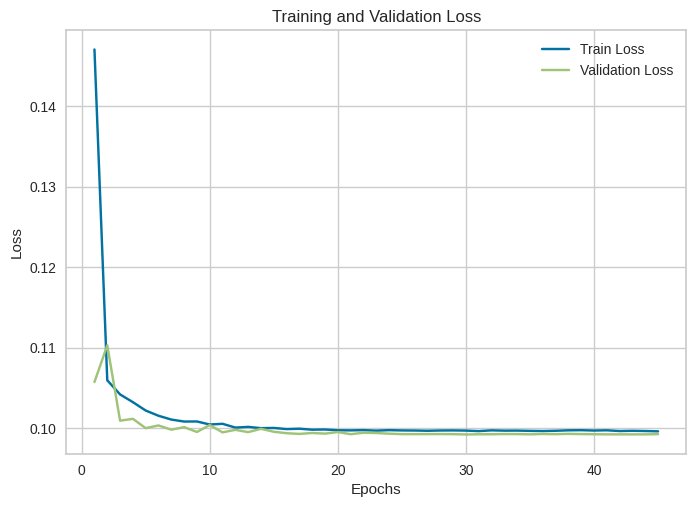

dataset_outliers_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09968 | Validation Loss: 0.10156
Epoch 20/60 | Train Loss: 0.09909 | Validation Loss: 0.10137
Epoch 30/60 | Train Loss: 0.09903 | Validation Loss: 0.10128
Epoch 40/60 | Train Loss: 0.09903 | Validation Loss: 0.10131
Epoch 50/60 | Train Loss: 0.09902 | Validation Loss: 0.10128
Epoch 60/60 | Train Loss: 0.09904 | Validation Loss: 0.10132


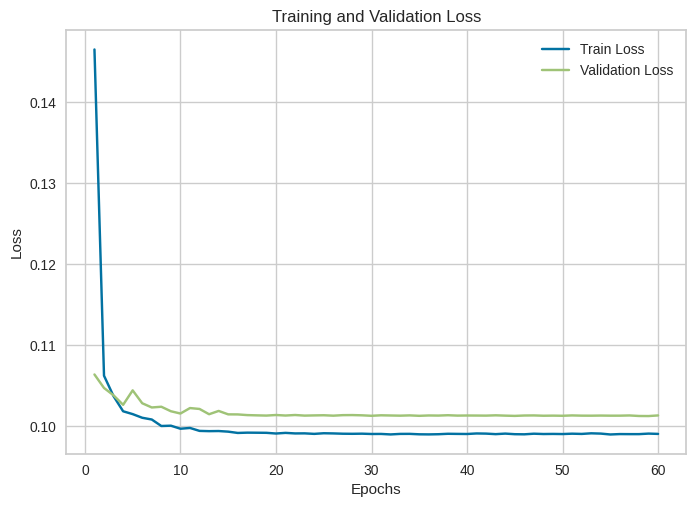

dataset_outliers_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10044 | Validation Loss: 0.10140
Epoch 20/60 | Train Loss: 0.09926 | Validation Loss: 0.10100
Epoch 30/60 | Train Loss: 0.09914 | Validation Loss: 0.10048
Epoch 40/60 | Train Loss: 0.09914 | Validation Loss: 0.10052
Early stopping triggered after 43 epochs with no improvement.


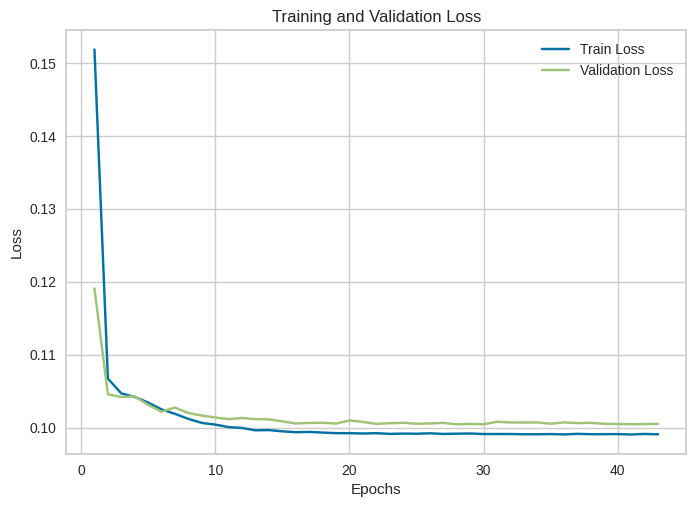

dataset_wp_outliers_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10041 | Validation Loss: 0.09951
Epoch 20/60 | Train Loss: 0.09980 | Validation Loss: 0.09904
Epoch 30/60 | Train Loss: 0.09967 | Validation Loss: 0.09909
Epoch 40/60 | Train Loss: 0.09970 | Validation Loss: 0.09885
Epoch 50/60 | Train Loss: 0.09973 | Validation Loss: 0.09913
Early stopping triggered after 55 epochs with no improvement.


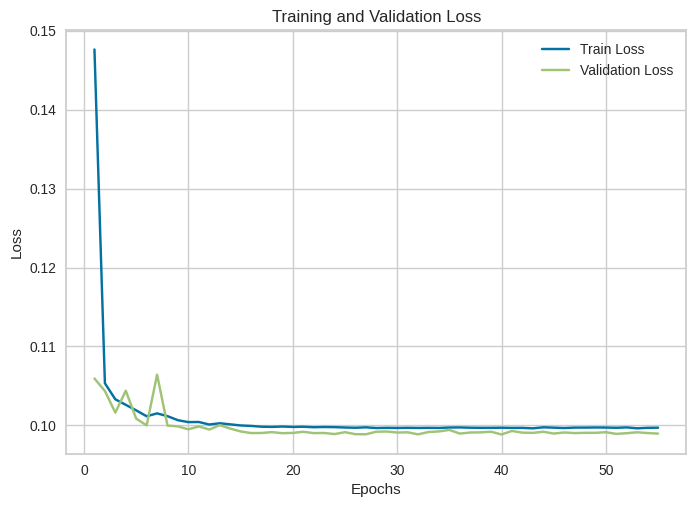

dataset_wp_outliers_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10014 | Validation Loss: 0.10125
Epoch 20/60 | Train Loss: 0.09947 | Validation Loss: 0.10095
Epoch 30/60 | Train Loss: 0.09937 | Validation Loss: 0.10087
Early stopping triggered after 36 epochs with no improvement.


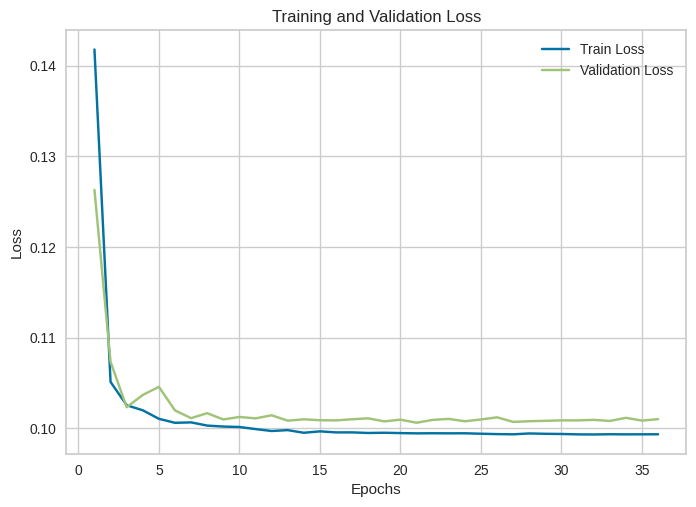

dataset_wp_outliers_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09960 | Validation Loss: 0.09755
Epoch 20/60 | Train Loss: 0.09882 | Validation Loss: 0.09718
Epoch 30/60 | Train Loss: 0.09869 | Validation Loss: 0.09714
Epoch 40/60 | Train Loss: 0.09871 | Validation Loss: 0.09744
Early stopping triggered after 48 epochs with no improvement.


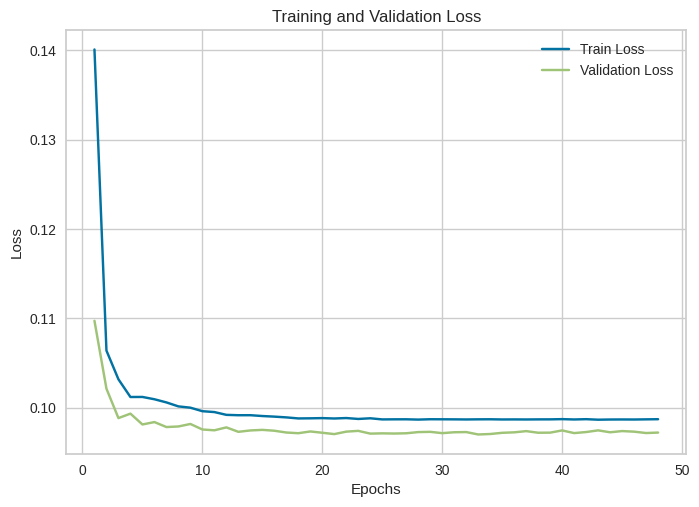

dataset_wp_outliers_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10776 | Validation Loss: 0.10687
Epoch 20/60 | Train Loss: 0.10732 | Validation Loss: 0.10589
Epoch 30/60 | Train Loss: 0.10727 | Validation Loss: 0.10600
Early stopping triggered after 37 epochs with no improvement.


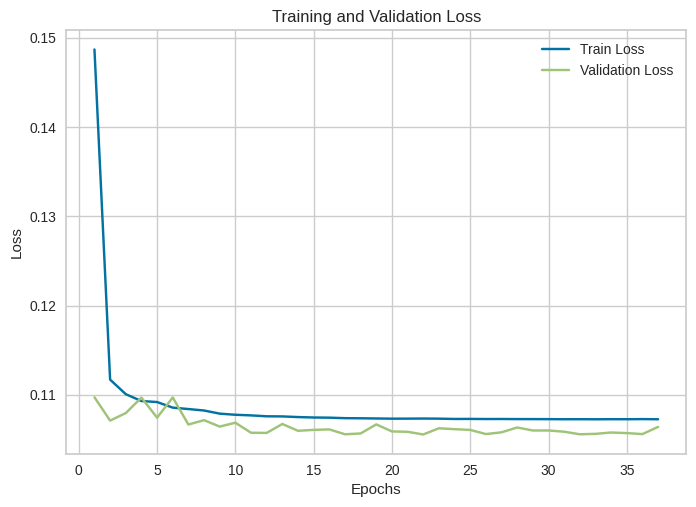

dataset_isolation_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10778 | Validation Loss: 0.10822
Epoch 20/60 | Train Loss: 0.10684 | Validation Loss: 0.10667
Early stopping triggered after 29 epochs with no improvement.


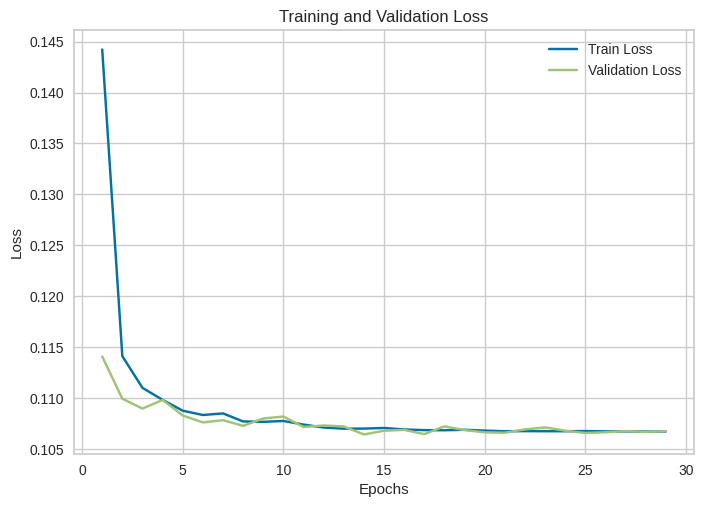

dataset_isolation_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10749 | Validation Loss: 0.11011
Epoch 20/60 | Train Loss: 0.10695 | Validation Loss: 0.10723
Epoch 30/60 | Train Loss: 0.10687 | Validation Loss: 0.10728
Epoch 40/60 | Train Loss: 0.10686 | Validation Loss: 0.10680
Epoch 50/60 | Train Loss: 0.10686 | Validation Loss: 0.10700
Early stopping triggered after 55 epochs with no improvement.


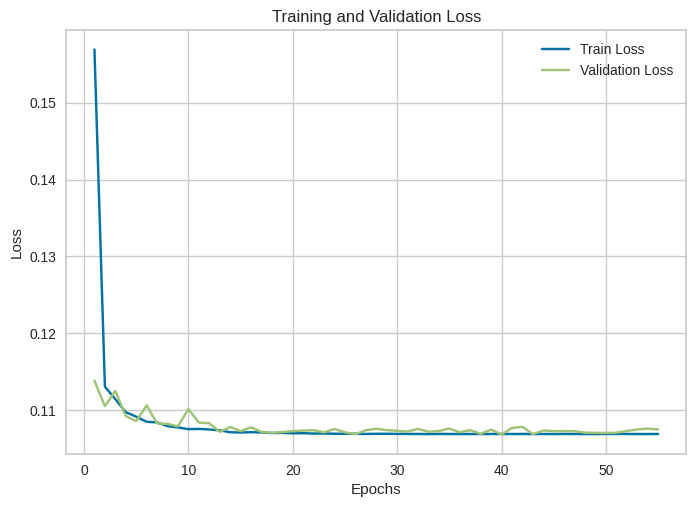

dataset_isolation_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10739 | Validation Loss: 0.10886
Epoch 20/60 | Train Loss: 0.10626 | Validation Loss: 0.10776
Epoch 30/60 | Train Loss: 0.10612 | Validation Loss: 0.10719
Early stopping triggered after 32 epochs with no improvement.


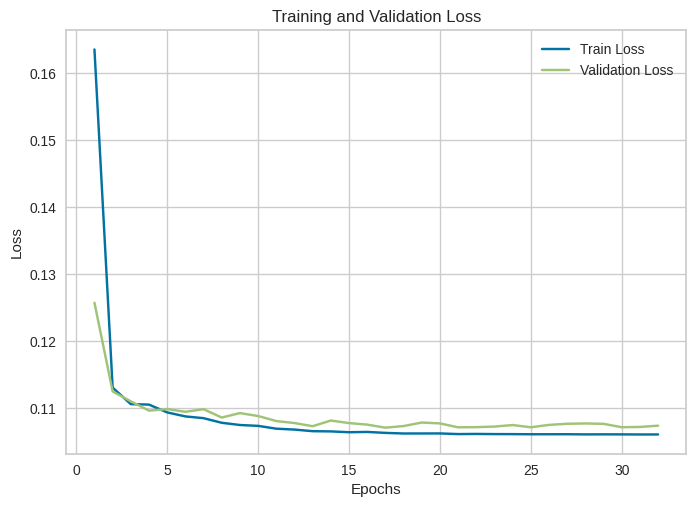

dataset_isolation_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10745 | Validation Loss: 0.10641
Epoch 20/60 | Train Loss: 0.10667 | Validation Loss: 0.10541
Epoch 30/60 | Train Loss: 0.10651 | Validation Loss: 0.10549
Epoch 40/60 | Train Loss: 0.10649 | Validation Loss: 0.10539
Early stopping triggered after 47 epochs with no improvement.


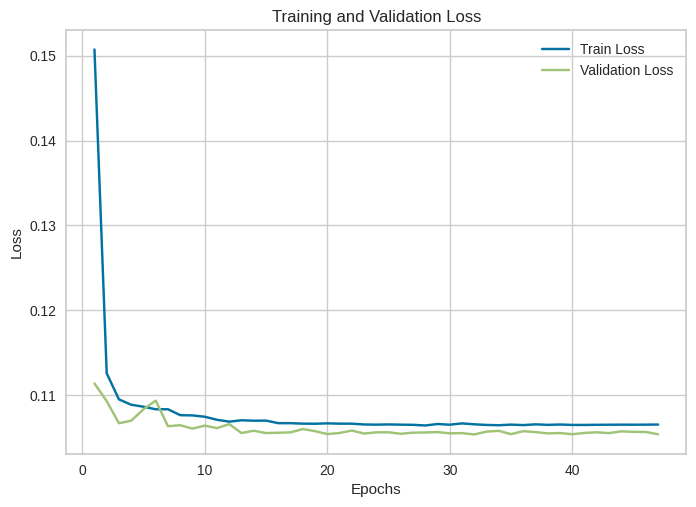

dataset_wp_isolation_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10620 | Validation Loss: 0.10800
Epoch 20/60 | Train Loss: 0.10536 | Validation Loss: 0.10818
Epoch 30/60 | Train Loss: 0.10532 | Validation Loss: 0.10762
Epoch 40/60 | Train Loss: 0.10526 | Validation Loss: 0.10764
Early stopping triggered after 45 epochs with no improvement.


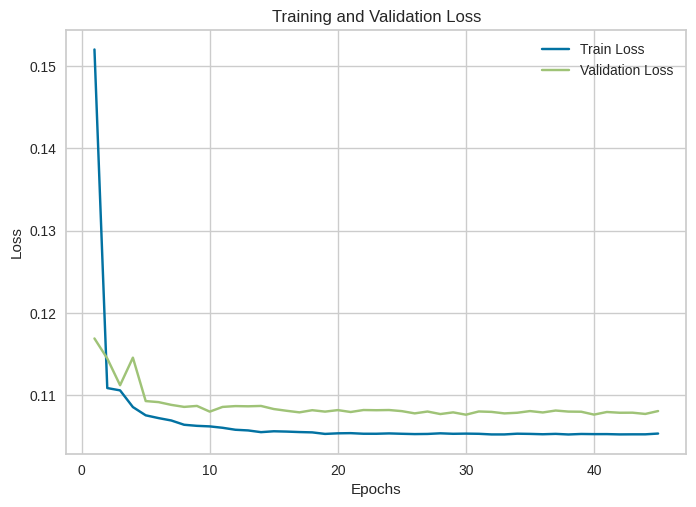

dataset_wp_isolation_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10684 | Validation Loss: 0.10688
Epoch 20/60 | Train Loss: 0.10577 | Validation Loss: 0.10653
Epoch 30/60 | Train Loss: 0.10557 | Validation Loss: 0.10688
Early stopping triggered after 39 epochs with no improvement.


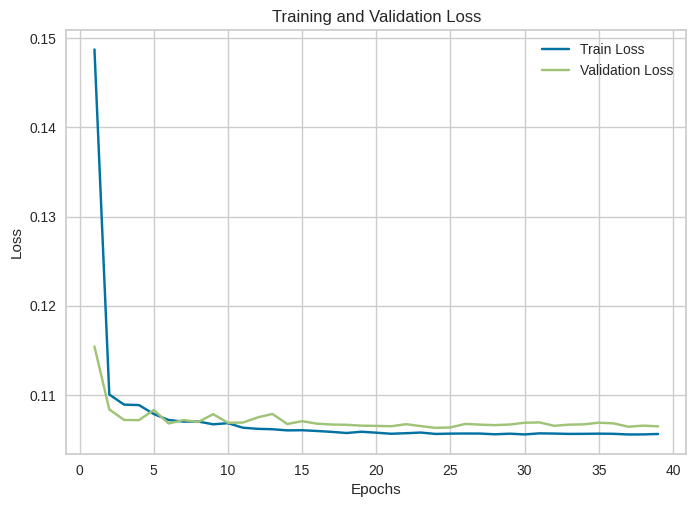

dataset_wp_isolation_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10686 | Validation Loss: 0.10526
Epoch 20/60 | Train Loss: 0.10583 | Validation Loss: 0.10488
Epoch 30/60 | Train Loss: 0.10565 | Validation Loss: 0.10457
Early stopping triggered after 39 epochs with no improvement.


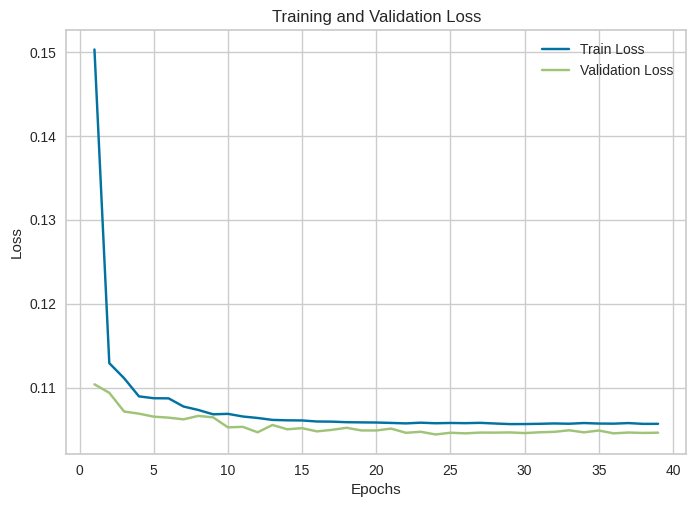

dataset_wp_isolation_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11284 | Validation Loss: 0.11235
Epoch 20/60 | Train Loss: 0.11192 | Validation Loss: 0.11186
Epoch 30/60 | Train Loss: 0.11187 | Validation Loss: 0.11123
Epoch 40/60 | Train Loss: 0.11183 | Validation Loss: 0.11169
Early stopping triggered after 45 epochs with no improvement.


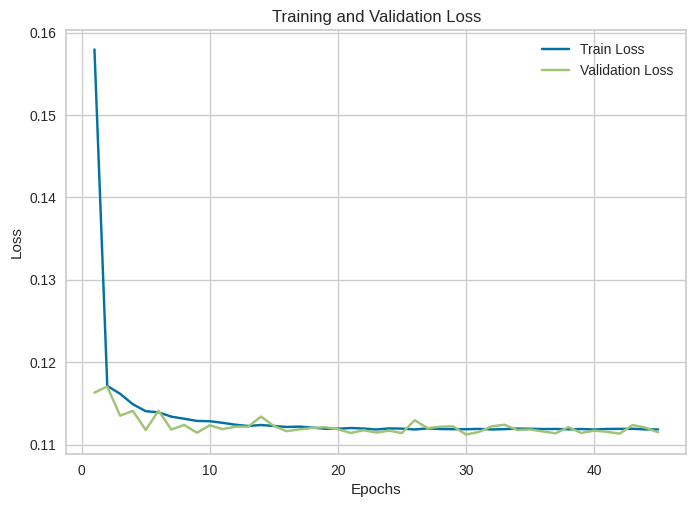

dataset_log_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.11560 | Validation Loss: 0.11382
Epoch 20/60 | Train Loss: 0.11482 | Validation Loss: 0.11353
Epoch 30/60 | Train Loss: 0.11463 | Validation Loss: 0.11332
Epoch 40/60 | Train Loss: 0.11466 | Validation Loss: 0.11314
Early stopping triggered after 40 epochs with no improvement.


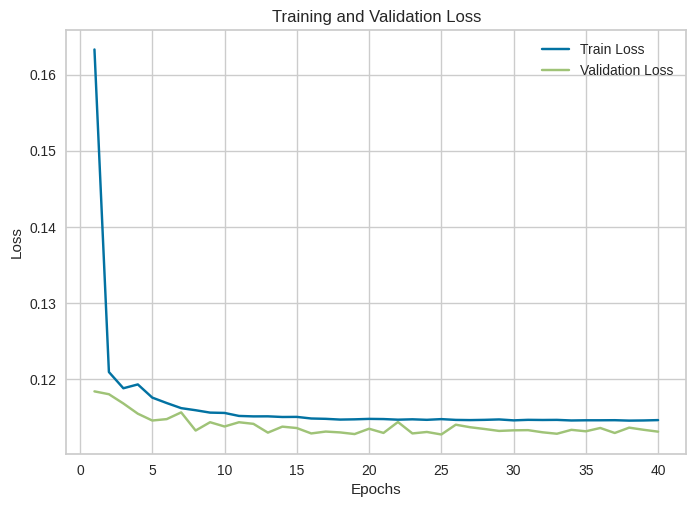

dataset_log_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.11241 | Validation Loss: 0.11229
Epoch 20/60 | Train Loss: 0.11190 | Validation Loss: 0.11296
Epoch 30/60 | Train Loss: 0.11164 | Validation Loss: 0.11156
Epoch 40/60 | Train Loss: 0.11152 | Validation Loss: 0.11304
Early stopping triggered after 45 epochs with no improvement.


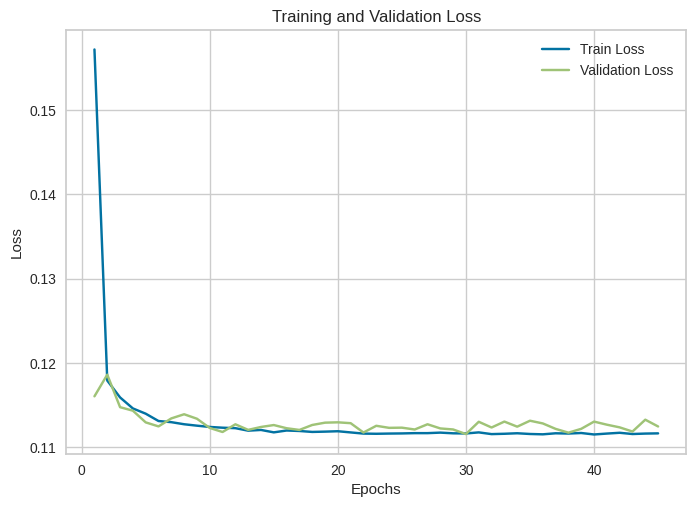

dataset_log_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.11230 | Validation Loss: 0.11367
Epoch 20/60 | Train Loss: 0.11117 | Validation Loss: 0.11294
Early stopping triggered after 29 epochs with no improvement.


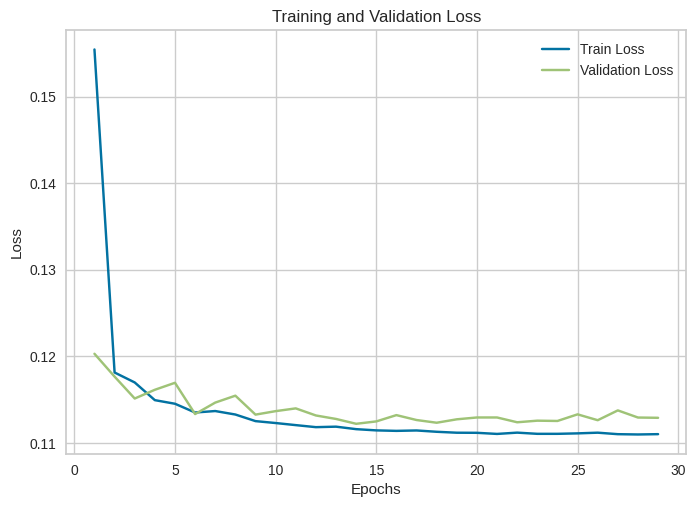

dataset_log_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11141 | Validation Loss: 0.11377
Epoch 20/60 | Train Loss: 0.11076 | Validation Loss: 0.11303
Epoch 30/60 | Train Loss: 0.11054 | Validation Loss: 0.11277
Epoch 40/60 | Train Loss: 0.11055 | Validation Loss: 0.11242
Epoch 50/60 | Train Loss: 0.11061 | Validation Loss: 0.11261
Early stopping triggered after 57 epochs with no improvement.


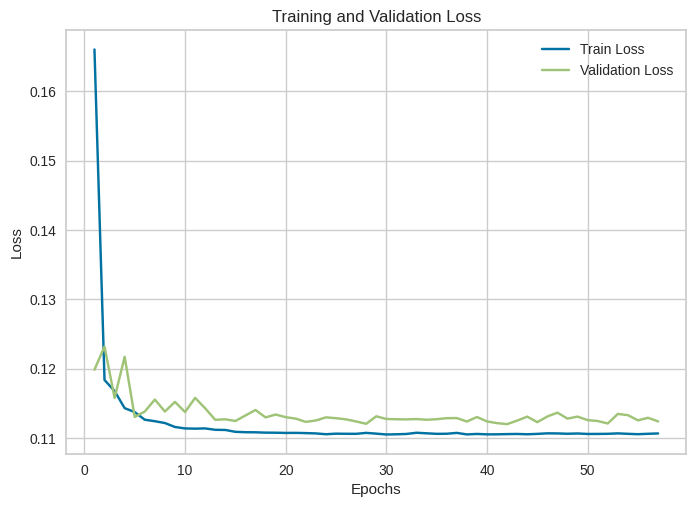

dataset_wp_log_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.11483 | Validation Loss: 0.11482
Epoch 20/60 | Train Loss: 0.11318 | Validation Loss: 0.11329
Early stopping triggered after 28 epochs with no improvement.


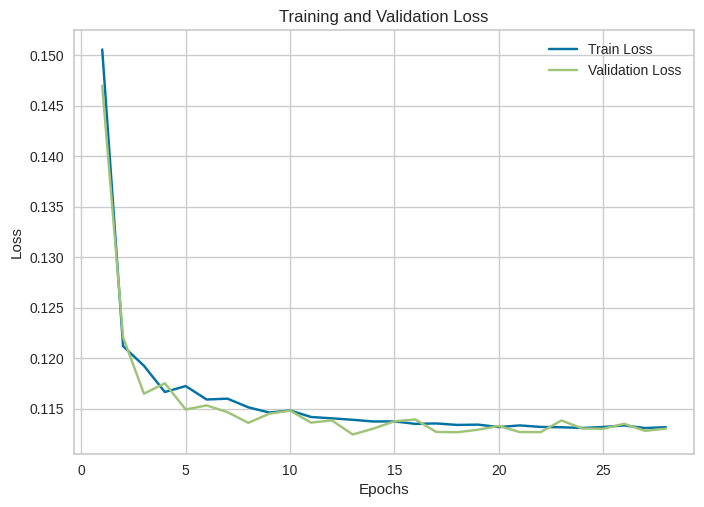

dataset_wp_log_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.11313 | Validation Loss: 0.11194
Epoch 20/60 | Train Loss: 0.11225 | Validation Loss: 0.11149
Epoch 30/60 | Train Loss: 0.11217 | Validation Loss: 0.11058
Epoch 40/60 | Train Loss: 0.11202 | Validation Loss: 0.11066
Early stopping triggered after 45 epochs with no improvement.


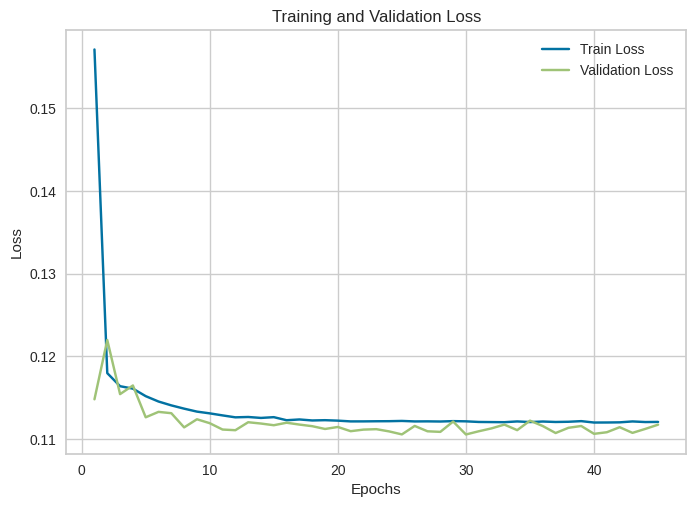

dataset_wp_log_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.11239 | Validation Loss: 0.11301
Epoch 20/60 | Train Loss: 0.11151 | Validation Loss: 0.11158
Epoch 30/60 | Train Loss: 0.11146 | Validation Loss: 0.11179
Early stopping triggered after 35 epochs with no improvement.


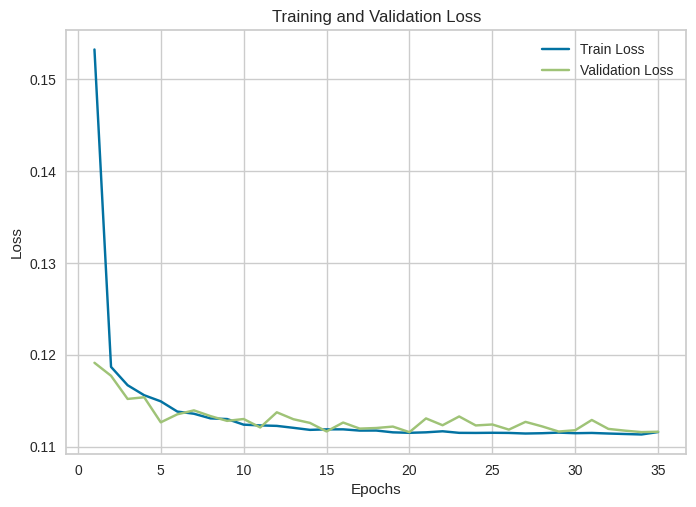

dataset_wp_log_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.19771 | Validation Loss: 0.17137
Epoch 20/60 | Train Loss: 0.19803 | Validation Loss: 0.17934
Early stopping triggered after 24 epochs with no improvement.


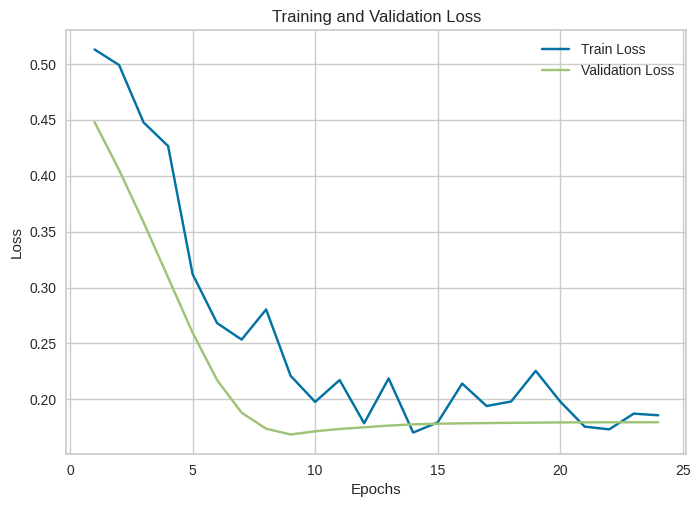

dataset_representative Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.21918 | Validation Loss: 0.18279
Epoch 20/60 | Train Loss: 0.21369 | Validation Loss: 0.16705
Early stopping triggered after 20 epochs with no improvement.


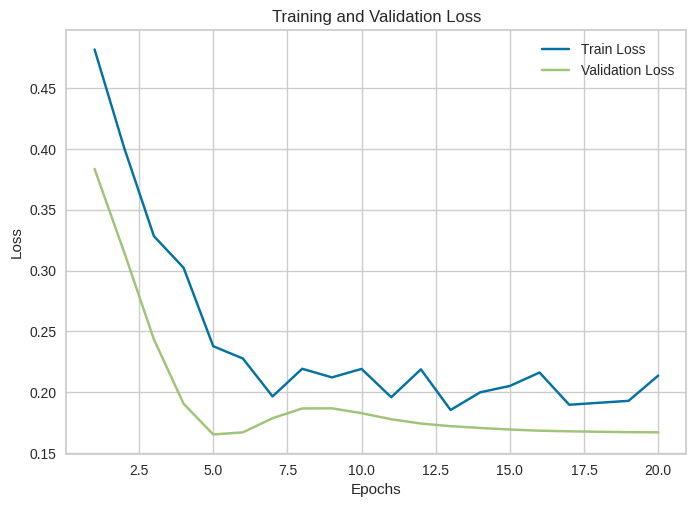

dataset_representative Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.23165 | Validation Loss: 0.21624
Epoch 20/60 | Train Loss: 0.18999 | Validation Loss: 0.21563
Early stopping triggered after 29 epochs with no improvement.


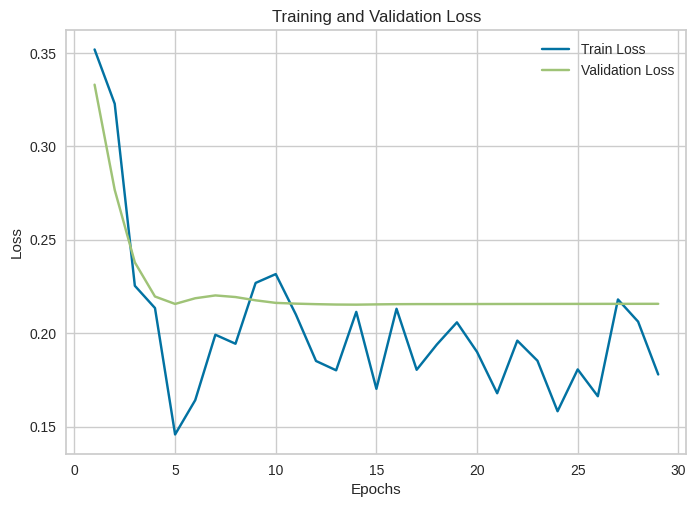

dataset_representative Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.20444 | Validation Loss: 0.21364
Epoch 20/60 | Train Loss: 0.19097 | Validation Loss: 0.21852
Early stopping triggered after 21 epochs with no improvement.


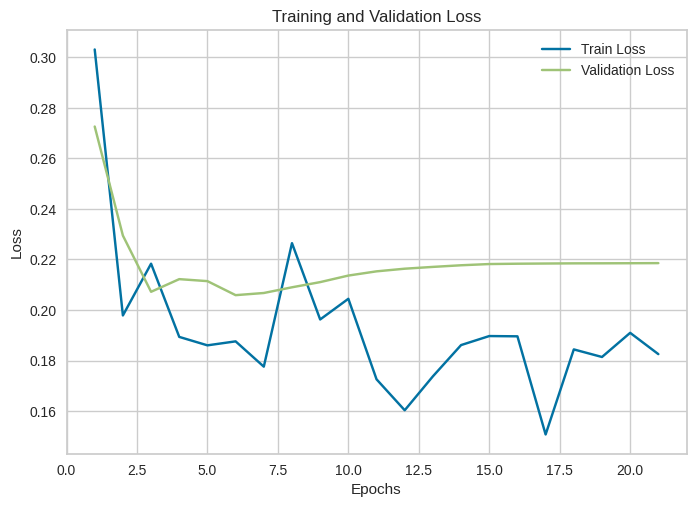

dataset_representative Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.14952 | Validation Loss: 0.14801
Early stopping triggered after 17 epochs with no improvement.


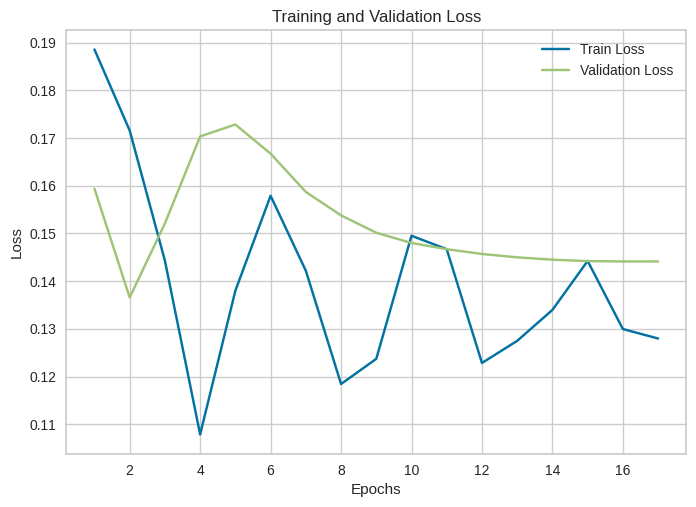

dataset_outliers_representative Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.13179 | Validation Loss: 0.13283
Epoch 20/60 | Train Loss: 0.14839 | Validation Loss: 0.12809
Early stopping triggered after 20 epochs with no improvement.


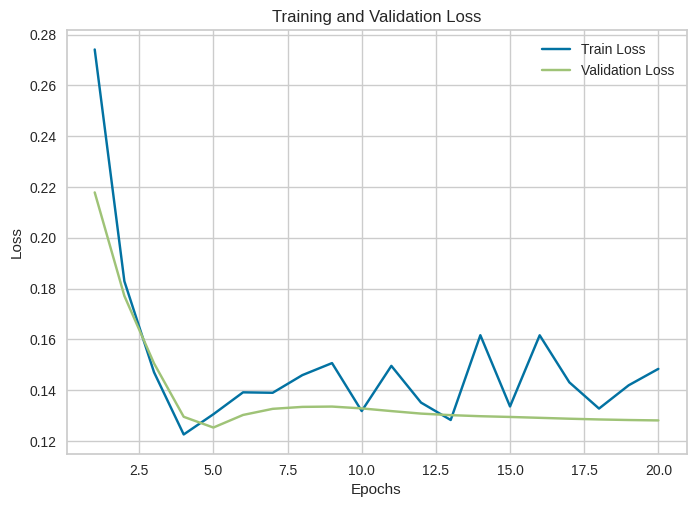

dataset_outliers_representative Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.13835 | Validation Loss: 0.13409
Epoch 20/60 | Train Loss: 0.12880 | Validation Loss: 0.13768
Early stopping triggered after 24 epochs with no improvement.


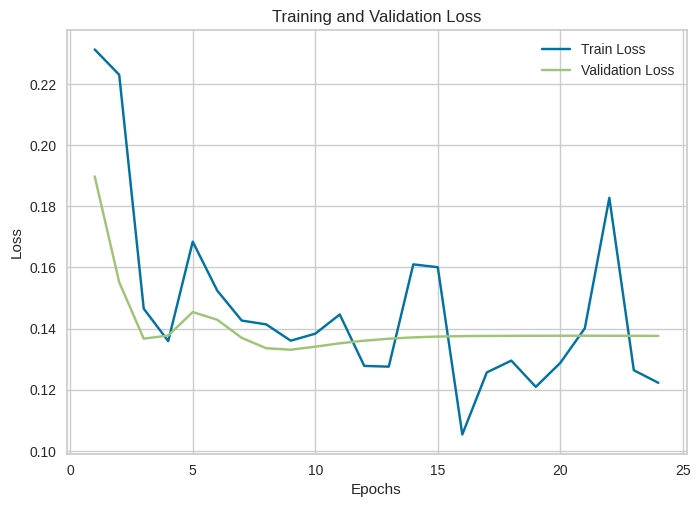

dataset_outliers_representative Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.13849 | Validation Loss: 0.13690
Epoch 20/60 | Train Loss: 0.14711 | Validation Loss: 0.13631
Early stopping triggered after 23 epochs with no improvement.


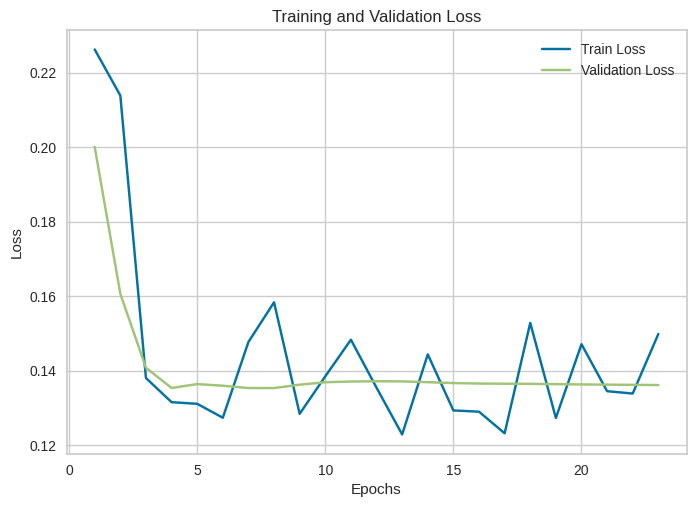

dataset_outliers_representative Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11004 | Validation Loss: 0.10907
Epoch 20/60 | Train Loss: 0.10931 | Validation Loss: 0.10776
Epoch 30/60 | Train Loss: 0.10922 | Validation Loss: 0.10777
Epoch 40/60 | Train Loss: 0.10921 | Validation Loss: 0.10773
Epoch 50/60 | Train Loss: 0.10919 | Validation Loss: 0.10774
Epoch 60/60 | Train Loss: 0.10921 | Validation Loss: 0.10780


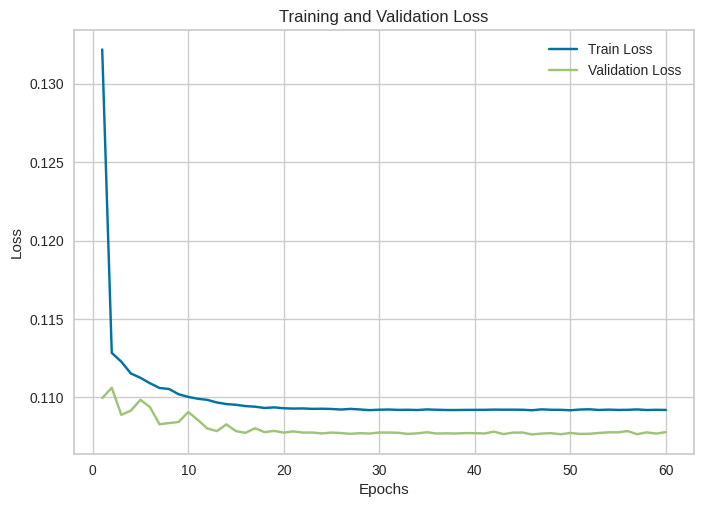

dataset_isolation_l_generated Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10951 | Validation Loss: 0.11061
Epoch 20/60 | Train Loss: 0.10867 | Validation Loss: 0.10983
Epoch 30/60 | Train Loss: 0.10855 | Validation Loss: 0.10987
Epoch 40/60 | Train Loss: 0.10860 | Validation Loss: 0.10993
Early stopping triggered after 42 epochs with no improvement.


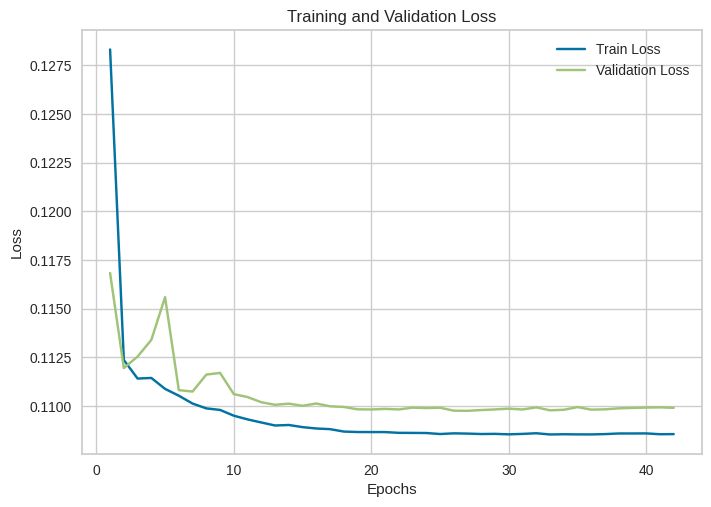

dataset_isolation_l_generated Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10924 | Validation Loss: 0.10988
Epoch 20/60 | Train Loss: 0.10842 | Validation Loss: 0.10942
Epoch 30/60 | Train Loss: 0.10827 | Validation Loss: 0.10936
Epoch 40/60 | Train Loss: 0.10828 | Validation Loss: 0.10938
Early stopping triggered after 42 epochs with no improvement.


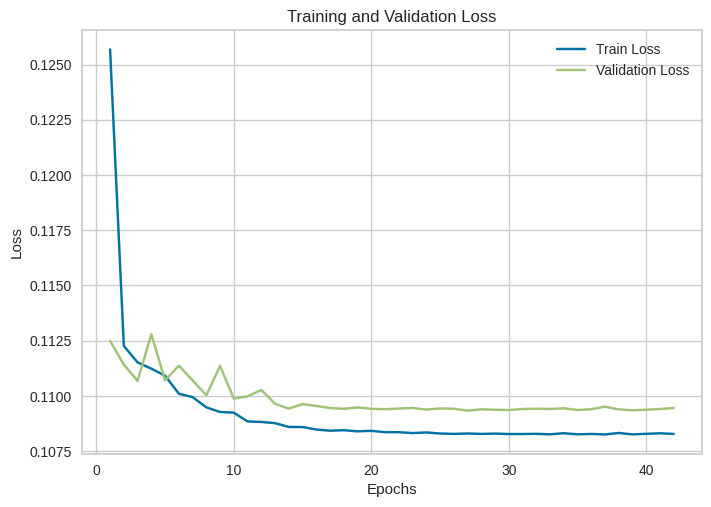

dataset_isolation_l_generated Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10986 | Validation Loss: 0.10954
Epoch 20/60 | Train Loss: 0.10931 | Validation Loss: 0.10934
Epoch 30/60 | Train Loss: 0.10922 | Validation Loss: 0.10933
Early stopping triggered after 30 epochs with no improvement.


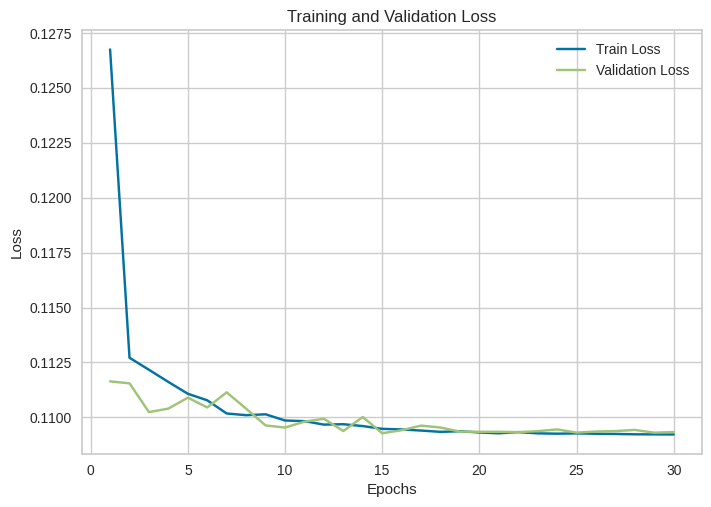

dataset_isolation_l_generated Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09756 | Validation Loss: 0.09639
Epoch 20/60 | Train Loss: 0.09700 | Validation Loss: 0.09630
Epoch 30/60 | Train Loss: 0.09690 | Validation Loss: 0.09573
Epoch 40/60 | Train Loss: 0.09690 | Validation Loss: 0.09584
Early stopping triggered after 45 epochs with no improvement.


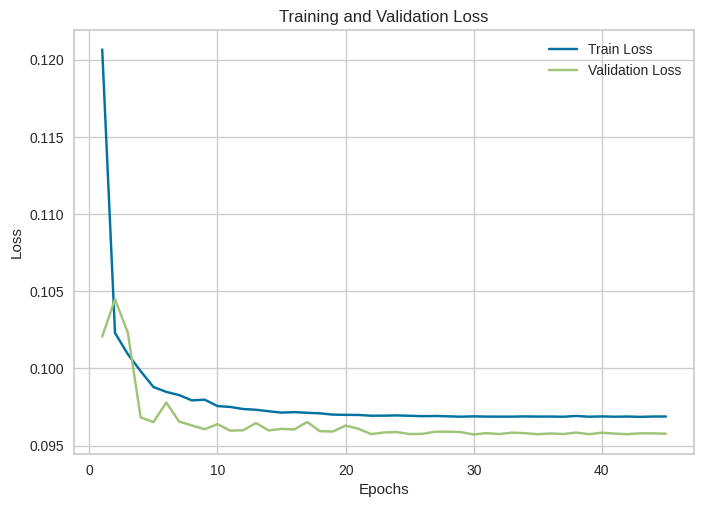

dataset_isolation_generated Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09777 | Validation Loss: 0.09875
Epoch 20/60 | Train Loss: 0.09702 | Validation Loss: 0.09799
Epoch 30/60 | Train Loss: 0.09690 | Validation Loss: 0.09804
Epoch 40/60 | Train Loss: 0.09691 | Validation Loss: 0.09796
Epoch 50/60 | Train Loss: 0.09690 | Validation Loss: 0.09795
Early stopping triggered after 53 epochs with no improvement.


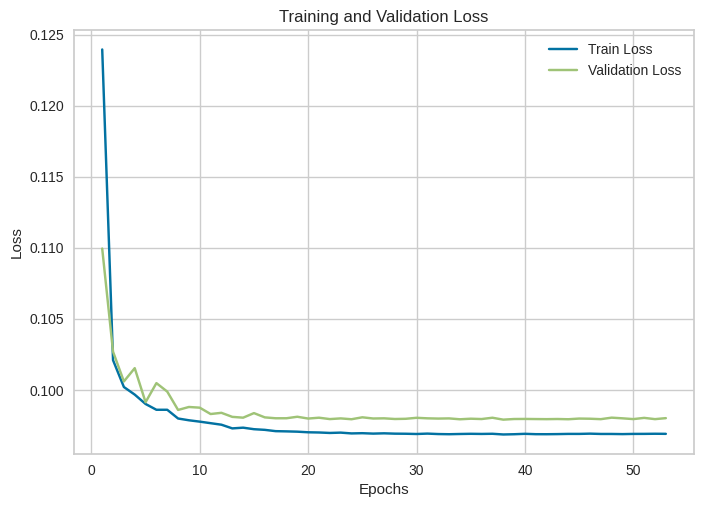

dataset_isolation_generated Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09728 | Validation Loss: 0.09654
Epoch 20/60 | Train Loss: 0.09660 | Validation Loss: 0.09625
Epoch 30/60 | Train Loss: 0.09652 | Validation Loss: 0.09612
Early stopping triggered after 36 epochs with no improvement.


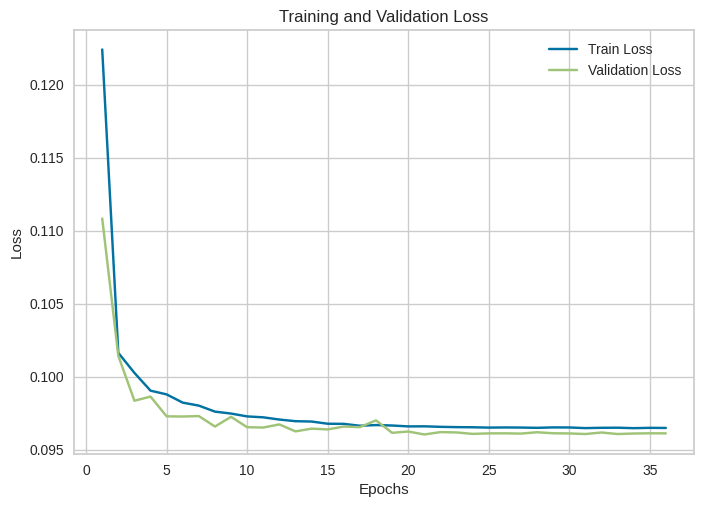

dataset_isolation_generated Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09678 | Validation Loss: 0.09714
Epoch 20/60 | Train Loss: 0.09601 | Validation Loss: 0.09688
Epoch 30/60 | Train Loss: 0.09590 | Validation Loss: 0.09681
Epoch 40/60 | Train Loss: 0.09587 | Validation Loss: 0.09678
Epoch 50/60 | Train Loss: 0.09588 | Validation Loss: 0.09683
Early stopping triggered after 51 epochs with no improvement.


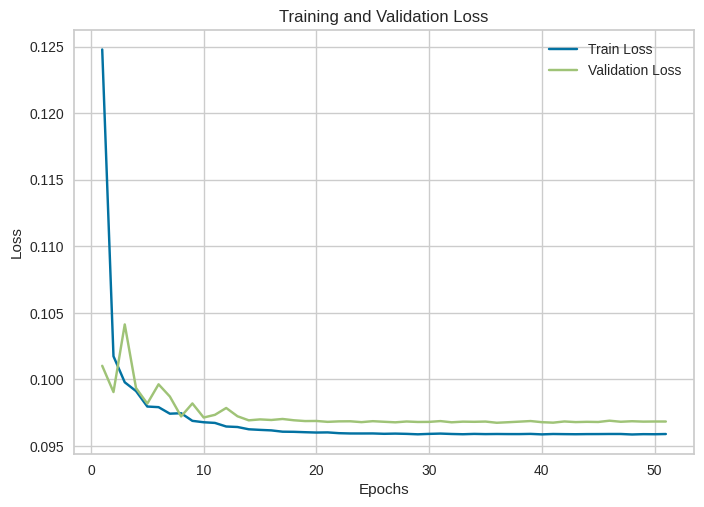

dataset_isolation_generated Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.09026 | Validation Loss: 0.09064
Epoch 20/60 | Train Loss: 0.08969 | Validation Loss: 0.09011
Epoch 30/60 | Train Loss: 0.08963 | Validation Loss: 0.09030
Epoch 40/60 | Train Loss: 0.08963 | Validation Loss: 0.09019
Epoch 50/60 | Train Loss: 0.08957 | Validation Loss: 0.09013
Early stopping triggered after 51 epochs with no improvement.


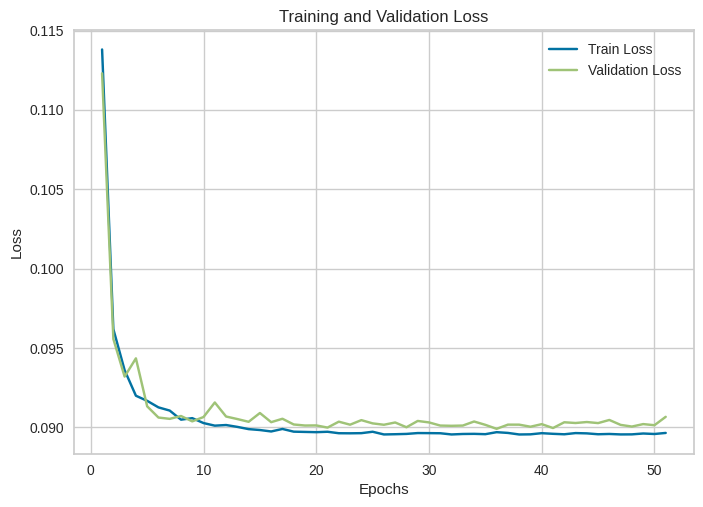

dataset_outliers_generated Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.09048 | Validation Loss: 0.08996
Epoch 20/60 | Train Loss: 0.08972 | Validation Loss: 0.09021
Early stopping triggered after 29 epochs with no improvement.


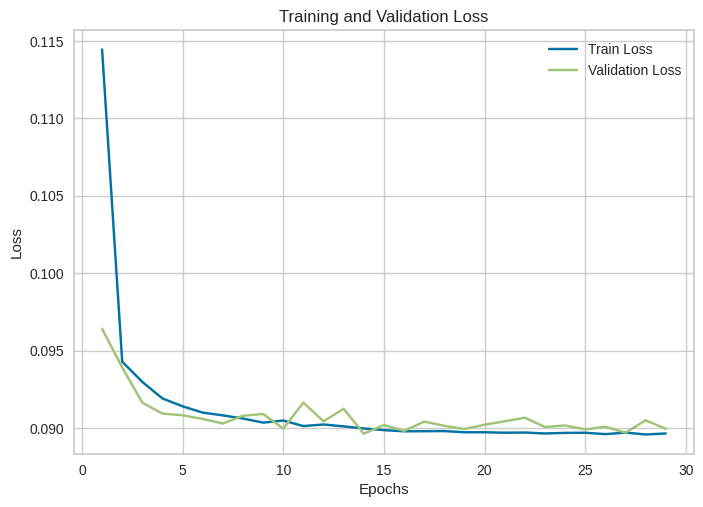

dataset_outliers_generated Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.09020 | Validation Loss: 0.09034
Epoch 20/60 | Train Loss: 0.08942 | Validation Loss: 0.08966
Epoch 30/60 | Train Loss: 0.08937 | Validation Loss: 0.08990
Epoch 40/60 | Train Loss: 0.08937 | Validation Loss: 0.08940
Epoch 50/60 | Train Loss: 0.08932 | Validation Loss: 0.08977
Early stopping triggered after 50 epochs with no improvement.


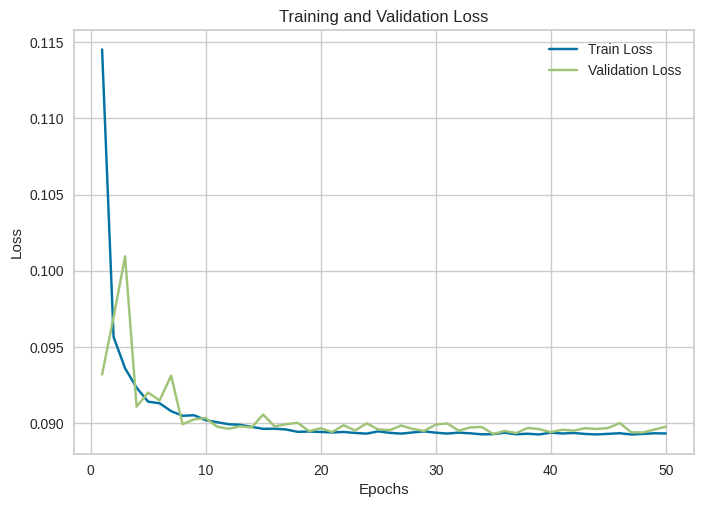

dataset_outliers_generated Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.09056 | Validation Loss: 0.08988
Epoch 20/60 | Train Loss: 0.09013 | Validation Loss: 0.08955
Epoch 30/60 | Train Loss: 0.09007 | Validation Loss: 0.08970
Early stopping triggered after 36 epochs with no improvement.


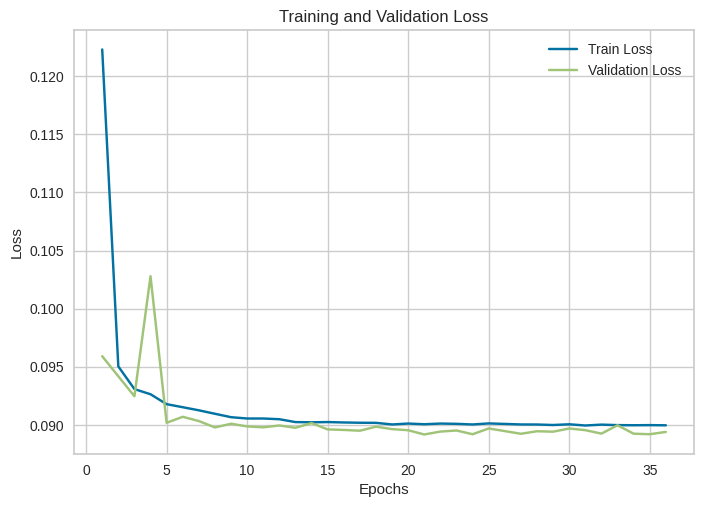

dataset_outliers_generated Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10392 | Validation Loss: 0.10498
Epoch 20/60 | Train Loss: 0.10238 | Validation Loss: 0.10402
Epoch 30/60 | Train Loss: 0.10217 | Validation Loss: 0.10397
Epoch 40/60 | Train Loss: 0.10232 | Validation Loss: 0.10399
Early stopping triggered after 40 epochs with no improvement.


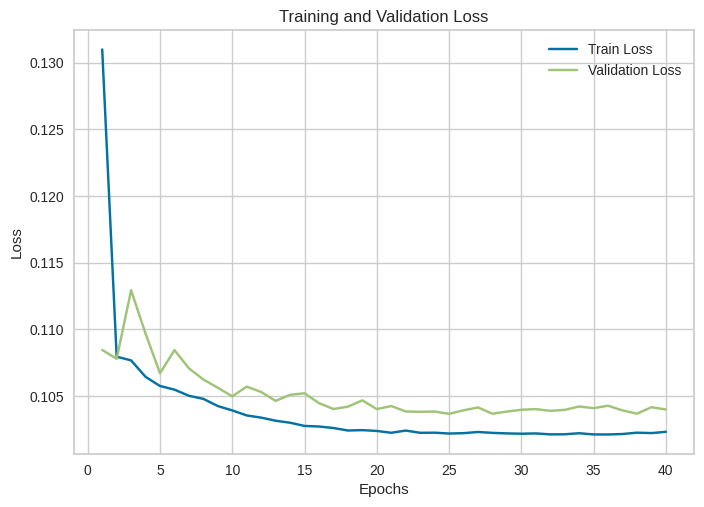

dataset_outliers_l_generated Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10555 | Validation Loss: 0.10586
Epoch 20/60 | Train Loss: 0.10481 | Validation Loss: 0.10460
Epoch 30/60 | Train Loss: 0.10493 | Validation Loss: 0.10432
Epoch 40/60 | Train Loss: 0.10471 | Validation Loss: 0.10406
Early stopping triggered after 47 epochs with no improvement.


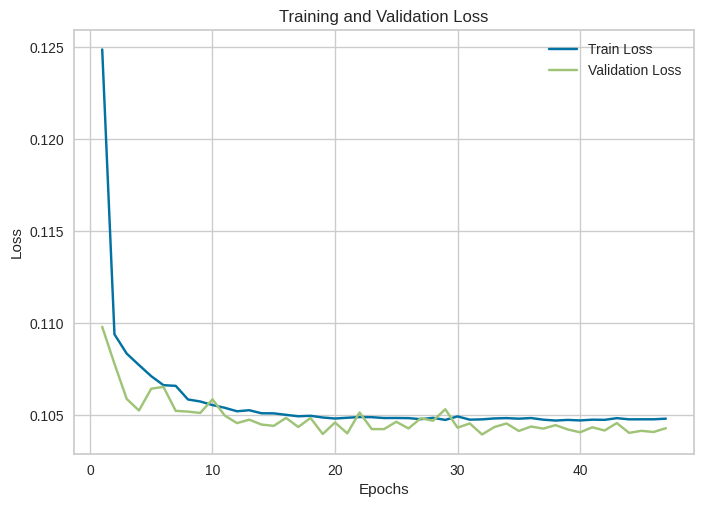

dataset_outliers_l_generated Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10614 | Validation Loss: 0.10711
Epoch 20/60 | Train Loss: 0.10534 | Validation Loss: 0.10722
Epoch 30/60 | Train Loss: 0.10524 | Validation Loss: 0.10660
Epoch 40/60 | Train Loss: 0.10531 | Validation Loss: 0.10726
Early stopping triggered after 40 epochs with no improvement.


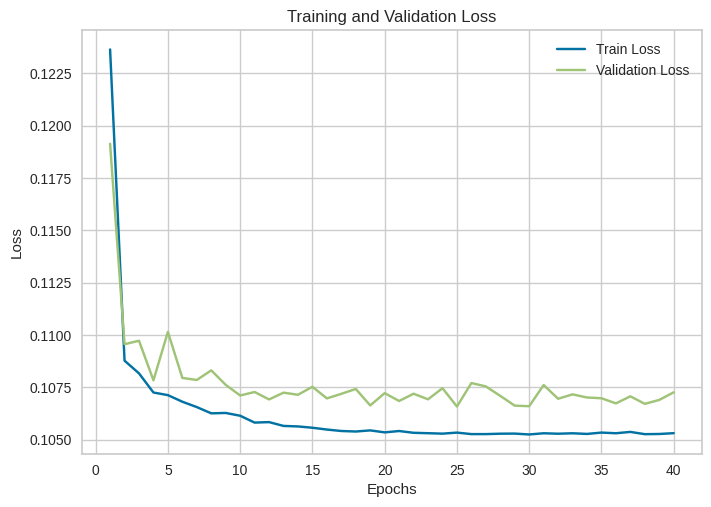

dataset_outliers_l_generated Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10336 | Validation Loss: 0.10087
Epoch 20/60 | Train Loss: 0.10257 | Validation Loss: 0.09994
Epoch 30/60 | Train Loss: 0.10249 | Validation Loss: 0.09991
Early stopping triggered after 36 epochs with no improvement.


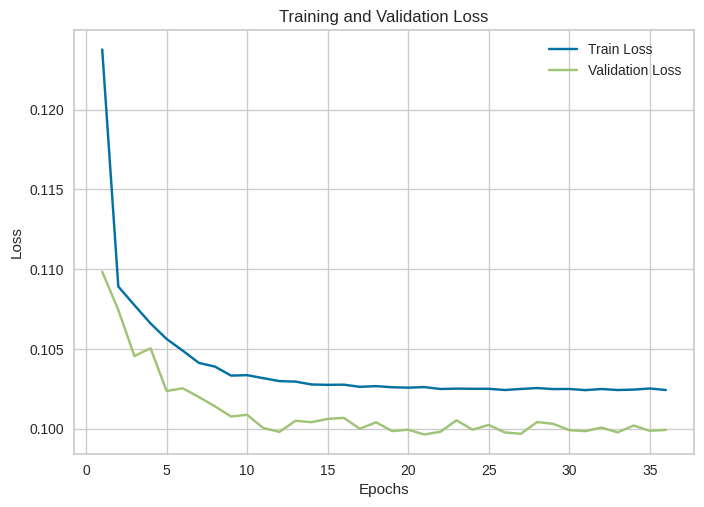

dataset_outliers_l_generated Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.11456 | Validation Loss: 0.11456
Epoch 20/60 | Train Loss: 0.11202 | Validation Loss: 0.11163
Epoch 30/60 | Train Loss: 0.11213 | Validation Loss: 0.11222
Epoch 40/60 | Train Loss: 0.11197 | Validation Loss: 0.11255
Epoch 50/60 | Train Loss: 0.11188 | Validation Loss: 0.11245
Epoch 60/60 | Train Loss: 0.11182 | Validation Loss: 0.11222
Early stopping triggered after 60 epochs with no improvement.


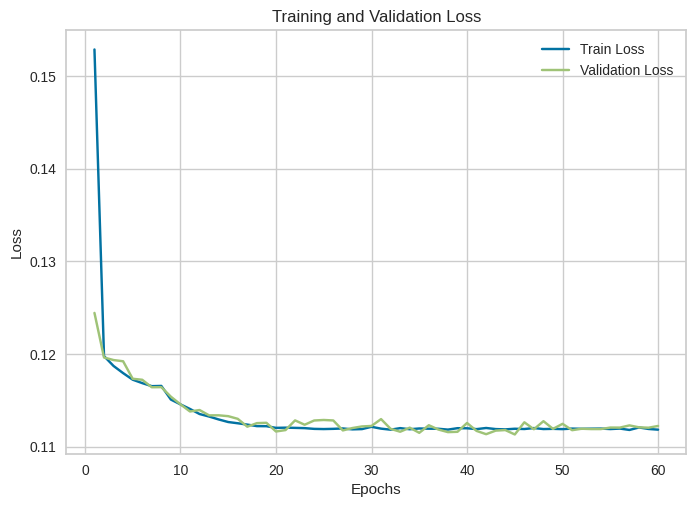

dataset_reduce_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.11122 | Validation Loss: 0.11164
Epoch 20/60 | Train Loss: 0.11017 | Validation Loss: 0.11137
Epoch 30/60 | Train Loss: 0.10992 | Validation Loss: 0.11138
Epoch 40/60 | Train Loss: 0.11004 | Validation Loss: 0.11238
Epoch 50/60 | Train Loss: 0.10997 | Validation Loss: 0.11314
Epoch 60/60 | Train Loss: 0.10990 | Validation Loss: 0.11188


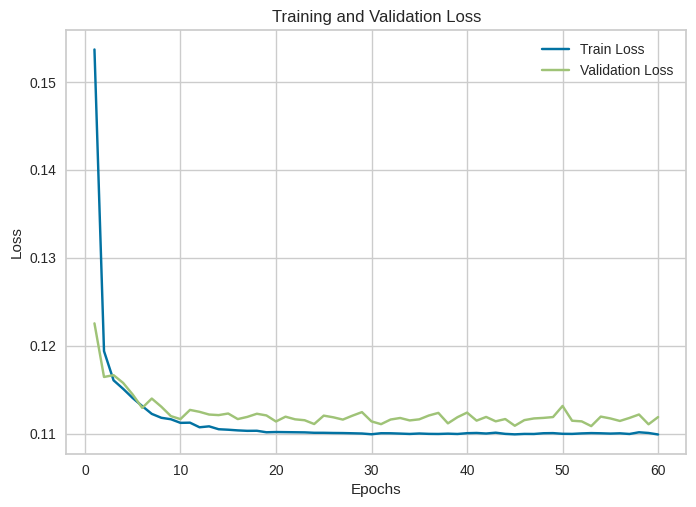

dataset_reduce_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.11198 | Validation Loss: 0.11106
Epoch 20/60 | Train Loss: 0.11110 | Validation Loss: 0.11119
Epoch 30/60 | Train Loss: 0.11095 | Validation Loss: 0.11111
Epoch 40/60 | Train Loss: 0.11080 | Validation Loss: 0.11170
Epoch 50/60 | Train Loss: 0.11092 | Validation Loss: 0.11121
Early stopping triggered after 56 epochs with no improvement.


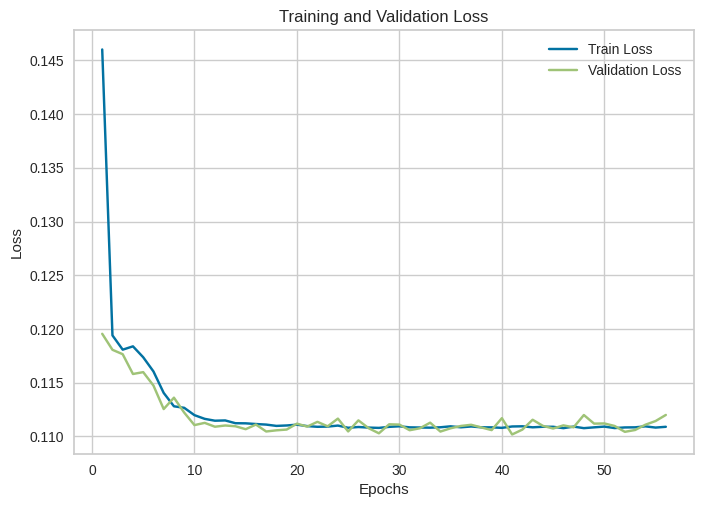

dataset_reduce_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.11224 | Validation Loss: 0.11116
Epoch 20/60 | Train Loss: 0.11134 | Validation Loss: 0.11022
Epoch 30/60 | Train Loss: 0.11130 | Validation Loss: 0.11078
Early stopping triggered after 39 epochs with no improvement.


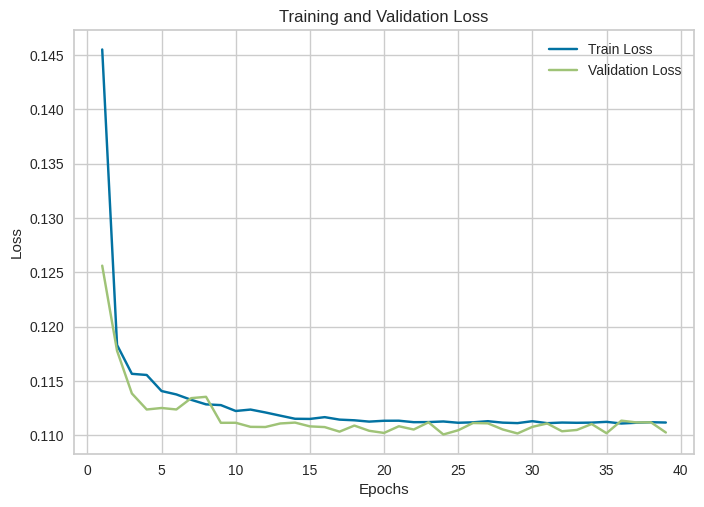

dataset_reduce_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10121 | Validation Loss: 0.10007
Epoch 20/60 | Train Loss: 0.10046 | Validation Loss: 0.10008
Epoch 30/60 | Train Loss: 0.10036 | Validation Loss: 0.10003
Epoch 40/60 | Train Loss: 0.10037 | Validation Loss: 0.10004
Early stopping triggered after 40 epochs with no improvement.


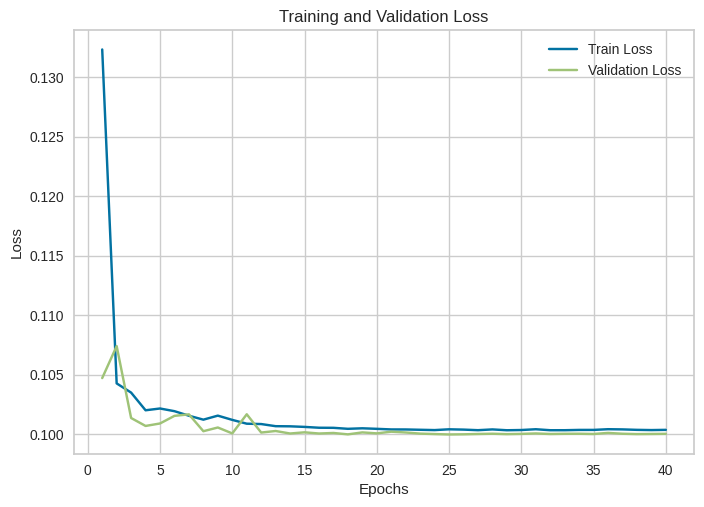

dataset_reduce_outliers_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10135 | Validation Loss: 0.09867
Epoch 20/60 | Train Loss: 0.10040 | Validation Loss: 0.09802
Epoch 30/60 | Train Loss: 0.10031 | Validation Loss: 0.09794
Epoch 40/60 | Train Loss: 0.10027 | Validation Loss: 0.09796
Epoch 50/60 | Train Loss: 0.10025 | Validation Loss: 0.09791
Early stopping triggered after 58 epochs with no improvement.


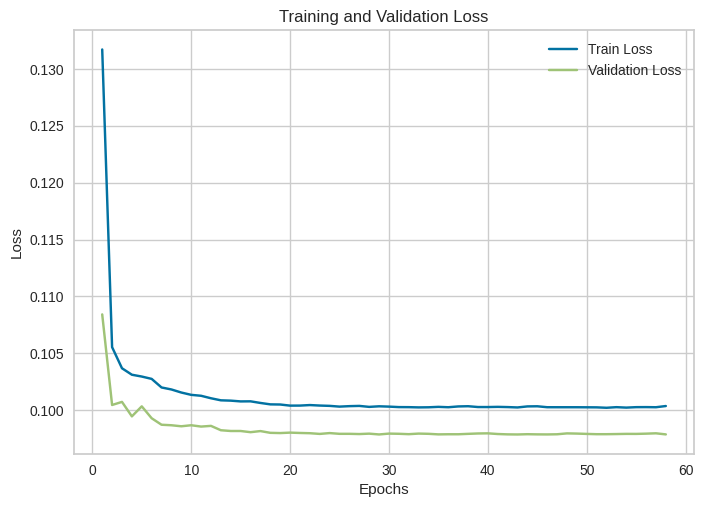

dataset_reduce_outliers_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10112 | Validation Loss: 0.10249
Epoch 20/60 | Train Loss: 0.10032 | Validation Loss: 0.10217
Epoch 30/60 | Train Loss: 0.10025 | Validation Loss: 0.10205
Epoch 40/60 | Train Loss: 0.10023 | Validation Loss: 0.10200
Early stopping triggered after 44 epochs with no improvement.


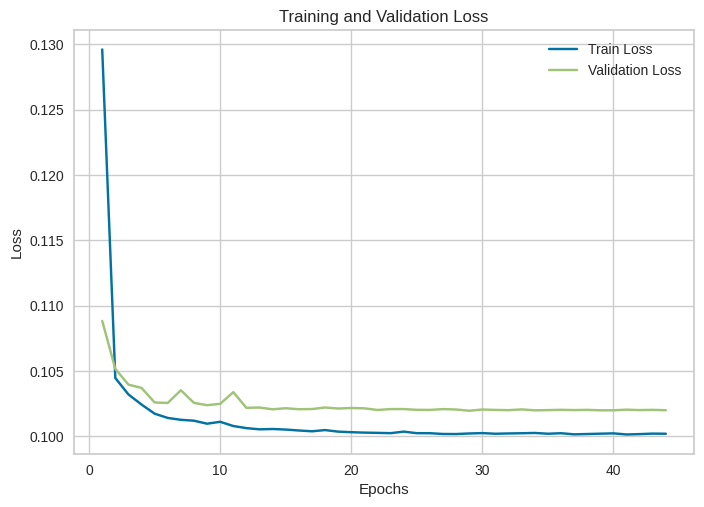

dataset_reduce_outliers_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10029 | Validation Loss: 0.10219
Epoch 20/60 | Train Loss: 0.09958 | Validation Loss: 0.10188
Epoch 30/60 | Train Loss: 0.09951 | Validation Loss: 0.10170
Epoch 40/60 | Train Loss: 0.09943 | Validation Loss: 0.10167
Epoch 50/60 | Train Loss: 0.09942 | Validation Loss: 0.10165
Early stopping triggered after 52 epochs with no improvement.


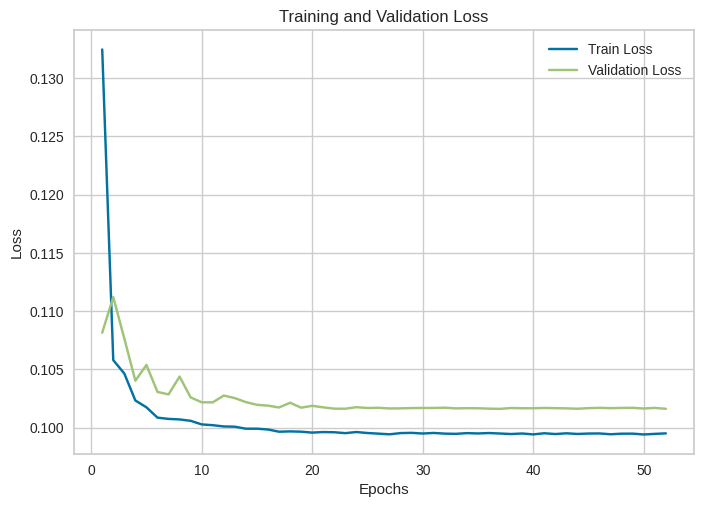

dataset_reduce_outliers_l Finish - epoch :  fold : 3
------------fold no---------0----------------------
Epoch 10/60 | Train Loss: 0.10752 | Validation Loss: 0.10916
Epoch 20/60 | Train Loss: 0.10699 | Validation Loss: 0.11005
Early stopping triggered after 24 epochs with no improvement.


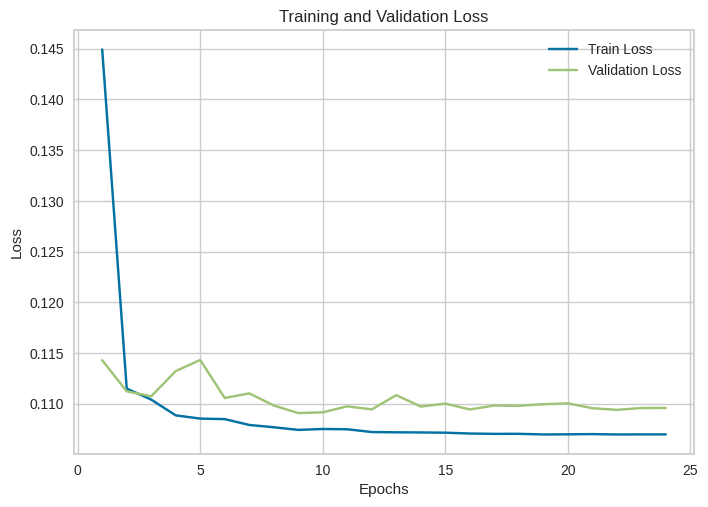

dataset_reduce_isolation_l Finish - epoch :  fold : 0
------------fold no---------1----------------------
Epoch 10/60 | Train Loss: 0.10777 | Validation Loss: 0.10985
Epoch 20/60 | Train Loss: 0.10719 | Validation Loss: 0.10906
Epoch 30/60 | Train Loss: 0.10709 | Validation Loss: 0.10865
Epoch 40/60 | Train Loss: 0.10708 | Validation Loss: 0.10927
Early stopping triggered after 45 epochs with no improvement.


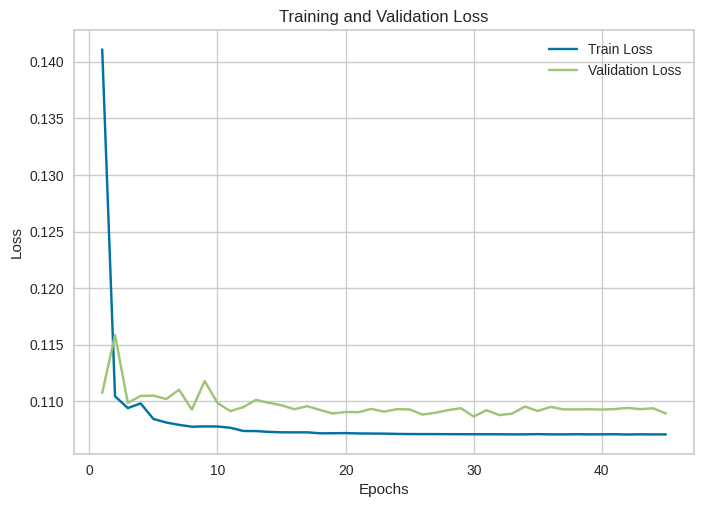

dataset_reduce_isolation_l Finish - epoch :  fold : 1
------------fold no---------2----------------------
Epoch 10/60 | Train Loss: 0.10711 | Validation Loss: 0.10692
Epoch 20/60 | Train Loss: 0.10641 | Validation Loss: 0.10542
Epoch 30/60 | Train Loss: 0.10630 | Validation Loss: 0.10547
Early stopping triggered after 36 epochs with no improvement.


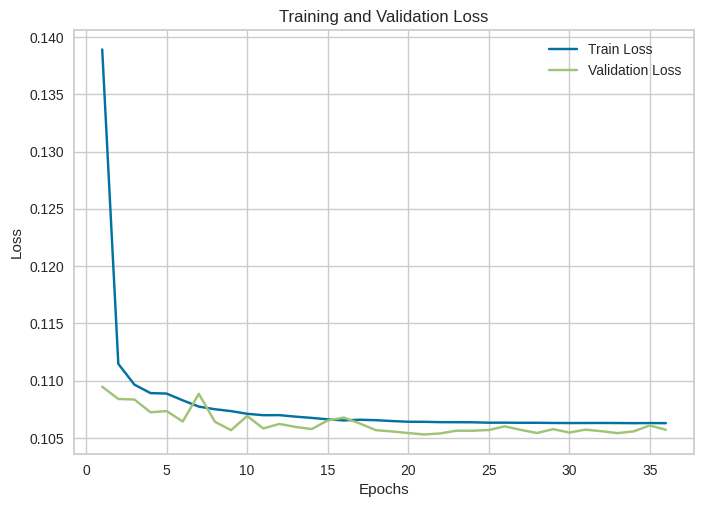

dataset_reduce_isolation_l Finish - epoch :  fold : 2
------------fold no---------3----------------------
Epoch 10/60 | Train Loss: 0.10940 | Validation Loss: 0.10656
Epoch 20/60 | Train Loss: 0.10889 | Validation Loss: 0.10610
Epoch 30/60 | Train Loss: 0.10882 | Validation Loss: 0.10619
Epoch 40/60 | Train Loss: 0.10882 | Validation Loss: 0.10587
Epoch 50/60 | Train Loss: 0.10881 | Validation Loss: 0.10567
Early stopping triggered after 57 epochs with no improvement.


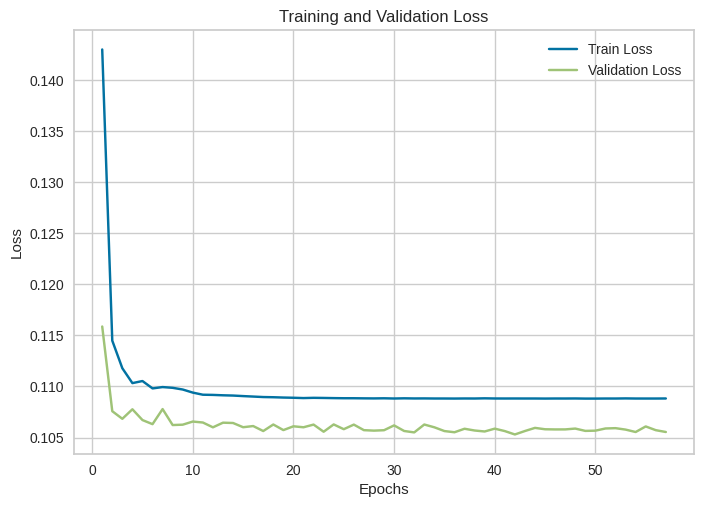

dataset_reduce_isolation_l Finish - epoch :  fold : 3


In [ ]:
model_params = [
                {"c_in": 8, "c_out": 16, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5},
                {"c_in": 16, "c_out": 32, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5}
                ,{"c_in": 32, "c_out": 64, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.4}
            ]


lr = 0.007
epochs = 60
epochs_log = 10
patience = 15
lr_decay_rate = 0.8
lr_decay_steps = 5
batch_size = 64
n_splits = 4
use_xavier_init = True

loss_metrics = trainCrossValidationModels(n_splits,datasets,datasets_names,model_params,epochs, device, lr, epochs_log,lr_decay_rate,lr_decay_steps,patience,use_xavier_init, batch_size)

In [ ]:
loss_metrics

,Dataset,loss
0,dataset,0.089447
1,dataset_wp,0.093337
2,dataset_outliers,0.079909
3,dataset_wp_outliers,0.083640
4,dataset_isolation,0.085501
5,dataset_wp_isolation,0.089729
6,dataset_log,0.091248
7,dataset_wp_log,0.094758
8,dataset_sample,0.173118
9,dataset_l,0.111380


# Guardar metricas - Save metrics

In [ ]:
cross_validation_metrics = loss_metrics

cross_validation_metrics["Dataset"] = "Cross-Validation " + loss_metrics["Dataset"]

train_metrics_d = train_metrics

train_metrics_d["Dataset"] = "train-" + train_metrics_d2["Dataset"]

In [ ]:
models_dl_metrics = pd.DataFrame(columns=['Dataset', 'loss'])

models_dl_metrics = pd.concat([models_dl_metrics, train_metrics_d], ignore_index=True)
models_dl_metrics = pd.concat([models_dl_metrics, test_metrics], ignore_index=True)
models_dl_metrics = pd.concat([models_dl_metrics, cross_validation_metrics], ignore_index=True)

models_dl_metrics.to_csv("models_dl_metrics.csv")

<ipython-input-100-3d64e88cbc5b>:3: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  models_dl_metrics = pd.concat([models_dl_metrics, train_metrics_d], ignore_index=True)


# **Conclusion - Conclusión**

In [ ]:
# Load metrics of the models

models_ml_metrics = pd.read_csv("models_ml_metrics.csv", usecols=lambda column: column != 'Unnamed: 0')
models_ml_train_metrics = pd.read_csv("models_ml_train_metrics.csv", usecols=lambda column: column != 'Unnamed: 0')

models_e_metrics = pd.read_csv("models_e_metrics.csv", usecols=lambda column: column != 'Unnamed: 0')
models_e_train_metrics = pd.read_csv("models_e_train_metrics.csv", usecols=lambda column: column != 'Unnamed: 0')

models_dl_metrics = pd.read_csv("models_dl_metrics.csv", usecols=lambda column: column != 'Unnamed: 0')

In [ ]:
# Getting the best models

print("Machine learning :")
print("")
best_ml_model = models_ml_metrics.loc[models_ml_metrics["MAE"].idxmin()]
print(best_ml_model)
print("")

print("Ensemble :")
print("")
best_e_model = models_e_metrics.loc[models_e_metrics["MAE"].idxmin()]
print(best_e_model)
print("")

print("Deep learning :")
print("")
best_dl_model = models_dl_metrics[26:52].loc[models_dl_metrics[26:52]["loss"].idxmin()]
print(best_dl_model)
print("")

print("Deep learning - Cross-validation :")
print("")
best_dl_model = models_dl_metrics[52:].loc[models_dl_metrics[52:]["loss"].idxmin()]
print(best_dl_model)
print("")

# I have identified that the best dataset for training is 'dataset_outliers'

Machine learning :

MAE                  0.079899
MSE                  0.013044
R2                   0.637961
Dataset      dataset_outliers
Algorithm                 KNN
Score                0.046472
Name: 28, dtype: object

Ensemble :

MAE                   0.05938
MSE                  0.007726
R2                   0.785546
Dataset      dataset_outliers
Algorithm             Bagging
Score                0.033553
Name: 54, dtype: object

Deep learning :

Dataset    dataset_outliers
loss               0.072695
Name: 28, dtype: object

Deep learning - Cross-validation :

Dataset    Cross-Validation Cross-Validation Cross-Valida...
loss                                                0.079909
Name: 54, dtype: object



In [ ]:
# Save the best hyperparameters
hyperparameters_better_e = pd.read_csv("hyperparameters_better_e.csv", usecols=lambda column: column != 'Unnamed: 0')
baggingHyperparameters = hyperparameters_better_e.query("Algorithm == 'Bagging'")

In [ ]:
# Training best models

df = datasets[2]

X = df.drop(["median_house_value"], axis=1)
y = df["median_house_value"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [ ]:
# KNN

knn_model = KNeighborsRegressor(n_neighbors=3)
knn_model.fit(X_train, y_train)
knn_prediction = knn_model.predict(X_test)

knn_mae = mean_absolute_error(y_test, knn_prediction)
knn_mse = mean_squared_error(y_test, knn_prediction)
knn_r2 = r2_score(y_test, knn_prediction)

knn_mae

0.0791623644785794

In [ ]:
# Bagging

bagging_model = BaggingRegressor(
    DecisionTreeRegressor(),
    n_estimators=int(baggingHyperparameters["n_estimators"].values[0]),
    max_samples=baggingHyperparameters["max_samples"].values[0],
    bootstrap=baggingHyperparameters["bootstrap"].values[0],
    random_state=42,
    oob_score=False
)
bagging_model.fit(X_train, y_train)
bagging_prediction = bagging_model.predict(X_test)

bagging_mae = mean_absolute_error(y_test, bagging_prediction)
bagging_mse = mean_squared_error(y_test, bagging_prediction)
bagging_r2 = r2_score(y_test, bagging_prediction)

bagging_mae

0.06821120255918237

In [ ]:
# Light-Bagging

light_bagging_model = BaggingRegressor(
    DecisionTreeRegressor(),
    n_estimators=50,
    max_samples=0.5,
    bootstrap=baggingHyperparameters["bootstrap"].values[0],
    random_state=42,
    oob_score=False
)
light_bagging_model.fit(X_train, y_train)
light_bagging_prediction = light_bagging_model.predict(X_test)

light_bagging_mae = mean_absolute_error(y_test, light_bagging_prediction)
light_bagging_mse = mean_squared_error(y_test, light_bagging_prediction)
light_bagging_r2 = r2_score(y_test, light_bagging_prediction)

light_bagging_mae

0.06026170609946222

In [ ]:
# Deep learning

deep_params = [
                {"c_in": 8, "c_out": 32, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5},
                {"c_in": 32, "c_out": 96, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.5}
                ,{"c_in": 96, "c_out": 256, "relu": True, "bn" : False, "ln":False, "dropout" : False, "dropout_prob" : 0.4}
            ]
# Test model
model = Model(n_outputs=1, layers=deep_params, use_xavier_init=True)
output = model(torch.randn(64, 8))
output.shape

lr = 0.005
epochs = 200
epochs_log = 10
patience = 20
lr_decay_rate = 0.95
lr_decay_steps = 5

optimizer = torch.optim.Adam(model.parameters(), lr=lr)
# MSELoss
criterion = torch.nn.L1Loss()

train_loader, test_loader = dataLoaders[2]

model,train_losses,val_losses = fit(model, train_loader, test_loader, criterion, optimizer, epochs=epochs, device=device, lr=lr, epochs_log=epochs_log, lr_decay_rate=lr_decay_rate, lr_decay_steps=lr_decay_steps, patience=patience)

Epoch 10/200 | Train Loss: 0.07303 | Validation Loss: 0.07583
Epoch 20/200 | Train Loss: 0.07094 | Validation Loss: 0.07744
Epoch 30/200 | Train Loss: 0.06672 | Validation Loss: 0.07259
Epoch 40/200 | Train Loss: 0.06457 | Validation Loss: 0.07136
Epoch 50/200 | Train Loss: 0.06278 | Validation Loss: 0.06900
Epoch 60/200 | Train Loss: 0.06150 | Validation Loss: 0.06682
Epoch 70/200 | Train Loss: 0.06088 | Validation Loss: 0.06582
Epoch 80/200 | Train Loss: 0.06038 | Validation Loss: 0.06587
Epoch 90/200 | Train Loss: 0.06006 | Validation Loss: 0.06550
Epoch 100/200 | Train Loss: 0.05984 | Validation Loss: 0.06545
Epoch 110/200 | Train Loss: 0.05985 | Validation Loss: 0.06528
Epoch 120/200 | Train Loss: 0.05968 | Validation Loss: 0.06532
Epoch 130/200 | Train Loss: 0.05968 | Validation Loss: 0.06521
Epoch 140/200 | Train Loss: 0.05967 | Validation Loss: 0.06523
Epoch 150/200 | Train Loss: 0.05972 | Validation Loss: 0.06526
Early stopping triggered after 156 epochs with no improvement.


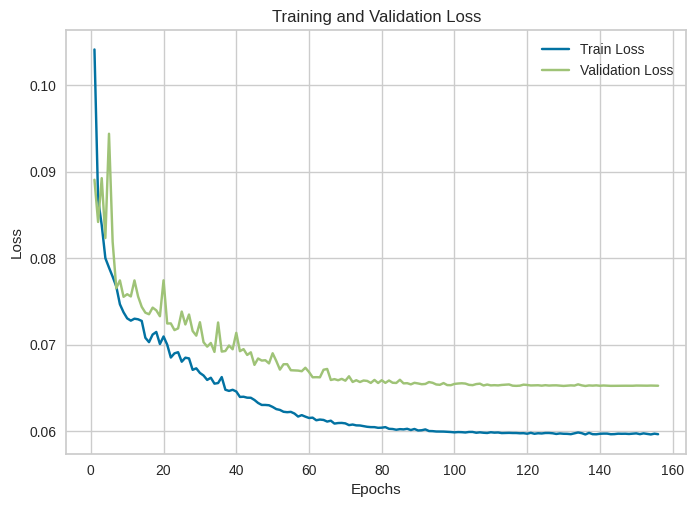

In [ ]:
graphLoss(train_losses,val_losses)

In [ ]:
# Test with generated dataset

df = datasets[21]

X_g = df.drop(["median_house_value"], axis=1)
y_g = df["median_house_value"]


In [ ]:
# KNN

knn_prediction = knn_model.predict(X_g)

knn_mae = mean_absolute_error(knn_prediction, y_g)
knn_mse = mean_squared_error(knn_prediction, y_g)
knn_r2 = r2_score(knn_prediction, y_g)

knn_mae

0.10498507685887032

In [ ]:
# Bagging

bagging_prediction = bagging_model.predict(X_g)

bagging_mae = mean_absolute_error(y_g, bagging_prediction)
bagging_mse = mean_squared_error(y_g, bagging_prediction)
bagging_r2 = r2_score(y_g, bagging_prediction)

bagging_mae

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but BaggingRegressor was fitted with feature names
  warnings.warn(


0.09764667242707126

In [ ]:
# Light Bagging

light_bagging_prediction = light_bagging_model.predict(X_g)

light_bagging_mae = mean_absolute_error(y_g, light_bagging_prediction)
light_bagging_mse = mean_squared_error(y_g, light_bagging_prediction)
light_bagging_r2 = r2_score(y_g, light_bagging_prediction)

light_bagging_mae

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but BaggingRegressor was fitted with feature names
  warnings.warn(


0.0963254101482086

In [ ]:
df = datasets[21]

X_g = df.drop(["median_house_value"], axis=1).values
y_g = df["median_house_value"].values

X_g_tensor = torch.tensor(X_g, dtype=torch.float32)
y_g_tensor = torch.tensor(y_g, dtype=torch.float32)

combined_dataset = TensorDataset(X_g_tensor, y_g_tensor)

combined_dataloader = DataLoader(combined_dataset, batch_size=64, shuffle=False)

model.eval()

all_predictions = []
all_true_values = []

with torch.no_grad():
    for X_batch, y_batch in combined_dataloader:

        predictions = model(X_batch)

        all_predictions.append(predictions.numpy())
        all_true_values.append(y_batch.numpy())


all_predictions = np.concatenate(all_predictions, axis=0)
all_true_values = np.concatenate(all_true_values, axis=0)

deep_mae = mean_absolute_error(all_true_values, all_predictions)
deep_mae

0.100701466

# **Save models - Guardar módelos**

In [ ]:
# Save Bagging model

initial_type = [('float_input', FloatTensorType([None, X_g.shape[1]]))]
onnx_model = convert_sklearn(bagging_model, initial_types=initial_type)

with open("bagging_model.onnx", "wb") as f:
    f.write(onnx_model.SerializeToString())

In [ ]:
# Save Light Bagging model

initial_type = [('float_input', FloatTensorType([None, X_g.shape[1]]))]
onnx_model = convert_sklearn(light_bagging_model, initial_types=initial_type)

with open("light_v2_bagging_model.onnx", "wb") as f:
    f.write(onnx_model.SerializeToString())

In [ ]:
# Save Pytorch model

example_input = torch.randn(1, 8)

torch.onnx.export(
    model,
    example_input,
    "deep_learning_model.onnx",
    export_params=True,
    opset_version=11,
    input_names=['input'],
    output_names=['output']
)